<a href="https://colab.research.google.com/github/ronaldanom/ia-emotions/blob/main/Copy_of_Yet_another_copy_of_Untitled0.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
# Comprimir la carpeta de espectrogramas
!zip -r spectrograms.zip /content/spectrograms

# Descargar el archivo ZIP
from google.colab import files
files.download('spectrograms.zip')

In [ ]:
import shutil

# Reemplaza 'nombre_de_la_carpeta' con el nombre de tu carpeta
#shutil.rmtree('/content/spectrograms')
shutil.rmtree('/content/output_audio')

In [ ]:
!pip install opensmile kagglehub numpy pandas librosa matplotlib opensmile kaggle

In [ ]:
!pip install shap lime

In [ ]:
import kagglehub
import numpy as np
import pandas as pd
import os
import glob
import opensmile
import librosa
import librosa.display
import matplotlib.pyplot as plt
import torch
import torch.nn as nn
import torch.optim as optim
from torchvision import transforms
from torch.utils.data import Dataset, DataLoader, random_split

# Definir las emociones e intensidad aceptada
#valid_emotions = ["ANG", "NEU"]
valid_emotions = ['ANG', 'DIS', 'FEA', 'HAP', 'NEU', 'SAD']
max_records = 1000
# 1. Parámetros para el STFT
sampling_rate = 16000
window_size = 512
hop_size = 256
n_fft = 1024
normalize = True
invalid_audio_ids = ['1088_ITH_HAP_XX.wav', '1017_IEO_SAD_HI.wav', '1040_ITH_SAD_X.wav']

# Paso 1: Descargar el dataset de Kaggle y devolver la ruta donde se almacena
path = kagglehub.dataset_download("ejlok1/cremad")
print("Path to dataset files:", path)

# Inicializa openSMILE con diferentes configuraciones
smiles = {
    "eGeMAPSv02": opensmile.Smile(feature_set=opensmile.FeatureSet.eGeMAPSv02, feature_level=opensmile.FeatureLevel.Functionals),
    "emobase": opensmile.Smile(feature_set=opensmile.FeatureSet.emobase, feature_level=opensmile.FeatureLevel.Functionals),
    "eGeMAPS": opensmile.Smile(feature_set=opensmile.FeatureSet.eGeMAPS, feature_level=opensmile.FeatureLevel.Functionals)
}

# Define los encabezados requeridos para cada conjunto de características
required_headers = {
    "eGeMAPSv02": ["F0semitoneFrom27.5Hz_sma3nz_amean", "jitterLocal_sma3nz_amean", "shimmerLocaldB_sma3nz_amean", "mfcc1_sma3_amean"],
    "emobase": ["pcm_loudness_sma_amean", "pcm_intensity_sma_amean"],
    "eGeMAPS": ["F1frequency_sma3nz_amean", "F2frequency_sma3nz_amean", "F3frequency_sma3nz_amean"]
}

# Paso 2: Buscar archivos de audio .wav en la carpeta "AudioWAV"
audio_files = glob.glob(os.path.join(path, "AudioWAV", "*.wav"))

# Crear carpeta de salida para CSV
output_folder = "."
os.makedirs('spectrograms', exist_ok=True)

# Función para extraer y guardar características en CSV
def extract_and_save_features(audio_files, smiles, required_headers, output_folder):
    # Crear un DataFrame con todas las columnas necesarias
    all_columns = sum(required_headers.values(), []) + [
        "file", "emotion", "spectrogram_path", "id", "dimensions",
        "height", "width", "sampling_rate", "window_size", "hop_size",
        "n_fft", "window_function"
    ]
    feature_data = pd.DataFrame(columns=all_columns)

    # Iterar sobre los archivos de audio y extraer características
    for file_path in audio_files[:max_records]:
        file_name = os.path.basename(file_path)

        # Omitir archivos inválidos
        if file_name in invalid_audio_ids:
            print(f"Archivo inválido omitido: {file_name}")
            continue

        # Extraer la emoción del nombre del archivo
        parts = file_name.split('_')
        if len(parts) > 2:
            emotion = parts[2]
        else:
            continue  # Saltar si no hay emoción en el nombre del archivo
        if emotion not in valid_emotions:
            print(f"Emoción no válida en {file_name}: {emotion}")
            continue  # Saltar archivos con emociones no válidas

        # Inicializar un diccionario para almacenar las características de este archivo
        feature_row = {"file": file_name}

        # Calcular y guardar el espectrograma log-Mel
        x, sr = librosa.load(file_path, sr=sampling_rate)
        stft = librosa.stft(x, n_fft=n_fft, hop_length=hop_size, win_length=window_size)
        magnitude = np.abs(stft)
        mel_filter = librosa.filters.mel(sr=sampling_rate, n_fft=n_fft, n_mels=128)
        mel_spectrogram = np.dot(mel_filter, magnitude)
        log_mel_spectrogram = librosa.power_to_db(mel_spectrogram, ref=np.max)

        # Normalización (opcional)
        if normalize:
            log_mel_spectrogram = (log_mel_spectrogram - np.mean(log_mel_spectrogram)) / np.std(log_mel_spectrogram)

        # Guardar el espectrograma como imagen PNG
        spectrogram_filename = f'{file_name[:-4]}.png'  # Nombre del archivo sin extensión .wav
        spectrogram_path = os.path.join('spectrograms', spectrogram_filename)
        plt.figure(figsize=(10, 4))
        librosa.display.specshow(log_mel_spectrogram, sr=sampling_rate, x_axis='time', y_axis='mel')
        plt.colorbar(format='%+2.0f dB')
        plt.title(f'Log-Mel Spectrogram - {emotion}')
        plt.tight_layout()
        plt.savefig(spectrogram_path)
        plt.close()

        # Agregar información adicional a `feature_row`
        feature_row.update({
            "emotion": emotion,
            "spectrogram_path": spectrogram_path,
            "id": spectrogram_filename,
            "dimensions": f"{log_mel_spectrogram.shape[0]}x{log_mel_spectrogram.shape[1]}",
            "height": log_mel_spectrogram.shape[0],
            "width": log_mel_spectrogram.shape[1],
            "sampling_rate": sampling_rate,
            "window_size": window_size,
            "hop_size": hop_size,
            "n_fft": n_fft,
            "window_function": 'Hamming'
        })

        # Extraer características para cada configuración en `smiles`
        for name, smile in smiles.items():
            features = smile.process_file(file_path)

            # Filtrar columnas según `required_headers` para la configuración actual
            if name in required_headers:
                for column in required_headers[name]:
                    # Agregar la característica al diccionario `feature_row`
                    if column in features.columns:
                        feature_row[column] = features[column].values[0]

        # Añadir `feature_row` al DataFrame
        feature_data = pd.concat([feature_data, pd.DataFrame([feature_row])], ignore_index=True)

    # Guardar todas las características combinadas en un solo archivo CSV
    csv_path = os.path.join(output_folder, "metadata.csv")
    feature_data.to_csv(csv_path, index=False)
    print(f"Características extraídas y guardadas en {csv_path}")

# Llamar a la función para extraer y guardar características
extract_and_save_features(audio_files, smiles, required_headers, output_folder)


100%|██████████| 451M/451M [00:13<00:00, 34.4MB/s]


Extracting files...
Path to dataset files: /root/.cache/kagglehub/datasets/ejlok1/cremad/versions/1


/usr/local/lib/python3.10/dist-packages/opensmile/core/smile.py:251: UserWarning: Feature set 'FeatureSet.eGeMAPS' is deprecated, consider switching to 'FeatureSet.eGeMAPSv02'.
  warnings.warn(
<ipython-input-2-c689fe1c8896>:135: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  feature_data = pd.concat([feature_data, pd.DataFrame([feature_row])], ignore_index=True)


Características extraídas y guardadas en ./metadata.csv


In [ ]:
import os
import pandas as pd
import torch
import torch.nn as nn
import torch.optim as optim
from torchvision import transforms
from torch.utils.data import Dataset, DataLoader, random_split
from PIL import Image
from sklearn.metrics import accuracy_score

valid_emotions = ['ANG', 'DIS', 'FEA', 'HAP', 'NEU', 'SAD']

# 0. Definir el ConvolutionalStem
class ConvolutionalStem(nn.Module):
    def __init__(self):
        super(ConvolutionalStem, self).__init__()
        self.conv1 = nn.Conv2d(1, 16, kernel_size=3, stride=1, padding=1)
        self.relu = nn.ReLU()
        self.pool = nn.MaxPool2d(kernel_size=2, stride=2)

    def forward(self, x):
        x = self.conv1(x)
        x = self.relu(x)
        x = self.pool(x)
        return x

# 1. Definir el dataset
class SpectrogramDataset(Dataset):
    def __init__(self, metadata_file, spectrogram_dir, transform=None):
        self.metadata = pd.read_csv(metadata_file)
        self.spectrogram_dir = spectrogram_dir  # Store the directory of spectrograms
        self.transform = transform

    def __len__(self):
        return len(self.metadata)

    def __getitem__(self, idx):
        img_path = os.path.join(self.spectrogram_dir, self.metadata.iloc[idx]['id'])  # Join with spectrogram dir
        emotion = self.metadata.iloc[idx]['emotion']

        # Cargar la imagen
        image = Image.open(img_path).convert('L')  # Convertir a escala de grises
        if self.transform:
            image = self.transform(image)

        # Convertir la etiqueta a un índice
        label = valid_emotions.index(emotion)
        return image, label

# 2. Definir el modelo (Vision Transformer)
class VisionTransformer(nn.Module):
    def __init__(self, num_classes=len(valid_emotions)):
        super(VisionTransformer, self).__init__()
        self.convolutional_stem = ConvolutionalStem()  # Define tu ConvolutionalStem aquí

        # Determinar el tamaño de entrada dinámicamente
        dummy_input = torch.randn(1, 1, 128, 313)  # Cambia según las dimensiones de tus espectrogramas
        dummy_output = self.convolutional_stem(dummy_input)
        self.fc_input_size = dummy_output.view(dummy_output.size(0), -1).shape[1]

        self.fc = nn.Linear(self.fc_input_size, num_classes)

    def forward(self, x):
        x = self.convolutional_stem(x)
        x = x.view(x.size(0), -1)  # Flatten
        x = self.fc(x)
        return x

# 3. Definir la función de entrenamiento
def train_model(model, dataloader, criterion, optimizer, num_epochs=10):
    model.train()
    for epoch in range(num_epochs):
        for images, labels in dataloader:
            optimizer.zero_grad()
            outputs = model(images)
            loss = criterion(outputs, labels)
            loss.backward()
            optimizer.step()

        print(f'Epoch [{epoch + 1}/{num_epochs}], Loss: {loss.item():.4f}')

# 4. Configurar transformaciones y datos
transform = transforms.Compose([
    transforms.Resize((128, 313)),  # Ajusta al tamaño que necesita tu modelo
    transforms.ToTensor(),            # Convierte a tensor
])

# 5. Crear el dataset
dataset = SpectrogramDataset(metadata_file='metadata.csv',
                             spectrogram_dir='spectrograms',  # Pass the spectrogram directory
                             transform=transform)

# 6. Dividir el dataset en entrenamiento y validación
train_size = int(0.8 * len(dataset))  # 80% para entrenamiento
val_size = len(dataset) - train_size   # 20% para validación
train_dataset, val_dataset = random_split(dataset, [train_size, val_size])

# 7. Crear DataLoaders para entrenamiento y validación
train_dataloader = DataLoader(train_dataset, batch_size=16, shuffle=True)
val_dataloader = DataLoader(val_dataset, batch_size=16, shuffle=False)

# 8. Inicializar el modelo, criterio y optimizador
model = VisionTransformer(num_classes=len(valid_emotions))
criterion = nn.CrossEntropyLoss()
optimizer = optim.Adam(model.parameters(), lr=0.001)

# 9. Entrenar el modelo
train_model(model, train_dataloader, criterion, optimizer, num_epochs=10)

# 10. Evaluar el modelo
def evaluate_model(model, dataloader):
    model.eval()
    all_labels = []
    all_preds = []
    with torch.no_grad():
        for images, labels in dataloader:
            outputs = model(images)
            _, predicted = torch.max(outputs.data, 1)
            all_labels.extend(labels.numpy())
            all_preds.extend(predicted.numpy())

    accuracy = accuracy_score(all_labels, all_preds)
    print(f'Accuracy: {accuracy * 100:.2f}%')

# 11. Evaluar el modelo en el conjunto de validación
evaluate_model(model, val_dataloader)
print("Entrenamiento y evaluación completados.")
torch.save(model.state_dict(), 'modelo_emociones.pth')
print("Modelo guardado como 'modelo_emociones.pth'")

Epoch [1/10], Loss: 2.6646
Epoch [2/10], Loss: 1.9516
Epoch [3/10], Loss: 1.1771
Epoch [4/10], Loss: 0.8725
Epoch [5/10], Loss: 0.7527
Epoch [6/10], Loss: 0.6411
Epoch [7/10], Loss: 0.3869
Epoch [8/10], Loss: 0.2626
Epoch [9/10], Loss: 0.1632
Epoch [10/10], Loss: 0.1217
Accuracy: 89.00%
Entrenamiento y evaluación completados.
Modelo guardado como 'modelo_emociones.pth'


In [ ]:
import os
import librosa
import librosa.display
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
from PIL import Image
import torch
from torchvision import transforms
from collections import Counter
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score
from sklearn.metrics import classification_report, confusion_matrix
from sklearn.feature_selection import RFECV
from sklearn.cluster import KMeans
from collections import Counter
import warnings
warnings.filterwarnings("ignore", category=UserWarning, message="Feature set 'FeatureSet.eGeMAPS' is deprecated")


valid_emotions = ['ANG', 'DIS', 'FEA', 'HAP', 'NEU', 'SAD']
required_headers = {
    "eGeMAPSv02": ["F0semitoneFrom27.5Hz_sma3nz_amean", "jitterLocal_sma3nz_amean", "shimmerLocaldB_sma3nz_amean", "mfcc1_sma3_amean"],
    "emobase": ["pcm_loudness_sma_amean", "pcm_intensity_sma_amean"],
    "eGeMAPS": ["F1frequency_sma3nz_amean", "F2frequency_sma3nz_amean", "F3frequency_sma3nz_amean"]
}
# Initialize the model *instance*
model = VisionTransformer(num_classes=len(valid_emotions))

# Load the saved state dictionary into the model instance
model.load_state_dict(torch.load('modelo_emociones.pth'))

# Now you can call eval() on the model instance
model.eval()

# Función para generar el log-mel espectrograma
def generate_log_mel_spectrogram(audio_array, sampling_rate=16000, n_fft=1024, hop_size=256, window_size=512, normalize=True):
    # Calcular el espectrograma log-Mel
    stft = librosa.stft(audio_array, n_fft=n_fft, hop_length=hop_size, win_length=window_size)
    magnitude = np.abs(stft)
    mel_filter = librosa.filters.mel(sr=sampling_rate, n_fft=n_fft, n_mels=128)
    mel_spectrogram = np.dot(mel_filter, magnitude)
    log_mel_spectrogram = librosa.power_to_db(mel_spectrogram, ref=np.max)

    # Normalización (opcional)
    if normalize:
        log_mel_spectrogram = (log_mel_spectrogram - np.mean(log_mel_spectrogram)) / np.std(log_mel_spectrogram)

    return log_mel_spectrogram
def generate_open_smile_selected_characteristics(audio_segment, sampling_rate=16000):
    # Definir las configuraciones de OpenSMILE para las características
    smiles = {
        "eGeMAPSv02": opensmile.Smile(feature_set=opensmile.FeatureSet.eGeMAPSv02, feature_level=opensmile.FeatureLevel.Functionals),
        "emobase": opensmile.Smile(feature_set=opensmile.FeatureSet.emobase, feature_level=opensmile.FeatureLevel.Functionals),
        "eGeMAPS": opensmile.Smile(feature_set=opensmile.FeatureSet.eGeMAPS, feature_level=opensmile.FeatureLevel.Functionals)
    }

    # Definir los encabezados requeridos para cada conjunto de características
    required_headers = {
        "eGeMAPSv02": ["F0semitoneFrom27.5Hz_sma3nz_amean", "jitterLocal_sma3nz_amean", "shimmerLocaldB_sma3nz_amean", "mfcc1_sma3_amean"],
        "emobase": ["pcm_loudness_sma_amean", "pcm_intensity_sma_amean"],
        "eGeMAPS": ["F1frequency_sma3nz_amean", "F2frequency_sma3nz_amean", "F3frequency_sma3nz_amean"]
    }

    # Inicializar el diccionario para almacenar las características extraídas
    feature_row = {}

    # Convertir el segmento de audio en una estructura que OpenSMILE pueda procesar
    audio_array = audio_segment.astype('float32')  # Asegúrate de que esté en float32
    for name, smile in smiles.items():
        # Procesar el audio directamente en OpenSMILE
        features = smile.process_signal(audio_array, sampling_rate=sampling_rate)

        # Filtrar columnas según `required_headers` para la configuración actual
        if name in required_headers:
            for column in required_headers[name]:
                # Agregar la característica al diccionario `feature_row`
                if column in features.columns:
                    feature_row[column] = features[column].values[0]

    # Retornar las características extraídas como un diccionario
    return feature_row
# Función para predecir la emoción a partir del espectrograma
def predict_emotion_from_spectrogram(log_mel_spectrogram, model, valid_emotions):
    # Convertir el espectrograma a imagen y luego a tensor
    plt.figure(figsize=(10, 4))
    librosa.display.specshow(log_mel_spectrogram, sr=16000, x_axis='time', y_axis='mel')
    plt.colorbar(format='%+2.0f dB')
    plt.axis('off')

    # Guardar la imagen temporalmente en memoria
    plt.savefig('temp_spectrogram.png', bbox_inches='tight', pad_inches=0)
    plt.close()

    # Cargar la imagen y convertirla a escala de grises
    img = Image.open('temp_spectrogram.png').convert('L')

    # Aplicar las transformaciones necesarias (Redimensionar, Normalizar, Convertir a Tensor)
    transform = transforms.Compose([
        transforms.Resize((128, 313)),  # Ajusta el tamaño de la imagen al usado en el entrenamiento
        transforms.ToTensor(),          # Convierte la imagen a Tensor
    ])
    img_tensor = transform(img).unsqueeze(0)  # Añadir batch dimension (1, C, H, W)

    # Realizar la predicción
    with torch.no_grad():
        outputs = model(img_tensor)
        _, preds = torch.max(outputs, 1)

    # Obtener la emoción predecida
    predicted_emotion = valid_emotions[preds.item()]
    return predicted_emotion

# Función principal que procesa el audio y predice las emociones
def process_audio_and_predict(file_path, model, valid_emotions):
    # Generar el espectrograma log-Mel
    log_mel_spectrogram = generate_log_mel_spectrogram(file_path)

    # Guardar el espectrograma como imagen
    spectrogram_filename = f'{file_path[:-4]}_spectrogram.png'  # Nombre del archivo sin extensión .wav
    spectrogram_path = os.path.join('.', spectrogram_filename)
    plt.figure(figsize=(10, 4))
    librosa.display.specshow(log_mel_spectrogram, sr=16000, x_axis='time', y_axis='mel')
    plt.colorbar(format='%+2.0f dB')
    plt.title(f'Log-Mel Spectrogram')
    plt.tight_layout()
    plt.savefig(spectrogram_path)
    plt.close()

    # Predecir la emoción a partir del espectrograma generado
    predicted_emotion = load_and_predict_image(spectrogram_path, model, valid_emotions)
    return predicted_emotion

def train_kmeans(prosodic_features, emotion, n_clusters=6):
    # Convertir prosodic_features a DataFrame
    prosodic_features_df = pd.DataFrame(prosodic_features)

    # Convertir emotion a una Serie, extrayendo solo las etiquetas de emoción
    emotion_series = pd.Series([e[1] for e in emotion])

    # Eliminar filas con valores nulos en emotion o prosodic_features
    valid_indices = ~emotion_series.isna() & ~prosodic_features_df.isna().any(axis=1)
    X = prosodic_features_df[valid_indices]
    y = emotion_series[valid_indices]

    # Inicializar el modelo KMeans con un número de clústeres
    kmeans = KMeans(n_clusters=n_clusters, random_state=42)
    kmeans.fit(X)

    # Asignar las predicciones (clústeres) a las características
    cluster_predictions = kmeans.predict(X)

    # Asignar emociones a cada clúster basándose en la emoción más frecuente dentro de cada clúster
    cluster_to_emotion = {}
    for cluster in np.unique(cluster_predictions):
        cluster_emotions = y[cluster_predictions == cluster]
        most_common_emotion = Counter(cluster_emotions).most_common(1)[0][0]
        cluster_to_emotion[cluster] = most_common_emotion

    # Evaluar la precisión al comparar las emociones predichas con las reales
    predicted_emotions = [cluster_to_emotion[cluster] for cluster in cluster_predictions]
    accuracy = np.mean(predicted_emotions == y)

    print(f"Accuracy of KMeans Clustering: {accuracy:.2f}")

    # Mostrar los clústeres y las emociones más comunes
    for cluster, emotion in cluster_to_emotion.items():
        print(f"Cluster {cluster}: Predicted Emotion = {emotion}")

    return cluster_to_emotion, accuracy



# Función de entrenamiento con RandomForestClassifier y RFECV
def train_randomforest(prosodic_features, emotion):
    # Convertir prosodic_features a DataFrame
    prosodic_features_df = pd.DataFrame(prosodic_features)

    # Convertir emotion a una Serie, extrayendo solo las etiquetas de emoción
    emotion_series = pd.Series([e[1] for e in emotion])

    # Eliminar filas con valores nulos en emotion o prosodic_features
    valid_indices = ~emotion_series.isna() & ~prosodic_features_df.isna().any(axis=1)
    X = prosodic_features_df[valid_indices]
    y = emotion_series[valid_indices]

    # Dividir los datos en conjunto de entrenamiento y prueba
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

    # Inicializar el modelo
    model = RandomForestClassifier(random_state=42)

    # Aplicar RFECV para selección de características
    rfecv = RFECV(estimator=model, step=1, cv=5)
    rfecv.fit(X_train, y_train)

    # Obtener las características seleccionadas
    selected_features = X.columns[rfecv.support_]

    # Predicciones y evaluación del modelo
    y_pred = rfecv.predict(X_test)

    # Matriz de confusión y reporte de clasificación
    conf_matrix = confusion_matrix(y_test, y_pred)
    class_report = classification_report(y_test, y_pred, output_dict=True)

    print("Confusion Matrix:")
    print(conf_matrix)
    print("\nClassification Report:")
    print(classification_report(y_test, y_pred))

    # Graficar matriz de confusión
    plt.figure(figsize=(8, 6))
    sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues',
                xticklabels=class_report.keys(), yticklabels=class_report.keys())
    plt.ylabel('True label')
    plt.xlabel('Predicted label')
    plt.title('Confusion Matrix')
    plt.show()

    # Graficar métricas por clase
    metrics = ['precision', 'recall', 'f1-score']
    scores = {metric: [] for metric in metrics}

    for label in class_report.keys():
        if label not in ['accuracy', 'macro avg', 'weighted avg']:
            for metric in metrics:
                scores[metric].append(class_report[label][metric])

    df_scores = pd.DataFrame(scores, index=list(class_report.keys())[:-3])
    df_scores.plot(kind='bar', figsize=(10, 6))
    plt.title('Performance Metrics by Class')
    plt.ylabel('Score')
    plt.xticks(rotation=0)
    plt.ylim(0, 1)
    plt.show()

    return selected_features, rfecv.n_features_
def calculate_averages_by_emotion(caracteristicas, emociones):
    # Convertir los datos de características en un DataFrame
    df_caracteristicas = pd.DataFrame(caracteristicas)

    # Crear un DataFrame de las emociones
    df_emociones = pd.DataFrame(emociones, columns=['timestamp', 'emocion'])

    # Asegurarse de que ambas listas tengan el mismo tamaño
    assert len(df_caracteristicas) == len(df_emociones), "Las listas de características y emociones no tienen la misma longitud."

    # Añadir la columna de emociones al DataFrame de características
    df_caracteristicas['emocion'] = df_emociones['emocion']

    # Calcular los promedios de cada característica por emoción
    promedios_por_emocion = df_caracteristicas.groupby('emocion').mean()

    return promedios_por_emocion
# Función para procesar el audio en segmentos de 5 segundos y predecir emociones
def process_audio_in_segments_and_predict(file_path, model, valid_emotions, segment_duration=5, max_duration=None):
    sampling_rate = 16000
    y, sr = librosa.load(file_path, sr=sampling_rate)
    segment_length = segment_duration * sr
    num_segments = len(y) // segment_length
    emotions = []
    prosodic_features = []
    if max_duration:
        max_segments = max_duration // segment_duration
        num_segments = min(num_segments, max_segments)

    for i in range(num_segments):
        start = i * segment_length
        end = start + segment_length
        audio_segment = y[start:end]

        log_mel_spectrogram = generate_log_mel_spectrogram(audio_segment, sampling_rate=sampling_rate)
        emotion = predict_emotion_from_spectrogram(log_mel_spectrogram, model, valid_emotions)
        prosody=generate_open_smile_selected_characteristics(audio_segment)

        start_time_sec = i * segment_duration
        start_time_min = f"{start_time_sec // 60}:{start_time_sec % 60:02d}"
        #print(f"Tiempo {start_time_min}: Emoción predicha - {emotion}")
        emotions.append((start_time_min, emotion))
        prosodic_features.append(prosody)
        #emotions1.append(emotions)
    print(calculate_averages_by_emotion(prosodic_features, emotions))
    # Entrenar el modelo RandomForest con las características de prosodia y emociones
    #print(train_randomforest(prosodic_features, emotions))
    #print(calculate_averages_by_emotion(prosodic_features, emotions))
    #print(prosodic_features, emotions)

    # Predicción de prueba en el primer segmento
    #test_prosodic_features = list(prosodic_features[0].values())
    #predicted_emotion_rf = rf_classifier.predict([test_prosodic_features])[0]
    #print(f"Predicción de RandomForest para el primer segmento: {predicted_emotion_rf}")

    return emotions
# Función para analizar el promedio de emociones y comparar resultados
def analyze_emotion_results(emotions_by_segment):
    emotions_only = [emotion for _, emotion in emotions_by_segment]
    emotion_count = Counter(emotions_only)
    total_emotions = len(emotions_only)

    # Calcular el porcentaje de cada emoción
    emotion_percentage = {emotion: (count / total_emotions) * 100 for emotion, count in emotion_count.items()}

    # Obtener la emoción más común
    most_common_emotion = emotion_count.most_common(1)[0][0]

    return most_common_emotion, emotion_count, emotion_percentage

# Función para comparar resultados de diferentes intervalos de tiempo
def compare_intervals(file_path, model, valid_emotions, intervals=[1, 2, 3, 4, 5], max_duration=60):
    results = {}
    for interval in intervals:
        # Procesar el audio en segmentos de acuerdo al intervalo
        emotions = process_audio_in_segments_and_predict(
            file_path, model, valid_emotions, segment_duration=interval, max_duration=max_duration
        )

        # Analizar resultados y obtener el conteo y porcentaje de emociones
        most_common_emotion, emotion_count, emotion_percentage = analyze_emotion_results(emotions)

        # Guardar los resultados en el diccionario
        results[interval] = {
            'emotions': emotions,
            'most_common_emotion': most_common_emotion,
            'emotion_count': emotion_count,
            'emotion_percentage': emotion_percentage
        }

    return results

# Ejemplo de uso
file_path = '/content/output_audio/concatenated_audio.wav'  # Ruta del archivo de audio
#model = torch.load('modelo_emociones.pth')  # Cargar tu modelo previamente entrenado
#valid_emotions = ['ANG', 'DIS', 'FEA', 'HAP', 'NEU', 'SAD']

# Comparar emociones para intervalos de tiempo de 1 a 5 segundos con un límite de 60 segundos
results = compare_intervals(file_path, model, valid_emotions, intervals=[5, 4, 3, 2, 1], max_duration=120)

# Mostrar los resultados
for interval, data in results.items():
    print(f"\nIntervalo de {interval} segundos:")
    print(f"  Emoción más común: {data['most_common_emotion']}")
    print(f"  Conteo de emociones: {data['emotion_count']}")
    print(f"  Porcentaje de emociones: {data['emotion_percentage']}")
    print(f"  Emociones predichas por tiempo: {data['emotions']}")
#print("Cada 1 s",process_audio_in_segments_and_predict(file_path, model, valid_emotions,1,120))




<ipython-input-63-2500a366e628>:33: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load('modelo_emociones.pth'))


         F0semitoneFrom27.5Hz_sma3nz_amean  jitterLocal_sma3nz_amean  \
emocion                                                                
DIS                              33.664036                  0.022191   
FEA                              29.088150                  0.018526   
HAP                              29.055716                  0.021439   
SAD                              31.508341                  0.029457   

         shimmerLocaldB_sma3nz_amean  mfcc1_sma3_amean  \
emocion                                                  
DIS                         1.283988         21.527004   
FEA                         1.338379         22.387094   
HAP                         1.497942         22.006308   
SAD                         1.518220         24.698969   

         pcm_loudness_sma_amean  pcm_intensity_sma_amean  \
emocion                                                    
DIS                    0.616246             2.874236e-06   
FEA                    0.503774       

Silhouette Score: 0.20


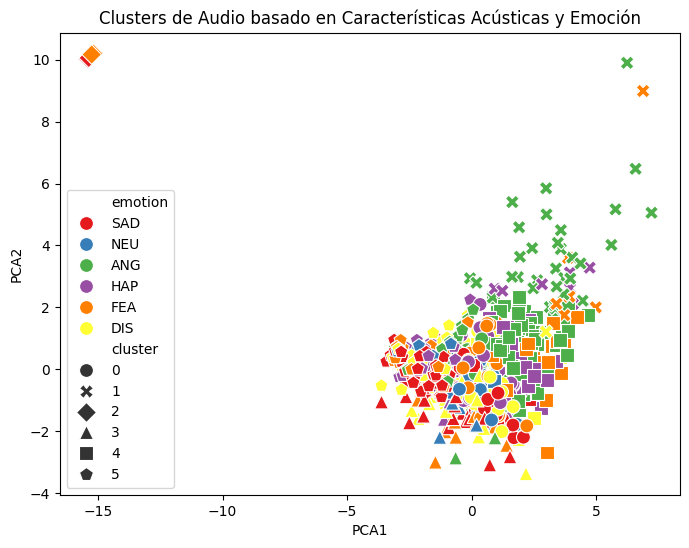

In [ ]:
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import silhouette_score
import seaborn as sns
from sklearn.decomposition import PCA

# Paso 1: Leer el archivo CSV con las características
metadata_path = 'metadata.csv'
df = pd.read_csv(metadata_path)

# Paso 2: Filtrar solo las características numéricas
numeric_columns = df.columns.difference(['file', 'emotion', 'spectrogram_path', 'id', 'dimensions', 'height', 'width', 'sampling_rate', 'window_size', 'hop_size', 'n_fft', 'window_function'])
X = df[numeric_columns].values

# Normalizar las características
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# Paso 3: Aplicar K-Means para clustering
n_clusters = 6  # Puedes ajustar esto según el número de emociones posibles
kmeans = KMeans(n_clusters=n_clusters, random_state=42)
df['cluster'] = kmeans.fit_predict(X_scaled)

# Paso 4: Evaluar el clustering con silhouette score
sil_score = silhouette_score(X_scaled, df['cluster'])
print(f'Silhouette Score: {sil_score:.2f}')

# Paso 5: Visualizar los clusters utilizando PCA para reducir la dimensionalidad
pca = PCA(n_components=2)
pca_components = pca.fit_transform(X_scaled)

# Crear un DataFrame con las componentes PCA y los clusters
df_pca = pd.DataFrame(pca_components, columns=['PCA1', 'PCA2'])
df_pca['cluster'] = df['cluster']
df_pca['emotion'] = df['emotion']

# Visualización con seaborn
plt.figure(figsize=(8, 6))
sns.scatterplot(data=df_pca, x='PCA1', y='PCA2', hue='emotion', palette='Set1', style='cluster', s=100, markers=['o', 'X', 'D', '^', 's', 'p'])
plt.title('Clusters de Audio basado en Características Acústicas y Emoción')
plt.show()


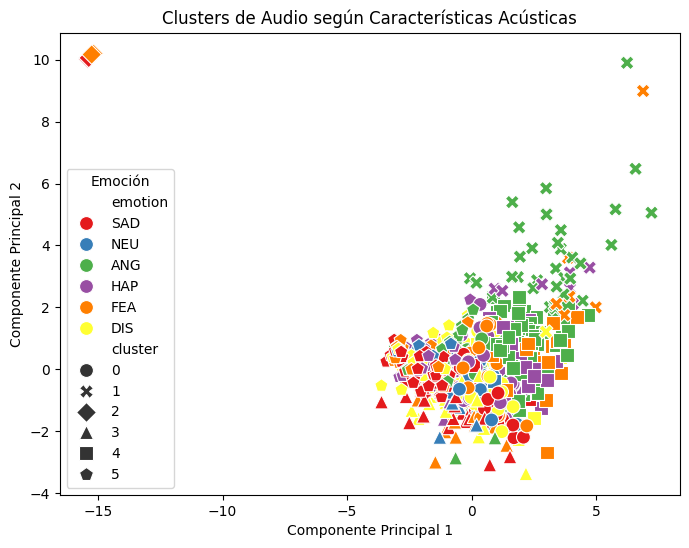

Centros de los clusters:
[[ 4.07355203e-01  4.29362877e-01  4.57827461e-01  3.85848978e-01
  -1.67768258e-01  2.77530142e-01 -2.64342285e-01 -2.60607049e-01
  -2.82807080e-01]
 [ 1.12702865e+00  1.00478300e+00  4.31106493e-01  3.02908753e-01
   8.14558998e-02 -1.04029677e+00  3.66471026e+00  3.01904656e+00
  -3.95590169e-01]
 [-4.88793009e+00 -5.66224415e+00 -1.01279591e+01 -1.34108516e+01
  -1.89022203e+00 -2.19241716e-01 -3.84208714e-01 -9.22340192e-01
  -5.35811281e+00]
 [-4.46060997e-01 -2.61119974e-01 -9.94654225e-02 -1.07887820e-01
   1.46022573e+00 -3.10330995e-01 -2.95338561e-01 -4.64793751e-01
   1.31038579e+00]
 [ 1.05170529e+00  1.04804083e+00  6.26300433e-01  3.38488883e-01
  -2.04315650e-02 -1.23601151e+00  3.84985658e-01  8.81907865e-01
  -8.95593334e-02]
 [-8.05880420e-01 -8.66024897e-01 -6.44000208e-01 -3.88887263e-01
  -3.15198255e-01  4.82759466e-01 -2.77542503e-01 -3.36799864e-01
  -8.07812496e-03]]


In [ ]:
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
import seaborn as sns
import matplotlib.pyplot as plt

# Paso 1: Leer el archivo CSV con las características
metadata_path = 'metadata.csv'
df = pd.read_csv(metadata_path)

# Paso 2: Filtrar solo las características numéricas
numeric_columns = df.columns.difference(['file', 'emotion', 'spectrogram_path', 'id', 'dimensions', 'height', 'width', 'sampling_rate', 'window_size', 'hop_size', 'n_fft', 'window_function'])
X = df[numeric_columns].values

# Paso 3: Normalización de las características
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# Paso 4: Aplicar K-Means para clustering
n_clusters = 6  # Ajuste basado en las emociones
kmeans = KMeans(n_clusters=n_clusters, random_state=42)
df['cluster'] = kmeans.fit_predict(X_scaled)

# Paso 5: Evaluación del clustering con PCA para reducción dimensional
pca = PCA(n_components=2)
pca_components = pca.fit_transform(X_scaled)

# Paso 6: Crear un DataFrame con las componentes PCA y los clusters
df_pca = pd.DataFrame(pca_components, columns=['PCA1', 'PCA2'])
df_pca['cluster'] = df['cluster']
df_pca['emotion'] = df['emotion']

# Visualización de los clusters
plt.figure(figsize=(8, 6))
sns.scatterplot(data=df_pca, x='PCA1', y='PCA2', hue='emotion', palette='Set1', style='cluster', s=100, markers=['o', 'X', 'D', '^', 's', 'p'])
plt.title('Clusters de Audio según Características Acústicas')
plt.xlabel('Componente Principal 1')
plt.ylabel('Componente Principal 2')
plt.legend(title='Emoción')
plt.show()

# Imprimir los centros de los clusters para interpretar las emociones más representativas
centroids = kmeans.cluster_centers_
print("Centros de los clusters:")
print(centroids)


In [ ]:
!pip install pydub
import kagglehub
import os
import glob
import shutil
from pydub import AudioSegment

# Paso 1: Descargar el dataset de Kaggle y devolver la ruta donde se almacena
path = kagglehub.dataset_download("ejlok1/cremad")
print("Path to dataset files:", path)

# Paso 2: Buscar archivos de audio .wav en la carpeta "AudioWAV"
audio_folder = os.path.join(path, "AudioWAV")
audio_files = glob.glob(os.path.join(audio_folder, "*.wav"))

# Asegúrate de que haya archivos de audio disponibles
if not audio_files:
    print("No se encontraron archivos de audio en el dataset.")
else:
    # Función para concatenar los archivos de audio
    def concatenate_audio_files(audio_files, output_path, max_files=None):
        combined = AudioSegment.empty()  # Crear un objeto vacío de AudioSegment

        # Limitar la cantidad de archivos si max_files está especificado
        files_to_process = audio_files[:max_files] if max_files else audio_files

        for audio_file in files_to_process:
            print(f"Concatenando: {audio_file}")
            audio = AudioSegment.from_wav(audio_file)  # Cargar el archivo de audio
            combined += audio  # Concatenar al archivo combinado

        # Guardar el archivo de audio concatenado
        combined.export(output_path, format="wav")
        print(f"Archivo de audio concatenado guardado en: {output_path}")

    # Crear una carpeta de salida para guardar el archivo concatenado
    output_folder = "output_audio"
    os.makedirs(output_folder, exist_ok=True)
    output_file_path = os.path.join(output_folder, "concatenated_audio.wav")

    # Llamar a la función de concatenación (Puedes ajustar el número máximo de archivos si lo deseas)
    concatenate_audio_files(audio_files, output_file_path, max_files=1000)  # Concatenar los primeros 10 archivos


Path to dataset files: /root/.cache/kagglehub/datasets/ejlok1/cremad/versions/1
Concatenando: /root/.cache/kagglehub/datasets/ejlok1/cremad/versions/1/AudioWAV/1034_MTI_SAD_XX.wav
Concatenando: /root/.cache/kagglehub/datasets/ejlok1/cremad/versions/1/AudioWAV/1038_IEO_NEU_XX.wav
Concatenando: /root/.cache/kagglehub/datasets/ejlok1/cremad/versions/1/AudioWAV/1064_TIE_ANG_XX.wav
Concatenando: /root/.cache/kagglehub/datasets/ejlok1/cremad/versions/1/AudioWAV/1072_WSI_HAP_XX.wav
Concatenando: /root/.cache/kagglehub/datasets/ejlok1/cremad/versions/1/AudioWAV/1066_IWW_HAP_XX.wav
Concatenando: /root/.cache/kagglehub/datasets/ejlok1/cremad/versions/1/AudioWAV/1074_TSI_FEA_XX.wav
Concatenando: /root/.cache/kagglehub/datasets/ejlok1/cremad/versions/1/AudioWAV/1031_IEO_ANG_MD.wav
Concatenando: /root/.cache/kagglehub/datasets/ejlok1/cremad/versions/1/AudioWAV/1087_ITS_HAP_XX.wav
Concatenando: /root/.cache/kagglehub/datasets/ejlok1/cremad/versions/1/AudioWAV/1027_TIE_HAP_XX.wav
Concatenando: /root/

In [ ]:
# Instalar yt-dlp si no está instalado
!python3 -m pip install -U yt-dlp > /dev/null

# Solución para posibles problemas con el formato de canales en yt-dlp:
!if [ ! -d yt-dlp ]; then git clone https://github.com/yt-dlp/yt-dlp.git > /dev/null; fi

import os
import subprocess

# Crear carpeta para almacenar el audio descargado
!mkdir -p audio

def convert_audio_to_wav_16000hz():
    """Convierte los archivos de audio descargados a formato .wav con 16000 Hz"""
    for fp in os.listdir('audio'):
        if not fp.endswith('.wav'):
            input_fp = os.path.join('audio', fp)
            output_fp = os.path.splitext(input_fp)[0] + '_16000.wav'

            print(f'Convirtiendo "{input_fp}" a "{output_fp}" con 16000 Hz')
            try:
                # Utilizamos ffmpeg para realizar la conversión de frecuencia de muestreo
                subprocess.run(
                    ['ffmpeg', '-i', input_fp, '-ar', '16000', '-ac', '1', output_fp],
                    capture_output=True, check=True
                )
            except subprocess.CalledProcessError as e:
                print('Error en la conversión de ffmpeg. '
                      f'Mensaje de error:\n{e.stderr.decode()}')

            os.remove(input_fp)  # Eliminamos el archivo original después de la conversión

# URL del video de YouTube
youtube_video_link = "https://youtu.be/S-r165QbRy4?si=2F2kmVlGq6K0HUQf"  # Cambia por tu URL de YouTube

# Validar que el enlace no esté vacío
assert len(youtube_video_link) > 0, 'Por favor, ingresa un enlace de video de YouTube'
print(f'Descargando audio desde: "{youtube_video_link}"')

# Descargar y convertir el audio a formato .wav usando yt-dlp
!yt-dlp/yt-dlp.sh -f bestaudio --extract-audio --audio-format wav -o "audio/%(title)s.%(ext)s" "{youtube_video_link}"

# Convertir a .wav con frecuencia de muestreo de 16000 Hz
convert_audio_to_wav_16000hz()

print('\n¡Proceso completado!')


Cloning into 'yt-dlp'...
remote: Enumerating objects: 125313, done.
remote: Counting objects: 100% (15/15), done.
remote: Compressing objects: 100% (13/13), done.
remote: Total 125313 (delta 3), reused 11 (delta 2), pack-reused 125298 (from 1)
Receiving objects: 100% (125313/125313), 50.23 MiB | 19.48 MiB/s, done.
Resolving deltas: 100% (98046/98046), done.
Descargando audio desde: "https://youtu.be/S-r165QbRy4?si=2F2kmVlGq6K0HUQf"
[youtube] Extracting URL: https://youtu.be/S-r165QbRy4?si=2F2kmVlGq6K0HUQf
[youtube] S-r165QbRy4: Downloading webpage
[youtube] S-r165QbRy4: Downloading ios player API JSON
[youtube] S-r165QbRy4: Downloading mweb player API JSON
[youtube] S-r165QbRy4: Downloading player baafab19
[youtube] S-r165QbRy4: Downloading m3u8 information
[info] S-r165QbRy4: Downloading 1 format(s): 251
[download] Destination: audio/unas carreritas bro.webm
[download] 100% of   20.62MiB in 00:00:00 at 43.48MiB/s
[ExtractAudio] Destination: audio/unas carreritas bro.wav
Deleting origi

In [ ]:
import os
import librosa
import librosa.display
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
import torch
from torchvision import transforms
from collections import Counter

valid_emotions = ['ANG', 'DIS', 'FEA', 'HAP', 'NEU', 'SAD']

# Initialize the model *instance*
model = VisionTransformer(num_classes=len(valid_emotions))

# Load the saved state dictionary into the model instance
model.load_state_dict(torch.load('modelo_emociones.pth'))

# Now you can call eval() on the model instance
model.eval()

# Función para generar el log-mel espectrograma
def generate_log_mel_spectrogram(audio_array, sampling_rate=16000, n_fft=1024, hop_size=256, window_size=512, normalize=True):
    # Calcular el espectrograma log-Mel
    stft = librosa.stft(audio_array, n_fft=n_fft, hop_length=hop_size, win_length=window_size)
    magnitude = np.abs(stft)
    mel_filter = librosa.filters.mel(sr=sampling_rate, n_fft=n_fft, n_mels=128)
    mel_spectrogram = np.dot(mel_filter, magnitude)
    log_mel_spectrogram = librosa.power_to_db(mel_spectrogram, ref=np.max)

    # Normalización (opcional)
    if normalize:
        log_mel_spectrogram = (log_mel_spectrogram - np.mean(log_mel_spectrogram)) / np.std(log_mel_spectrogram)

    return log_mel_spectrogram
def generate_open_smile_selected_characteristics(file_path):
    # Definir las configuraciones de OpenSMILE para las características
    smiles = {
        "eGeMAPSv02": opensmile.Smile(feature_set=opensmile.FeatureSet.eGeMAPSv02, feature_level=opensmile.FeatureLevel.Functionals),
        "emobase": opensmile.Smile(feature_set=opensmile.FeatureSet.emobase, feature_level=opensmile.FeatureLevel.Functionals),
        "eGeMAPS": opensmile.Smile(feature_set=opensmile.FeatureSet.eGeMAPS, feature_level=opensmile.FeatureLevel.Functionals)
    }

    # Definir los encabezados requeridos para cada conjunto de características
    required_headers = {
        "eGeMAPSv02": ["F0semitoneFrom27.5Hz_sma3nz_amean", "jitterLocal_sma3nz_amean", "shimmerLocaldB_sma3nz_amean", "mfcc1_sma3_amean"],
        "emobase": ["pcm_loudness_sma_amean", "pcm_intensity_sma_amean"],
        "eGeMAPS": ["F1frequency_sma3nz_amean", "F2frequency_sma3nz_amean", "F3frequency_sma3nz_amean"]
    }

    # Inicializar el diccionario para almacenar las características extraídas
    feature_row = {}

    # Extraer características para cada configuración en `smiles`
    for name, smile in smiles.items():
        # Procesar el archivo de audio
        features = smile.process_file(file_path)

        # Filtrar columnas según `required_headers` para la configuración actual
        if name in required_headers:
            for column in required_headers[name]:
                # Agregar la característica al diccionario `feature_row`
                if column in features.columns:
                    feature_row[column] = features[column].values[0]

    # Retornar las características extraídas como un diccionario
    return feature_row
# Función para predecir la emoción a partir del espectrograma
def predict_emotion_from_spectrogram(log_mel_spectrogram, model, valid_emotions):
    # Convertir el espectrograma a imagen y luego a tensor
    plt.figure(figsize=(10, 4))
    librosa.display.specshow(log_mel_spectrogram, sr=16000, x_axis='time', y_axis='mel')
    plt.colorbar(format='%+2.0f dB')
    plt.axis('off')

    # Guardar la imagen temporalmente en memoria
    plt.savefig('temp_spectrogram.png', bbox_inches='tight', pad_inches=0)
    plt.close()

    # Cargar la imagen y convertirla a escala de grises
    img = Image.open('temp_spectrogram.png').convert('L')

    # Aplicar las transformaciones necesarias (Redimensionar, Normalizar, Convertir a Tensor)
    transform = transforms.Compose([
        transforms.Resize((128, 313)),  # Ajusta el tamaño de la imagen al usado en el entrenamiento
        transforms.ToTensor(),          # Convierte la imagen a Tensor
    ])
    img_tensor = transform(img).unsqueeze(0)  # Añadir batch dimension (1, C, H, W)

    # Realizar la predicción
    with torch.no_grad():
        outputs = model(img_tensor)
        _, preds = torch.max(outputs, 1)

    # Obtener la emoción predecida
    predicted_emotion = valid_emotions[preds.item()]
    return predicted_emotion

# Función principal que procesa el audio y predice las emociones
def process_audio_and_predict(file_path, model, valid_emotions):
    # Generar el espectrograma log-Mel
    log_mel_spectrogram = generate_log_mel_spectrogram(file_path)

    # Guardar el espectrograma como imagen
    spectrogram_filename = f'{file_path[:-4]}_spectrogram.png'  # Nombre del archivo sin extensión .wav
    spectrogram_path = os.path.join('.', spectrogram_filename)
    plt.figure(figsize=(10, 4))
    librosa.display.specshow(log_mel_spectrogram, sr=16000, x_axis='time', y_axis='mel')
    plt.colorbar(format='%+2.0f dB')
    plt.title(f'Log-Mel Spectrogram')
    plt.tight_layout()
    plt.savefig(spectrogram_path)
    plt.close()

    # Predecir la emoción a partir del espectrograma generado
    predicted_emotion = load_and_predict_image(spectrogram_path, model, valid_emotions)
    return predicted_emotion

# Función para procesar el audio en segmentos de 5 segundos y predecir emociones
def process_audio_in_segments_and_predict(file_path, model, valid_emotions, segment_duration=5, max_duration=None):
    sampling_rate = 16000
    y, sr = librosa.load(file_path, sr=sampling_rate)
    segment_length = segment_duration * sr
    num_segments = len(y) // segment_length
    emotions = []

    if max_duration:
        max_segments = max_duration // segment_duration
        num_segments = min(num_segments, max_segments)

    for i in range(num_segments):
        start = i * segment_length
        end = start + segment_length
        audio_segment = y[start:end]

        log_mel_spectrogram = generate_log_mel_spectrogram(audio_segment, sampling_rate=sampling_rate)
        emotion = predict_emotion_from_spectrogram(log_mel_spectrogram, model, valid_emotions)

        start_time_sec = i * segment_duration
        start_time_min = f"{start_time_sec // 60}:{start_time_sec % 60:02d}"
        #print(f"Tiempo {start_time_min}: Emoción predicha - {emotion}")
        emotions.append((start_time_min, emotion))

    return emotions
# Función para analizar el promedio de emociones y comparar resultados
def analyze_emotion_results(emotions_by_segment):
    emotions_only = [emotion for _, emotion in emotions_by_segment]
    emotion_count = Counter(emotions_only)
    total_emotions = len(emotions_only)

    # Calcular el porcentaje de cada emoción
    emotion_percentage = {emotion: (count / total_emotions) * 100 for emotion, count in emotion_count.items()}

    # Obtener la emoción más común
    most_common_emotion = emotion_count.most_common(1)[0][0]

    return most_common_emotion, emotion_count, emotion_percentage

# Función para comparar resultados de diferentes intervalos de tiempo
def compare_intervals(file_path, model, valid_emotions, intervals=[1, 2, 3, 4, 5], max_duration=60):
    results = {}
    for interval in intervals:
        # Procesar el audio en segmentos de acuerdo al intervalo
        emotions = process_audio_in_segments_and_predict(
            file_path, model, valid_emotions, segment_duration=interval, max_duration=max_duration
        )

        # Analizar resultados y obtener el conteo y porcentaje de emociones
        most_common_emotion, emotion_count, emotion_percentage = analyze_emotion_results(emotions)

        # Guardar los resultados en el diccionario
        results[interval] = {
            'emotions': emotions,
            'most_common_emotion': most_common_emotion,
            'emotion_count': emotion_count,
            'emotion_percentage': emotion_percentage
        }

    return results

# Ejemplo de uso
file_path = '/content/output_audio/concatenated_audio.wav'  # Ruta del archivo de audio
#model = torch.load('modelo_emociones.pth')  # Cargar tu modelo previamente entrenado
#valid_emotions = ['ANG', 'DIS', 'FEA', 'HAP', 'NEU', 'SAD']

# Comparar emociones para intervalos de tiempo de 1 a 5 segundos con un límite de 60 segundos
results = compare_intervals(file_path, model, valid_emotions, intervals=[1, 2, 3, 4, 5], max_duration=20)

# Mostrar los resultados
for interval, data in results.items():
    print(f"\nIntervalo de {interval} segundos:")
    print(f"  Emoción más común: {data['most_common_emotion']}")
    print(f"  Conteo de emociones: {data['emotion_count']}")
    print(f"  Porcentaje de emociones: {data['emotion_percentage']}")
    print(f"  Emociones predichas por tiempo: {data['emotions']}")
#print("Cada 1 s",process_audio_in_segments_and_predict(file_path, model, valid_emotions,1,120))




<ipython-input-46-7e23c58a4e8c>:17: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load('modelo_emociones.pth'))



Intervalo de 1 segundos:
  Emoción más común: SAD
  Conteo de emociones: Counter({'SAD': 9, 'HAP': 7, 'FEA': 3, 'DIS': 1})
  Porcentaje de emociones: {'SAD': 45.0, 'HAP': 35.0, 'FEA': 15.0, 'DIS': 5.0}
  Emociones predichas por tiempo: [('0:00', 'SAD'), ('0:01', 'SAD'), ('0:02', 'SAD'), ('0:03', 'SAD'), ('0:04', 'SAD'), ('0:05', 'HAP'), ('0:06', 'FEA'), ('0:07', 'HAP'), ('0:08', 'HAP'), ('0:09', 'FEA'), ('0:10', 'SAD'), ('0:11', 'SAD'), ('0:12', 'HAP'), ('0:13', 'HAP'), ('0:14', 'HAP'), ('0:15', 'DIS'), ('0:16', 'FEA'), ('0:17', 'SAD'), ('0:18', 'SAD'), ('0:19', 'HAP')]

Intervalo de 2 segundos:
  Emoción más común: DIS
  Conteo de emociones: Counter({'DIS': 4, 'FEA': 2, 'SAD': 2, 'HAP': 2})
  Porcentaje de emociones: {'FEA': 20.0, 'SAD': 20.0, 'DIS': 40.0, 'HAP': 20.0}
  Emociones predichas por tiempo: [('0:00', 'FEA'), ('0:02', 'SAD'), ('0:04', 'DIS'), ('0:06', 'HAP'), ('0:08', 'FEA'), ('0:10', 'SAD'), ('0:12', 'DIS'), ('0:14', 'HAP'), ('0:16', 'DIS'), ('0:18', 'DIS')]

Intervalo de

In [ ]:
import os
import librosa
import librosa.display
import numpy as np
import torch
from torchvision import transforms
from collections import Counter
import pandas as pd
from PIL import Image
import matplotlib.pyplot as plt

# Función para generar el log-mel espectrograma
def generate_log_mel_spectrogram(audio_array, sampling_rate=16000, n_fft=1024, hop_size=256, window_size=512, normalize=True):
    stft = librosa.stft(audio_array, n_fft=n_fft, hop_length=hop_size, win_length=window_size)
    magnitude = np.abs(stft)
    mel_filter = librosa.filters.mel(sr=sampling_rate, n_fft=n_fft, n_mels=128)
    mel_spectrogram = np.dot(mel_filter, magnitude)
    log_mel_spectrogram = librosa.power_to_db(mel_spectrogram, ref=np.max)

    if normalize:
        log_mel_spectrogram = (log_mel_spectrogram - np.mean(log_mel_spectrogram)) / np.std(log_mel_spectrogram)

    return log_mel_spectrogram

# Función para predecir la emoción a partir del espectrograma
def predict_emotion_from_spectrogram(log_mel_spectrogram, model, valid_emotions):
    plt.figure(figsize=(10, 4))
    librosa.display.specshow(log_mel_spectrogram, sr=16000, x_axis='time', y_axis='mel')
    plt.colorbar(format='%+2.0f dB')
    plt.axis('off')

    plt.savefig('temp_spectrogram.png', bbox_inches='tight', pad_inches=0)
    plt.close()

    img = Image.open('temp_spectrogram.png').convert('L')

    transform = transforms.Compose([
        transforms.Resize((128, 313)),
        transforms.ToTensor(),
    ])
    img_tensor = transform(img).unsqueeze(0)

    with torch.no_grad():
        outputs = model(img_tensor)
        _, preds = torch.max(outputs, 1)

    predicted_emotion = valid_emotions[preds.item()]
    return predicted_emotion

# Función para calcular accuracy
def calculate_accuracy(predicted_emotions, true_emotions):
    correct = sum([1 for p, t in zip(predicted_emotions, true_emotions) if p == t])
    accuracy = correct / len(true_emotions) if len(true_emotions) > 0 else 0
    return accuracy

# Función principal para procesar audio y predecir emociones
def process_audio_and_predict(file_path, model, valid_emotions, true_emotions=None):
    y, sr = librosa.load(file_path, sr=16000)
    segment_length = 5 * sr
    num_segments = len(y) // segment_length
    predicted_emotions = []

    for i in range(num_segments):
        start = i * segment_length
        end = start + segment_length
        audio_segment = y[start:end]

        log_mel_spectrogram = generate_log_mel_spectrogram(audio_segment, sampling_rate=sr)
        predicted_emotion = predict_emotion_from_spectrogram(log_mel_spectrogram, model, valid_emotions)

        predicted_emotions.append(predicted_emotion)

    # Calcular accuracy si se proporcionan las emociones verdaderas
    accuracy = 0
    if true_emotions:
        accuracy = calculate_accuracy(predicted_emotions, true_emotions)

    return predicted_emotions, accuracy

# Función para analizar resultados por intervalo
def compare_intervals(file_path, model, valid_emotions, true_emotions=None, intervals=[1, 2, 3, 4, 5], max_duration=60):
    results = {}
    for interval in intervals:
        emotions = process_audio_and_predict(file_path, model, valid_emotions, true_emotions=true_emotions)
        predicted_emotions = emotions[0]
        accuracy = emotions[1]

        emotion_count = Counter(predicted_emotions)
        total_emotions = len(predicted_emotions)

        emotion_percentage = {emotion: (count / total_emotions) * 100 for emotion, count in emotion_count.items()}
        most_common_emotion = emotion_count.most_common(1)[0][0]

        # Almacenar los resultados
        results[interval] = {
            'emotions': predicted_emotions,
            'most_common_emotion': most_common_emotion,
            'emotion_count': emotion_count,
            'emotion_percentage': emotion_percentage,
            'accuracy': accuracy  # Añadir accuracy al resultado
        }

    return results

# Ejemplo de uso
file_path = '/content/audio/unas carreritas bro.wav'
model = torch.load('modelo_emociones.pth')  # Cargar tu modelo previamente entrenado
valid_emotions = ['ANG', 'DIS', 'FEA', 'HAP', 'NEU', 'SAD']
true_emotions = ['HAP', 'HAP', 'NEU', 'ANG', 'FEA', 'HAP']  # Ejemplo de emociones verdaderas, si están disponibles

# Comparar emociones para intervalos de tiempo de 1 a 5 segundos con un límite de 60 segundos
results = compare_intervals(file_path, model, valid_emotions, true_emotions=true_emotions, intervals=[1, 2, 3, 4, 5], max_duration=60)

# Mostrar los resultados
for interval, data in results.items():
    print(f"\nIntervalo de {interval} segundos:")
    print(f"  Emoción más común: {data['most_common_emotion']}")
    print(f"  Conteo de emociones: {data['emotion_count']}")
    print(f"  Porcentaje de emociones: {data['emotion_percentage']}")
    print(f"  Emociones predichas por tiempo: {data['emotions']}")
    print(f"  Accuracy: {data['accuracy']:.2f}")


<ipython-input-27-59490ac5286c>:107: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model = torch.load('modelo_emociones.pth')  # Cargar tu modelo previamente entrenado


TypeError: 'collections.OrderedDict' object is not callable

In [ ]:
import kagglehub
import os
import glob
import shutil

# Paso 1: Descargar el dataset de Kaggle y devolver la ruta donde se almacena
path = kagglehub.dataset_download("ejlok1/cremad")
print("Path to dataset files:", path)

# Crear una carpeta de salida para guardar el primer archivo de audio
output_folder = "output_audio"
os.makedirs(output_folder, exist_ok=True)

# Paso 2: Buscar archivos de audio .wav en la carpeta "AudioWAV"
audio_files = glob.glob(os.path.join(path, "AudioWAV", "*.wav"))

# Asegúrate de que haya archivos de audio disponibles
if audio_files:
    # Obtener el primer archivo de audio de la lista
    first_audio_file = audio_files[92]  # Primer archivo en la lista
    print(f"Primer archivo de audio: {first_audio_file}")

    # Copiar el archivo de audio a la carpeta de salida
    shutil.copy(first_audio_file, output_folder)
    print(f"Archivo de audio guardado en: {output_folder}")
else:
    print("No se encontraron archivos de audio en el dataset.")


Path to dataset files: /root/.cache/kagglehub/datasets/ejlok1/cremad/versions/1
Primer archivo de audio: /root/.cache/kagglehub/datasets/ejlok1/cremad/versions/1/AudioWAV/1052_IEO_HAP_HI.wav
Archivo de audio guardado en: output_audio


In [ ]:
import os
import librosa
import librosa.display
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
import torch
from torchvision import transforms

# Función para generar el log-mel espectrograma
def generate_log_mel_spectrogram(file_path, sampling_rate=16000, n_fft=1024, hop_size=256, window_size=512, normalize=True):
    # Calcular y guardar el espectrograma log-Mel
    x, sr = librosa.load(file_path, sr=sampling_rate)
    stft = librosa.stft(x, n_fft=n_fft, hop_length=hop_size, win_length=window_size)
    magnitude = np.abs(stft)
    mel_filter = librosa.filters.mel(sr=sr, n_fft=n_fft, n_mels=128)
    mel_spectrogram = np.dot(mel_filter, magnitude)
    log_mel_spectrogram = librosa.power_to_db(mel_spectrogram, ref=np.max)

    # Normalización (opcional)
    if normalize:
        log_mel_spectrogram = (log_mel_spectrogram - np.mean(log_mel_spectrogram)) / np.std(log_mel_spectrogram)

    return log_mel_spectrogram

# Función para predecir la emoción a partir de una imagen generada por el espectrograma
def load_and_predict_image(image_path, model, valid_emotions):
    # Cargar la imagen y convertir a escala de grises
    img = Image.open(image_path).convert('L')  # Convertir a escala de grises

    # Aplicar las transformaciones necesarias (Redimensionar, Normalizar, Convertir a Tensor)
    transform = transforms.Compose([
        transforms.Resize((128, 313)),  # Ajusta el tamaño de la imagen al usado en el entrenamiento
        transforms.ToTensor(),          # Convierte la imagen a Tensor
    ])
    img = Image.open(image_path).convert('L')
    img_tensor = transform(img).unsqueeze(0)  # Añadir batch dimension (1, C, H, W)

    # Realizar la predicción
    with torch.no_grad():
        outputs = model(img_tensor)
        _, preds = torch.max(outputs, 1)

    # Obtener la emoción predecida
    predicted_emotion = valid_emotions[preds.item()]
    return predicted_emotion

# Función principal que procesa el audio y predice las emociones
def process_audio_and_predict(file_path, model, valid_emotions):
    # Generar el espectrograma log-Mel
    log_mel_spectrogram = generate_log_mel_spectrogram(file_path)

    # Guardar el espectrograma como imagen
    spectrogram_filename = f'{file_path[:-4]}_spectrogram.png'  # Nombre del archivo sin extensión .wav
    spectrogram_path = os.path.join('.', spectrogram_filename)
    plt.figure(figsize=(10, 4))
    librosa.display.specshow(log_mel_spectrogram, sr=16000, x_axis='time', y_axis='mel')
    plt.colorbar(format='%+2.0f dB')
    plt.title(f'Log-Mel Spectrogram')
    plt.tight_layout()
    plt.savefig(spectrogram_path)
    plt.close()

    # Predecir la emoción a partir del espectrograma generado
    predicted_emotion = load_and_predict_image(spectrogram_path, model, valid_emotions)
    return predicted_emotion

# Ejemplo de uso
file_path = '/content/output_audio/1052_IEO_HAP_HI.wav'  # Cambia esta ruta al archivo de audio que quieras procesar
#model = torch.load('modelo_emociones.pth')  # Asegúrate de cargar tu modelo previamente entrenado
#valid_emotions = ['ANG', 'DIS', 'FEA', 'HAP', 'NEU', 'SAD']

# Procesar el audio y predecir las emociones
predicted_emotion = process_audio_and_predict(file_path, model, valid_emotions)

# Imprimir la emoción predicha
print(f"Emoción predicha: {predicted_emotion}")


Emoción predicha: HAP


In [ ]:
!pip install pytube pydub ffmpeg-python

In [ ]:
import os
import librosa
import librosa.display
import numpy as np
import matplotlib.pyplot as plt

def generate_log_mel_spectrogram(file_path, sampling_rate=16000, n_fft=1024, hop_size=256, window_size=512, normalize=True, emotion="Unknown"):
    # Calcular y guardar el espectrograma log-Mel
    x, sr = librosa.load(file_path, sr=sampling_rate)
    stft = librosa.stft(x, n_fft=n_fft, hop_length=hop_size, win_length=window_size)
    magnitude = np.abs(stft)
    mel_filter = librosa.filters.mel(sr=sampling_rate, n_fft=n_fft, n_mels=128)
    mel_spectrogram = np.dot(mel_filter, magnitude)
    log_mel_spectrogram = librosa.power_to_db(mel_spectrogram, ref=np.max)

    # Normalización (opcional)
    if normalize:
        log_mel_spectrogram = (log_mel_spectrogram - np.mean(log_mel_spectrogram)) / np.std(log_mel_spectrogram)

    # Guardar el espectrograma como imagen PNG
    spectrogram_filename = f'{file_path[:-4]}.png'  # Nombre del archivo sin extensión .wav
    spectrogram_path = os.path.join('spectrograms', spectrogram_filename)
    plt.figure(figsize=(10, 4))
    librosa.display.specshow(log_mel_spectrogram, sr=sampling_rate, x_axis='time', y_axis='mel')
    plt.colorbar(format='%+2.0f dB')
    plt.title(f'Log-Mel Spectrogram - {emotion}')
    plt.tight_layout()
    plt.savefig(spectrogram_path)
    plt.close()
    # Crear y guardar la imagen del espectrograma
    spectrogram_filename = f'{os.path.basename(file_path)[:-4]}.png'  # Nombre del archivo sin extensión
    spectrogram_path = os.path.join('.', spectrogram_filename)

    return spectrogram_path

# Ejemplo de uso
file_path = '/content/output_audio/1034_MTI_SAD_XX.wav'  # Cambia esta ruta al archivo de audio que quieras procesar
#emotion = "HAP"  # Cambia esto según la emoción asociada al audio
spectrogram_image = generate_log_mel_spectrogram(file_path)

print(f"Espectrograma guardado en: {spectrogram_image}")

Espectrograma guardado en: ./1034_MTI_SAD_XX.png


In [ ]:
import torch
from torchvision import transforms
from PIL import Image
import matplotlib.pyplot as plt

# Cargar la imagen desde archivo
def load_and_predict_image(image_path, model):
    # Cargar la imagen y convertir a escala de grises
    img = Image.open(image_path).convert('L')  # Change to 'L' for grayscale

    # Aplicar las transformaciones necesarias (Redimensionar, Normalizar, Convertir a Tensor)
    transform = transforms.Compose([
        transforms.Resize((128, 313)),  # Ajusta el tamaño de la imagen al usado en el entrenamiento
        transforms.ToTensor(),          # Convierte la imagen a Tensor
    ])
    img_tensor = transform(img).unsqueeze(0)  # Añadir batch dimension (1, C, H, W)

    # Poner el modelo en modo evaluación
    model.eval()

    # Realizar la predicción
    with torch.no_grad():
        outputs = model(img_tensor)
        _, preds = torch.max(outputs, 1)

    # Mostrar la imagen y la predicción
    plt.imshow(img, cmap='gray')  # Display as grayscale
    plt.title(f'Predicción: {valid_emotions[preds.item()]}')
    plt.show()

# Ejemplo de uso
image_path = '/content/output_audio/1034_MTI_SAD_XX.png'  # Sustituye con la ruta a tu imagen
load_and_predict_image(image_path, model)


AttributeError: 'collections.OrderedDict' object has no attribute 'eval'

In [ ]:
import os
import librosa
import librosa.display
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
import torch
from torchvision import transforms

# Función para generar el espectrograma log-Mel de un segmento de audio
def generate_log_mel_spectrogram(file_path, sampling_rate=16000, n_fft=1024, hop_size=256, window_size=512, normalize=True, emotion="Unknown"):
    # Calcular y guardar el espectrograma log-Mel
    x, sr = librosa.load(file_path, sr=sampling_rate)
    stft = librosa.stft(x, n_fft=n_fft, hop_length=hop_size, win_length=window_size)
    magnitude = np.abs(stft)
    mel_filter = librosa.filters.mel(sr=sampling_rate, n_fft=n_fft, n_mels=128)
    mel_spectrogram = np.dot(mel_filter, magnitude)
    log_mel_spectrogram = librosa.power_to_db(mel_spectrogram, ref=np.max)

    # Normalización (opcional)
    if normalize:
        log_mel_spectrogram = (log_mel_spectrogram - np.mean(log_mel_spectrogram)) / np.std(log_mel_spectrogram)

    # Guardar el espectrograma como imagen PNG
    spectrogram_filename = f'{file_path[:-4]}.png'  # Nombre del archivo sin extensión .wav
    spectrogram_path = os.path.join('spectrograms', spectrogram_filename)
    plt.figure(figsize=(10, 4))
    librosa.display.specshow(log_mel_spectrogram, sr=sampling_rate, x_axis='time', y_axis='mel')
    plt.colorbar(format='%+2.0f dB')
    plt.title(f'Log-Mel Spectrogram - {emotion}')
    plt.tight_layout()
    plt.savefig(spectrogram_path)
    plt.close()
    # Crear y guardar la imagen del espectrograma
    spectrogram_filename = f'{os.path.basename(file_path)[:-4]}.png'  # Nombre del archivo sin extensión
    spectrogram_path = os.path.join('.', spectrogram_filename)

    return spectrogram_path

# Función para dividir el archivo de audio en segmentos de 5 segundos
def divide_audio_into_segments(file_path, segment_length=5, sampling_rate=16000):
    x, sr = librosa.load(file_path, sr=sampling_rate)
    segment_samples = segment_length * sampling_rate
    num_segments = len(x) // segment_samples

    segments = []
    for i in range(num_segments):
        start = i * segment_samples
        end = start + segment_samples
        segment = x[start:end]
        segments.append(segment)

    return segments

# Función para predecir a partir de una imagen generada por el espectrograma
def load_and_predict_image(image_path, model, valid_emotions):
    # Cargar la imagen y convertir a escala de grises
    img = Image.open(image_path).convert('L')  # Convertir a escala de grises

    # Aplicar las transformaciones necesarias (Redimensionar, Normalizar, Convertir a Tensor)
    transform = transforms.Compose([
        transforms.Resize((128, 313)),  # Ajusta el tamaño de la imagen al usado en el entrenamiento
        transforms.ToTensor(),          # Convierte la imagen a Tensor
    ])
    img_tensor = transform(img).unsqueeze(0)  # Añadir batch dimension (1, C, H, W)

    # Poner el modelo en modo evaluación
    model.eval()

    # Realizar la predicción
    with torch.no_grad():
        outputs = model(img_tensor)
        _, preds = torch.max(outputs, 1)

    # Obtener la emoción predecida
    predicted_emotion = valid_emotions[preds.item()]
    return predicted_emotion

# Ejemplo de uso
file_path = '/content/output_audio/1034_MTI_SAD_XX.wav'  # Cambia esta ruta al archivo de audio que quieras procesar
model = torch.load('modelo_emociones.pth')  # Asegúrate de cargar tu modelo previamente entrenado
emotions = generate_log_mel_spectrogram(divide_audio_into_segments(file_path))

# Imprimir las emociones predichas
print(f"Emociones predichas para cada segmento: {emotions}")


<ipython-input-106-bd2342ab6c7a>:81: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model = torch.load('modelo_emociones.pth')  # Asegúrate de cargar tu modelo previamente en

TypeError: Invalid file: []

In [ ]:
import os
import librosa
import librosa.display
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
import torch
from torchvision import transforms
def generate_log_mel_spectrogram(file_path, sampling_rate=16000, n_fft=1024, hop_size=256, window_size=512, normalize=True, emotion="Unknown"):
    # Calcular y guardar el espectrograma log-Mel
    x, sr = librosa.load(file_path, sr=sampling_rate)
    stft = librosa.stft(x, n_fft=n_fft, hop_length=hop_size, win_length=window_size)
    magnitude = np.abs(stft)
    mel_filter = librosa.filters.mel(sr=sr, n_fft=n_fft, n_mels=128)
    mel_spectrogram = np.dot(mel_filter, magnitude)
    log_mel_spectrogram = librosa.power_to_db(mel_spectrogram, ref=np.max)

    # Normalización (opcional)
    if normalize:
        log_mel_spectrogram = (log_mel_spectrogram - np.mean(log_mel_spectrogram)) / np.std(log_mel_spectrogram)

    return log_mel_spectrogram

# Función para dividir el archivo de audio en segmentos de 5 segundos
def divide_audio_into_segments(file_path, segment_length=5, sampling_rate=16000):
    x, sr = librosa.load(file_path, sr=sampling_rate)
    segment_samples = segment_length * sampling_rate
    num_segments = len(x) // segment_samples

    segments = []
    for i in range(num_segments):
        start = i * segment_samples
        end = start + segment_samples
        segment = x[start:end]
        segments.append((segment, sr))  # Devolver también la tasa de muestreo

    return segments

# Función para predecir a partir de una imagen generada por el espectrograma
def load_and_predict_image(image_path, model, valid_emotions):
    # Cargar la imagen y convertir a escala de grises
    img = Image.open(image_path).convert('L')  # Convertir a escala de grises

    # Aplicar las transformaciones necesarias (Redimensionar, Normalizar, Convertir a Tensor)
    transform = transforms.Compose([
        transforms.Resize((128, 313)),  # Ajusta el tamaño de la imagen al usado en el entrenamiento
        transforms.ToTensor(),          # Convierte la imagen a Tensor
    ])
    img_tensor = transform(img).unsqueeze(0)  # Añadir batch dimension (1, C, H, W)

    # Poner el modelo en modo evaluación
    model.eval()

    # Realizar la predicción
    with torch.no_grad():
        outputs = model(img_tensor)
        _, preds = torch.max(outputs, 1)

    # Obtener la emoción predecida
    predicted_emotion = valid_emotions[preds.item()]
    return predicted_emotion

# Función principal que procesa el audio y predice las emociones
def process_audio_and_predict(file_path, model, valid_emotions, segment_length=5):
    # Dividir el audio en segmentos
    segments = divide_audio_into_segments(file_path, segment_length)

    # Lista para almacenar las emociones predichas para cada segmento
    predicted_emotions = []

    # Procesar cada segmento de audio
    for segment, sr in segments:
        # Generar el espectrograma log-Mel
        log_mel_spectrogram = generate_log_mel_spectrogram(segment, sr)

        # Guardar el espectrograma como imagen
        spectrogram_filename = f'{file_path[:-4]}_segment.png'  # Nombre del archivo sin extensión .wav
        spectrogram_path = os.path.join('.', spectrogram_filename)
        plt.figure(figsize=(10, 4))
        librosa.display.specshow(log_mel_spectrogram, sr=sr, x_axis='time', y_axis='mel')
        plt.colorbar(format='%+2.0f dB')
        plt.title(f'Log-Mel Spectrogram')
        plt.tight_layout()
        plt.savefig(spectrogram_path)
        plt.close()

        # Predecir la emoción a partir del espectrograma generado
        predicted_emotion = load_and_predict_image(spectrogram_path, model, valid_emotions)
        predicted_emotions.append(predicted_emotion)

    return predicted_emotions

# Ejemplo de uso
file_path = '/content/output_audio/1034_MTI_SAD_XX.wav'  # Cambia esta ruta al archivo de audio que quieras procesar
model = torch.load('modelo_emociones.pth')  # Asegúrate de cargar tu modelo previamente entrenado
valid_emotions = ['ANG', 'DIS', 'FEA', 'HAP', 'NEU', 'SAD']
# Procesar el audio y predecir las emociones
emotions = load_and_predict_image(generate_log_mel_spectrogram(file_path),model,valid_emotions)
# Imprimir las emociones predichas
print(f"Emociones predichas para cada segmento: {emotions}")


<ipython-input-94-326602c14513>:95: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model = torch.load('modelo_emociones.pth')  # Asegúrate de cargar tu modelo previamente ent

AttributeError: 'numpy.ndarray' object has no attribute 'read'

In [ ]:
import os
import librosa
import numpy as np
import torch
from torchvision import transforms
from PIL import Image
import matplotlib.pyplot as plt
import librosa.display

# Función para generar el espectrograma log-Mel
def generate_log_mel_spectrogram(file_path, sampling_rate=16000, n_fft=1024, hop_size=256, window_size=512, normalize=True):
    x, sr = librosa.load(file_path, sr=sampling_rate)
    stft = librosa.stft(x, n_fft=n_fft, hop_length=hop_size, win_length=window_size)
    magnitude = np.abs(stft)
    mel_filter = librosa.filters.mel(sr=sampling_rate, n_fft=n_fft, n_mels=128)
    mel_spectrogram = np.dot(mel_filter, magnitude)
    log_mel_spectrogram = librosa.power_to_db(mel_spectrogram, ref=np.max)

    # Normalización (opcional)
    if normalize:
        log_mel_spectrogram = (log_mel_spectrogram - np.mean(log_mel_spectrogram)) / np.std(log_mel_spectrogram)

    return log_mel_spectrogram

# Función para convertir el espectrograma en imagen y predecir la emoción
def predict_emotion_from_spectrogram(log_mel_spectrogram, model, valid_emotions):
    # Convertir el espectrograma a una imagen de PIL
    fig, ax = plt.subplots(figsize=(5, 2))  # Ajusta el tamaño para que coincida con el tamaño esperado del modelo
    librosa.display.specshow(log_mel_spectrogram, sr=16000, x_axis='time', y_axis='mel', ax=ax)
    ax.axis('off')  # Eliminar ejes para la imagen

    # Guardar la imagen en memoria en lugar de archivo
    fig.canvas.draw()
    img = np.frombuffer(fig.canvas.tostring_rgb(), dtype=np.uint8)
    img = img.reshape(fig.canvas.get_width_height()[::-1] + (3,))
    img = Image.fromarray(img).convert('L')  # Convertir a escala de grises
    plt.close(fig)

    # Transformar la imagen para la entrada del modelo
    transform = transforms.Compose([
        transforms.Resize((128, 313)),  # Tamaño esperado por el modelo
        transforms.ToTensor(),
    ])
    img_tensor = transform(img).unsqueeze(0)  # Añadir dimensión de batch

    # Realizar la predicción
    model.eval()
    with torch.no_grad():
        outputs = model(img_tensor)
        _, preds = torch.max(outputs, 1)

    predicted_emotion = valid_emotions[preds.item()]
    return predicted_emotion

# Ejemplo de uso
file_path = '/content/output_audio/1034_MTI_SAD_XX.wav'  # Cambia la ruta a tu archivo de audio
model = torch.load('modelo_emociones.pth')  # Asegúrate de cargar tu modelo previamente entrenado
valid_emotions = ['ANG', 'DIS', 'FEA', 'HAP', 'NEU', 'SAD']

# Generar el espectrograma log-Mel y predecir la emoción directamente
log_mel_spectrogram = generate_log_mel_spectrogram(file_path)
predicted_emotion = predict_emotion_from_spectrogram(log_mel_spectrogram, model, valid_emotions)

# Mostrar la emoción predicha
print(f"Emoción predicha: {predicted_emotion}")


<ipython-input-107-6ff028480fac>:57: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model = torch.load('modelo_emociones.pth')  # Asegúrate de cargar tu modelo previamente en

AttributeError: 'collections.OrderedDict' object has no attribute 'eval'

In [ ]:
# Cargar la imagen desde archivo
def load_and_predict_image(image_path, model):
    # Cargar la imagen y convertir a escala de grises
    img = Image.open(image_path).convert('L')  # Change to 'L' for grayscale

    # Aplicar las transformaciones necesarias (Redimensionar, Normalizar, Convertir a Tensor)
    transform = transforms.Compose([
        transforms.Resize((128, 313)),  # Ajusta el tamaño de la imagen al usado en el entrenamiento
        transforms.ToTensor(),          # Convierte la imagen a Tensor
    ])
    img_tensor = transform(img).unsqueeze(0)  # Añadir batch dimension (1, C, H, W)

    # Poner el modelo en modo evaluación
    model.eval()

    # Realizar la predicción
    with torch.no_grad():
        outputs = model(img_tensor)
        _, preds = torch.max(outputs, 1)

    # Mostrar la imagen y la predicción
    plt.imshow(img, cmap='gray')  # Display as grayscale
    plt.title(f'Predicción: {valid_emotions[preds.item()]}')
    plt.show()

In [ ]:
import librosa
import numpy as np
import torch

# Cargar el archivo de audio (puedes cambiar la ruta del archivo)
def preprocess_audio(file_path):
    x, sr = librosa.load(file_path, sr=16000)  # Cargar audio a 16kHz
    # Obtener el espectrograma STFT
    stft = librosa.stft(x)
    # Obtener el espectrograma Mel
    mel_filter = librosa.filters.mel(sr, n_fft=1024, n_mels=128)
    mel_spectrogram = mel_filter @ np.abs(stft)
    # Convertir a escala logarítmica
    log_mel = librosa.power_to_db(mel_spectrogram)

    # Convertir a tensor y agregar dimensiones de batch y canal
    log_mel_tensor = torch.tensor(log_mel).unsqueeze(0).unsqueeze(0)  # Agregar batch y canal
    return log_mel_tensor

def predict_emotion(file_path):
    # Preprocesar el audio
    audio_tensor = extract_features_from_audio(file_path)

    # Hacer predicción
    with torch.no_grad():
        output = model(audio_tensor)  # Pasar el espectrograma al modelo
        _, predicted_class = torch.max(output, 1)  # Obtener la clase predicha

    # Definir las clases de emoción (ajustar según tu modelo entrenado)
    emotion_classes = ['ANG', 'DIS', 'FEA', 'HAP', 'NEU', 'SAD']
    predicted_emotion = emotion_classes[predicted_class.item()]

    return predicted_emotion

# Prueba con un archivo de audio
file_path ='output_audio/1034_MTI_SAD_XX.wav'
predicted_emotion = predict_emotion(file_path)
print(f"La emoción predicha es: {predicted_emotion}")


RuntimeError: mat1 and mat2 shapes cannot be multiplied (1x84992 and 159744x6)

In [ ]:
import librosa
import numpy as np
import torch

def extract_features_from_audio(file_path, sampling_rate=16000, window_size=512, hop_size=256, n_fft=1024, normalize=True):
    """
    Extrae las características del audio y las convierte en un espectrograma log-mel.
    """
    # Cargar el archivo de audio
    x, sr = librosa.load(file_path, sr=sampling_rate)

    # Calcular el STFT (Short-Time Fourier Transform)
    stft = librosa.stft(x, n_fft=n_fft, hop_length=hop_size, win_length=window_size)
    magnitude = np.abs(stft)

    # Filtrar para obtener el espectrograma Mel
    mel_filter = librosa.filters.mel(sr=sampling_rate, n_fft=n_fft, n_mels=128)
    mel_spectrogram = np.dot(mel_filter, magnitude)
    log_mel_spectrogram = librosa.power_to_db(mel_spectrogram, ref=np.max)

    # Normalización (si es necesario)
    if normalize:
        log_mel_spectrogram = (log_mel_spectrogram - np.mean(log_mel_spectrogram)) / np.std(log_mel_spectrogram)

    # Convertir a tensor para que pueda ser procesado por PyTorch
    features = torch.tensor(log_mel_spectrogram).unsqueeze(0)  # Añadir dimensión extra para batch
    return features


In [ ]:
# Ruta al archivo de audio
audio_file_path = 'output_audio/1034_MTI_SAD_XX.wav'
# Realizar la predicción
predicted_emotion = predict_emotion(audio_file_path, model)

# Imprimir la emoción predicha
print(f"La emoción predicha es: {predicted_emotion}")

TypeError: predict_emotion() takes 1 positional argument but 2 were given

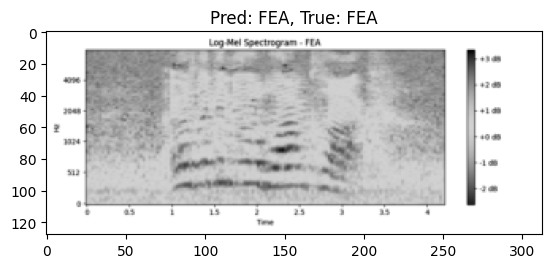

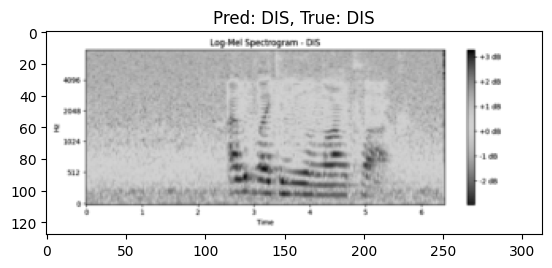

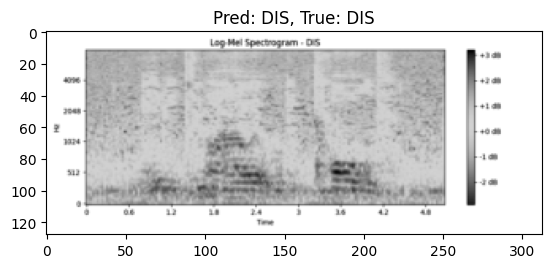

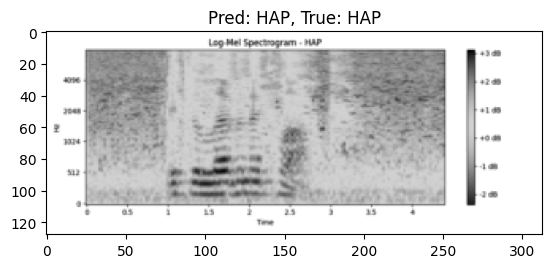

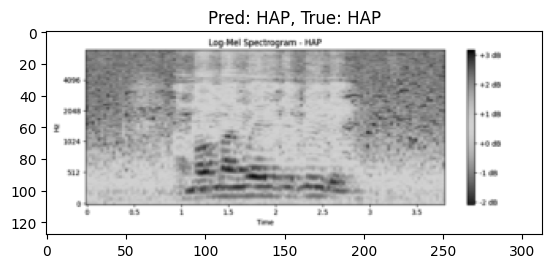

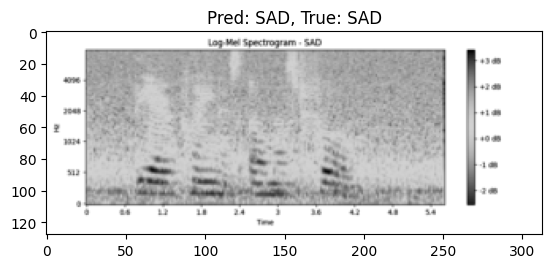

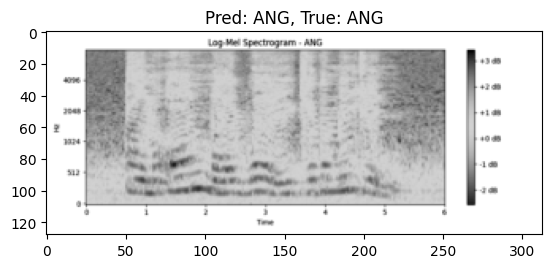

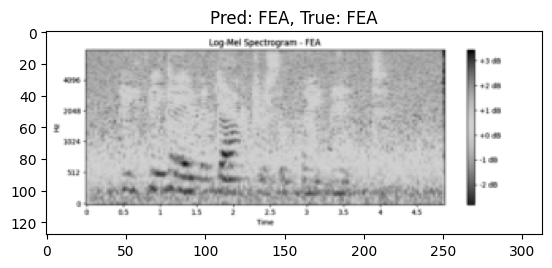

In [ ]:
import matplotlib.pyplot as plt

def plot_predictions(dataloader):
    model.eval()
    with torch.no_grad():
        for i, (images, labels) in enumerate(dataloader):
            outputs = model(images)
            _, preds = torch.max(outputs, 1)

            for j in range(4):  # Visualizar los primeros 4 ejemplos de cada batch
                plt.imshow(images[j].cpu().squeeze(), cmap='gray')
                plt.title(f'Pred: {valid_emotions[preds[j]]}, True: {valid_emotions[labels[j]]}')
                plt.show()

            if i >= 1:  # Solo mostrar un par de batches
                break

plot_predictions(val_dataloader)


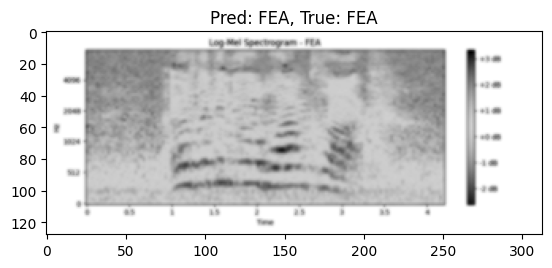

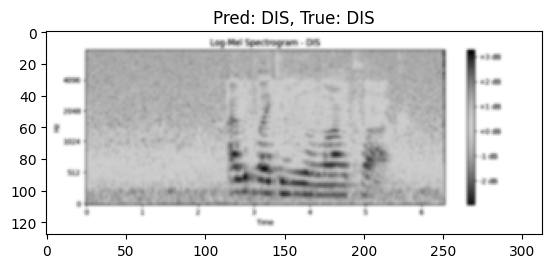

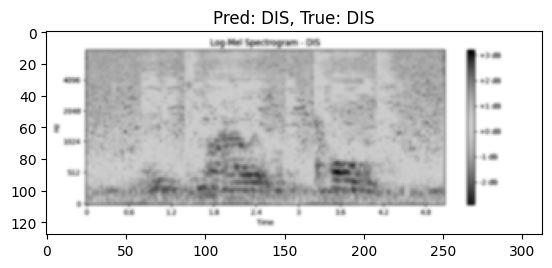

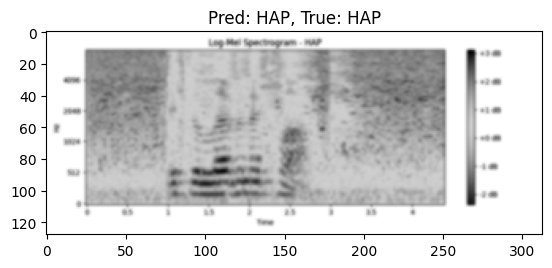

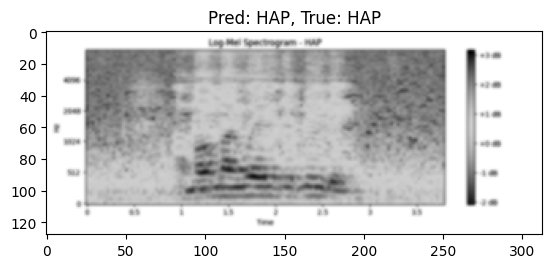

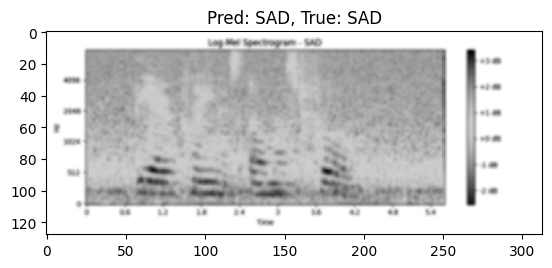

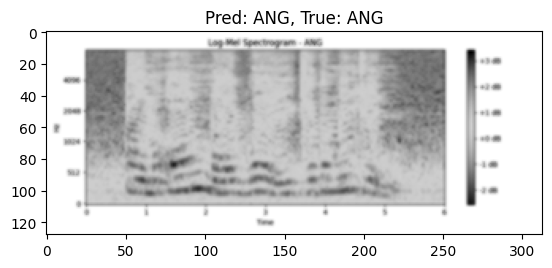

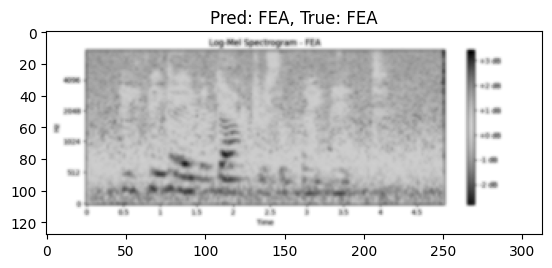

In [ ]:
import matplotlib.pyplot as plt
from PIL import ImageFilter

def plot_predictions(dataloader, model):
    model.eval()
    with torch.no_grad():
        for i, (images, labels) in enumerate(dataloader):
            outputs = model(images)
            _, preds = torch.max(outputs, 1)

            for j in range(4):  # Visualizar los primeros 4 ejemplos de cada batch
                # Aplicar filtro de suavizado a la imagen solo para visualización
                img = images[j].cpu().squeeze().numpy()
                img = Image.fromarray((img * 255).astype('uint8')).filter(ImageFilter.SMOOTH)  # Aplicar filtro
                plt.imshow(img, cmap='gray')
                plt.title(f'Pred: {valid_emotions[preds[j]]}, True: {valid_emotions[labels[j]]}')
                plt.show()

            if i >= 1:  # Solo mostrar un par de batches
                break

plot_predictions(val_dataloader, model)


In [ ]:
# Suponiendo que X_train tiene forma [num_samples, 1, height, width]
# Asegúrate de que X_train tenga la forma correcta
X_train_tensor = torch.tensor(X_train).unsqueeze(1)  # Añadir un canal para las imágenes en escala de grises

# Seleccionar una muestra para explicarlo
sample_image = X_train_tensor[0:1]  # Asegúrate de que el tamaño sea (1, 1, height, width)

# Generar explicaciones SHAP
explainer = shap.DeepExplainer(model, X_train_tensor[:100])  # X_train_tensor debe ser de la forma [n_samples, 1, height, width]
shap_values = explainer.shap_values(sample_image)

# Visualizar los resultados de SHAP sobre el espectrograma
plt.imshow(sample_image.squeeze(), cmap='gray', aspect='auto')
plt.imshow(shap_values[0][0].cpu().detach().numpy(), cmap='hot', alpha=0.5)  # SHAP overlay
plt.title(f'Explicación SHAP para la emoción: {valid_emotions[y_test[0]]}')
plt.colorbar()
plt.show()


RuntimeError: Given groups=1, weight of size [16, 1, 3, 3], expected input[1, 100, 1, 16384] to have 1 channels, but got 100 channels instead

In [ ]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import numpy as np
import glob
import os
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score

# Función para cargar las imágenes del espectrograma y convertirlas en datos
def load_spectrogram_images(spectrogram_folder):
    spectrogram_data = []
    spectrogram_labels = []

    for spectrogram_path in glob.glob(os.path.join(spectrogram_folder, "*.png")):
        img = mpimg.imread(spectrogram_path)
        img = np.mean(img, axis=2)  # Convertir a escala de grises si es RGB
        spectrogram_data.append(img)

        # Extraer la emoción de la ruta del archivo
        file_name = os.path.basename(spectrogram_path)
        emotion = file_name.split('_')[2]  # Asumir que la emoción está en el nombre del archivo
        spectrogram_labels.append(emotion)

    return np.array(spectrogram_data), np.array(spectrogram_labels)

# Cargar los espectrogramas y las etiquetas de emoción
spectrogram_images, spectrogram_emotions = load_spectrogram_images('spectrograms')

# Redimensionar las imágenes para que sean adecuadas para el modelo (por ejemplo, 128x128)
spectrogram_images_resized = np.array([np.resize(img, (128, 128)) for img in spectrogram_images])
spectrogram_images_resized = spectrogram_images_resized.reshape(spectrogram_images_resized.shape[0], -1)  # Aplanar para usar en modelos clásicos


In [ ]:
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score

# Dividir los datos en entrenamiento y prueba
X_train, X_test, y_train, y_test = train_test_split(spectrogram_images_resized, spectrogram_emotions, test_size=0.3, random_state=42)

# Entrenar un modelo de Random Forest
model = RandomForestClassifier(n_estimators=100, random_state=42)
model.fit(X_train, y_train)

# Evaluar el modelo
y_pred = model.predict(X_test)
accuracy = accuracy_score(y_test, y_pred)
print(f"Accuracy: {accuracy:.4f}")


Accuracy: 0.7000


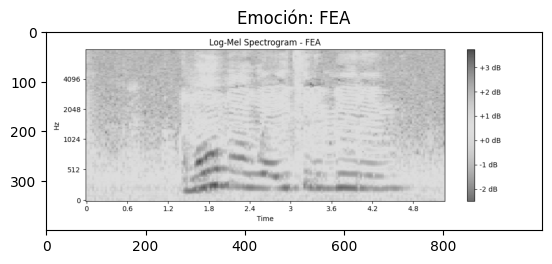

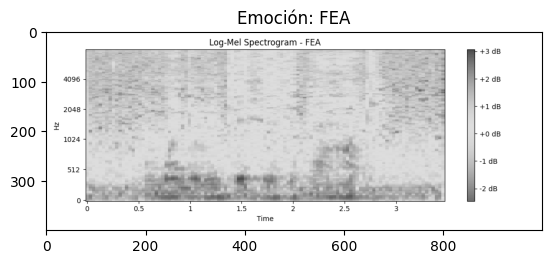

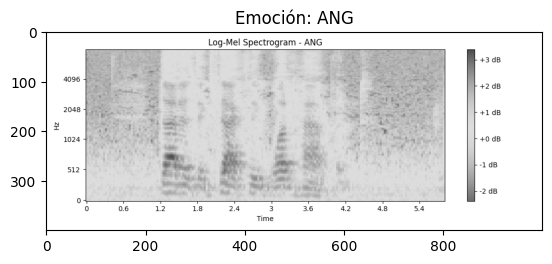

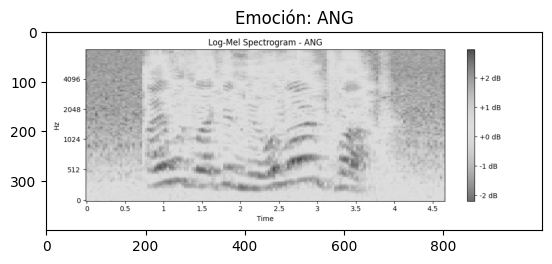

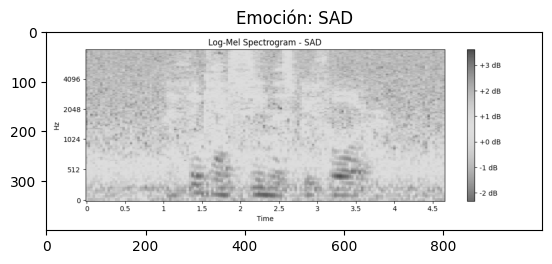

In [ ]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import glob
import os

# Función para cargar las imágenes del espectrograma
def load_spectrogram_images(spectrogram_folder):
    spectrogram_data = []
    spectrogram_labels = []

    for spectrogram_path in glob.glob(os.path.join(spectrogram_folder, "*.png")):
        img = mpimg.imread(spectrogram_path)
        img = np.mean(img, axis=2)  # Convertir a escala de grises si es RGB
        spectrogram_data.append(img)

        # Extraer la emoción de la ruta del archivo
        file_name = os.path.basename(spectrogram_path)
        emotion = file_name.split('_')[2]  # Asumir que la emoción está en el nombre del archivo
        spectrogram_labels.append(emotion)

    return np.array(spectrogram_data), np.array(spectrogram_labels)

# Cargar las imágenes y etiquetas
spectrogram_images, spectrogram_emotions = load_spectrogram_images('spectrograms')

# Mostrar las primeras 5 imágenes de espectrograma
for i in range(5):
    plt.imshow(spectrogram_images[i], cmap='gray')
    plt.title(f'Emoción: {spectrogram_emotions[i]}')
    plt.show()


In [ ]:
!pip install tensorflow

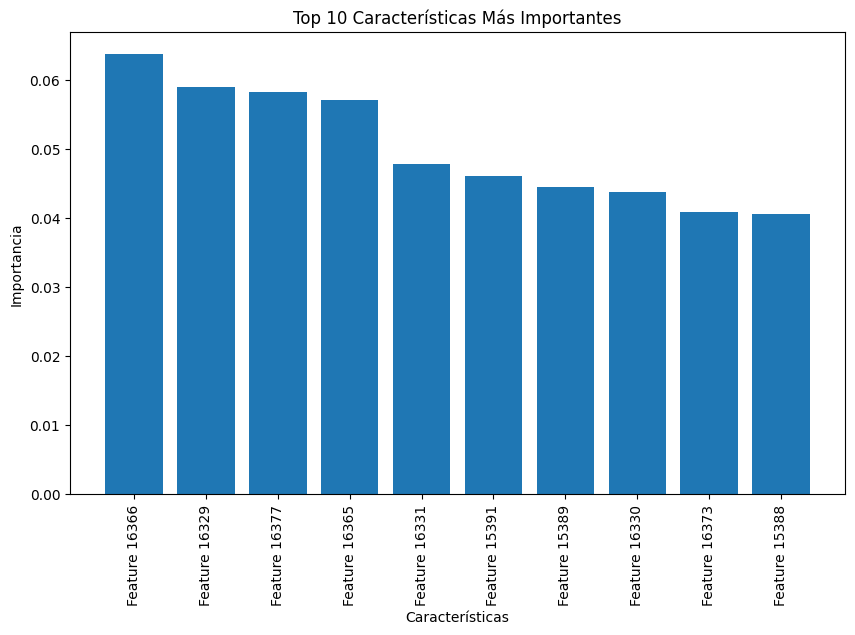

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

# Obtener la importancia de las características
importances = model.feature_importances_

# Ordenar las características según su importancia (de mayor a menor)
indices = np.argsort(importances)[::-1]

# Mostrar solo las 10 características más importantes (ajustable a cualquier número)
top_n = 10  # Número de características más importantes a mostrar
top_n_indices = indices[:top_n]
top_n_importances = importances[top_n_indices]

# Si tienes nombres de las características, sustitúyelos aquí
# Si no tienes nombres específicos, puedes usar "Feature 0", "Feature 1", etc.
top_n_feature_names = [f"Feature {i}" for i in top_n_indices]

# Graficar la importancia de las 10 características más importantes
plt.figure(figsize=(10, 6))
plt.title(f"Top {top_n} Características Más Importantes")
plt.bar(range(top_n), top_n_importances, align="center")
plt.xticks(range(top_n), top_n_feature_names, rotation=90)
plt.xlabel("Características")
plt.ylabel("Importancia")
plt.show()


In [ ]:
from lime.lime_tabular import LimeTabularExplainer

# Crear un explicador LIME para las imágenes (convertidas en datos planos)
explainer_lime = LimeTabularExplainer(
    training_data=X_train,
    feature_names=[f"pixel_{i}" for i in range(X_train.shape[1])],  # Nombres de las características
    class_names=np.unique(spectrogram_emotions),
    discretize_continuous=True
)

# Seleccionar un ejemplo de predicción para explicar
idx = 2  # Ejemplo específico de X_test
explanation = explainer_lime.explain_instance(X_test[idx], model.predict_proba, num_features=10)

# Mostrar la explicación de LIME
explanation.show_in_notebook()


In [ ]:
from lime.lime_tabular import LimeTabularExplainer
import matplotlib.pyplot as plt

# Crear un explicador LIME para las características tabulares
# Instead of using X_train.columns, we create a list of feature names.
feature_names = [f"pixel_{i}" for i in range(X_train.shape[1])]
explainer_lime = LimeTabularExplainer(
    training_data=X_train,
    feature_names=feature_names,  # Use the generated feature names
    class_names=np.unique(y_train),  # Assuming y_train contains your emotion labels
    discretize_continuous=True
)

# Seleccionar varios ejemplos de predicción para explicar
indices_to_explain = [2, 5, 10, 15, 20]  # Ejemplos seleccionados de X_test
explanations = []

# Explicar las predicciones para los ejemplos seleccionados
for idx in indices_to_explain:
    explanation = explainer_lime.explain_instance(X_test[idx], model.predict_proba, num_features=10)
    explanations.append(explanation)

# Mostrar las explicaciones en el notebook para los ejemplos seleccionados
for idx, explanation in zip(indices_to_explain, explanations):
    print(f"Explicación para el ejemplo con índice {idx}:")
    explanation.show_in_notebook()
    print("\n" + "="*50 + "\n")



Explicación para el ejemplo con índice 2:




Explicación para el ejemplo con índice 5:




Explicación para el ejemplo con índice 10:




Explicación para el ejemplo con índice 15:




Explicación para el ejemplo con índice 20:


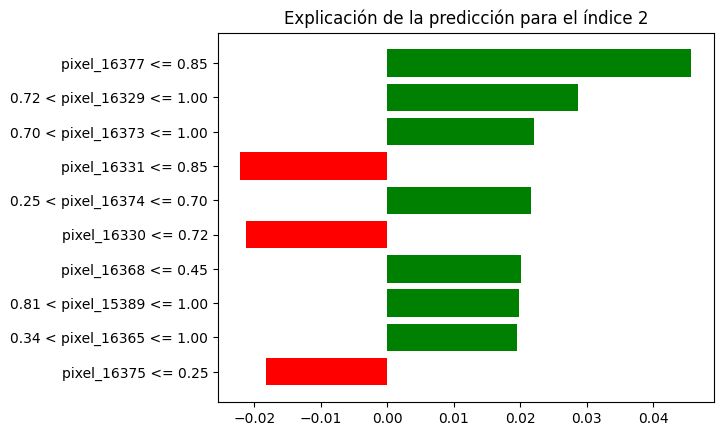

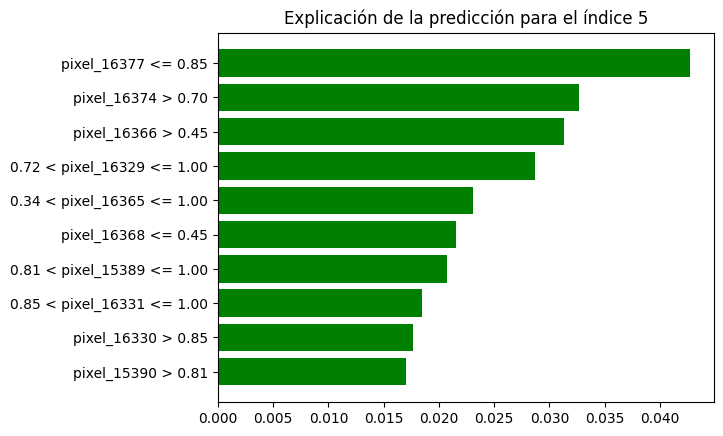

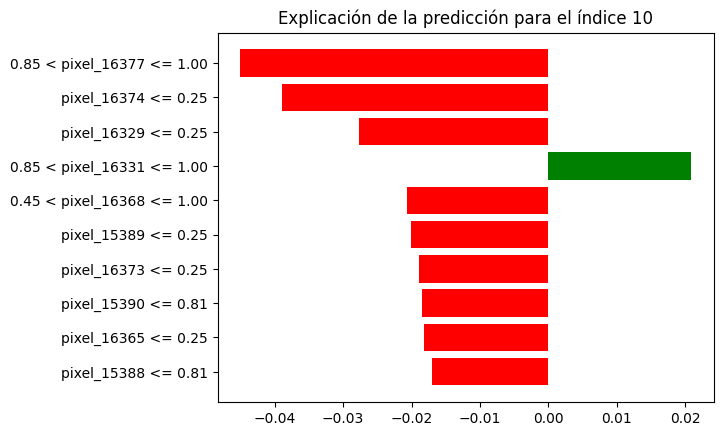

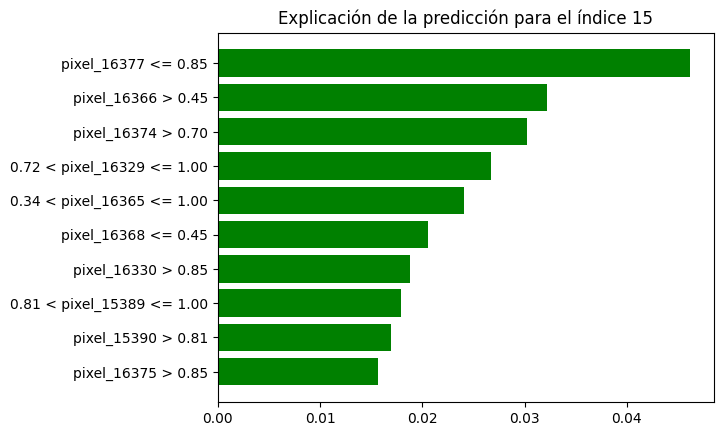

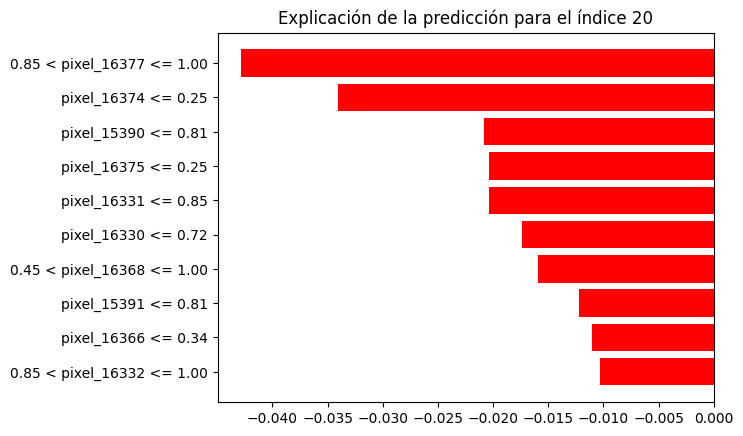

In [ ]:
# Mostrar una gráfica de las explicaciones
for idx, explanation in zip(indices_to_explain, explanations):
    fig = explanation.as_pyplot_figure()
    plt.title(f"Explicación de la predicción para el índice {idx}")
    plt.show()


In [ ]:
import os
import numpy as np
import pandas as pd
import librosa
import librosa.display
import matplotlib.pyplot as plt
import torch
from torchvision import transforms
from PIL import Image
import glob
import opensmile

# Parámetros para la extracción de características
sampling_rate = 16000
window_size = 512
hop_size = 256
n_fft = 1024
normalize = True
valid_emotions = ['ANG', 'DIS', 'FEA', 'HAP', 'NEU', 'SAD']
invalid_audio_ids = ['1088_ITH_HAP_XX.wav', '1017_IEO_SAD_HI.wav', '1040_ITH_SAD_X.wav']
max_records = 1000

# Configuración de OpenSMILE
smiles = {
    "eGeMAPSv02": opensmile.Smile(feature_set=opensmile.FeatureSet.eGeMAPSv02, feature_level=opensmile.FeatureLevel.Functionals),
    "emobase": opensmile.Smile(feature_set=opensmile.FeatureSet.emobase, feature_level=opensmile.FeatureLevel.Functionals)
}
required_headers = {
    "eGeMAPSv02": ["F0semitoneFrom27.5Hz_sma3nz_amean", "jitterLocal_sma3nz_amean", "shimmerLocaldB_sma3nz_amean", "mfcc1_sma3_amean"],
    "emobase": ["pcm_loudness_sma_amean", "pcm_intensity_sma_amean"]
}

# Extracción y almacenamiento de características
def extract_and_save_features(audio_files, smiles, required_headers, output_folder=".", spectrogram_folder="spectrograms"):
    os.makedirs(spectrogram_folder, exist_ok=True)
    feature_data = []

    for file_path in audio_files[:max_records]:
        file_name = os.path.basename(file_path)

        if file_name in invalid_audio_ids:
            continue

        parts = file_name.split('_')
        if len(parts) < 3 or parts[2] not in valid_emotions:
            continue

        emotion = parts[2]
        x, sr = librosa.load(file_path, sr=sampling_rate)
        stft = librosa.stft(x, n_fft=n_fft, hop_length=hop_size, win_length=window_size)
        magnitude = np.abs(stft)
        mel_filter = librosa.filters.mel(sr=sampling_rate, n_fft=n_fft, n_mels=128)
        mel_spectrogram = np.dot(mel_filter, magnitude)
        log_mel_spectrogram = librosa.power_to_db(mel_spectrogram, ref=np.max)

        if normalize:
            log_mel_spectrogram = (log_mel_spectrogram - np.mean(log_mel_spectrogram)) / np.std(log_mel_spectrogram)

        # Guardar el espectrograma como PNG
        spectrogram_path = os.path.join(spectrogram_folder, f'{file_name[:-4]}.png')
        plt.figure(figsize=(10, 4))
        librosa.display.specshow(log_mel_spectrogram, sr=sampling_rate, x_axis='time', y_axis='mel')
        plt.colorbar(format='%+2.0f dB')
        plt.savefig(spectrogram_path)
        plt.close()

        # Inicializar fila de características
        feature_row = {
            "file": file_name,
            "emotion": emotion,
            "spectrogram_path": spectrogram_path,
            "dimensions": f"{log_mel_spectrogram.shape[0]}x{log_mel_spectrogram.shape[1]}"
        }

        # Extraer características OpenSMILE
        for name, smile in smiles.items():
            features = smile.process_file(file_path)
            for column in required_headers[name]:
                if column in features.columns:
                    feature_row[column] = features[column].values[0]

        feature_data.append(feature_row)

    # Guardar en CSV
    feature_df = pd.DataFrame(feature_data)
    csv_path = os.path.join(output_folder, "metadata.csv")
    feature_df.to_csv(csv_path, index=False)
    print(f"Características guardadas en {csv_path}")

# Obtener archivos de audio y extraer características
audio_files = glob.glob(os.path.join(path, "AudioWAV", "*.wav"))
extract_and_save_features(audio_files, smiles, required_headers)


Características guardadas en ./metadata.csv


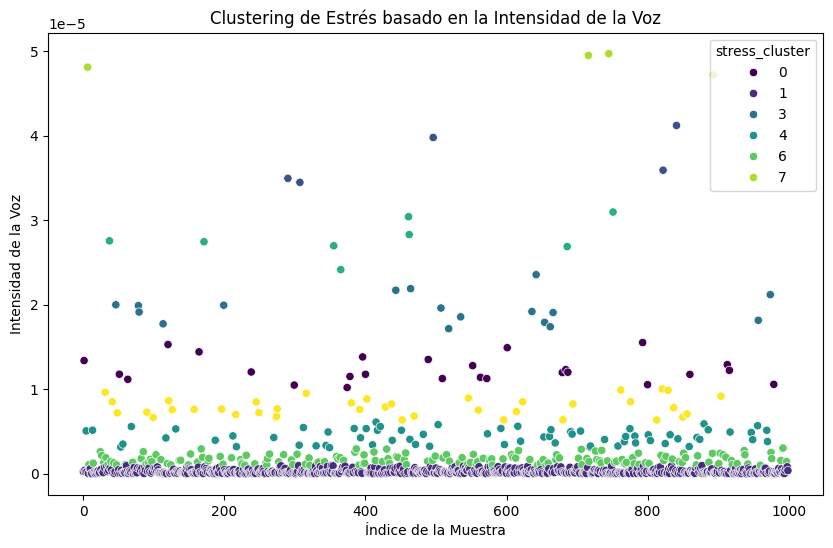

In [ ]:
import pandas as pd
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt
import seaborn as sns

# Cargar el archivo CSV
df = pd.read_csv('metadata.csv')  # Asegúrate de poner la ruta correcta del archivo

# Seleccionar solo la columna de intensidad
intensity = df[['pcm_intensity_sma_amean']]

# Normalizar la intensidad
scaler = StandardScaler()
intensity_scaled = scaler.fit_transform(intensity)

# Aplicar K-Means para el clustering
kmeans = KMeans(n_clusters=9, random_state=42)  # Número de clusters basado en el patrón de estrés
df['stress_cluster'] = kmeans.fit_predict(intensity_scaled)

# Visualizar los clusters en un gráfico
plt.figure(figsize=(10, 6))
sns.scatterplot(x=df.index, y=df['pcm_intensity_sma_amean'], hue=df['stress_cluster'], palette='viridis')
plt.title('Clustering de Estrés basado en la Intensidad de la Voz')
plt.xlabel('Índice de la Muestra')
plt.ylabel('Intensidad de la Voz')
plt.show()


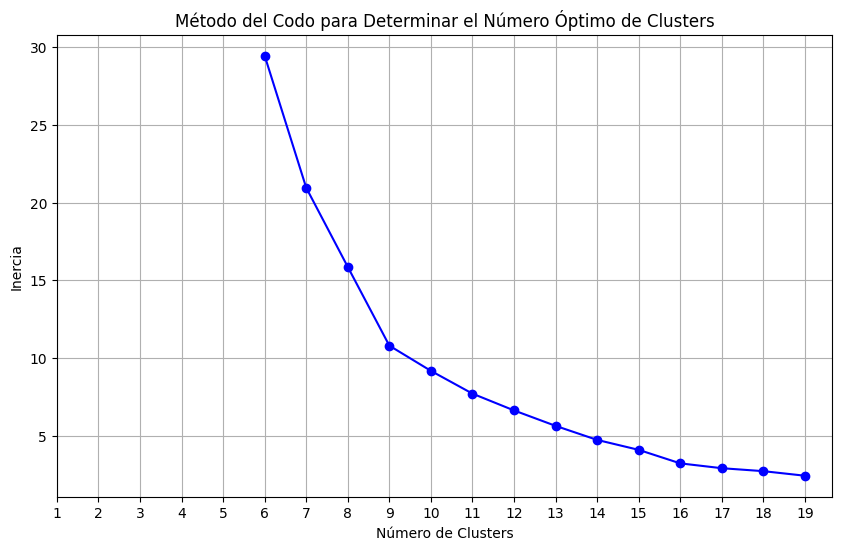

In [ ]:
import pandas as pd
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt

# Usamos solo la columna de intensidad
intensity = df[['pcm_intensity_sma_amean']]

# Normalizamos los datos
scaler = StandardScaler()
intensity_scaled = scaler.fit_transform(intensity)

# Calcular el codo
inertia = []
for k in range(6, 20):  # Probar de 1 a 10 clusters
    kmeans = KMeans(n_clusters=k, random_state=42)
    kmeans.fit(intensity_scaled)
    inertia.append(kmeans.inertia_)

# Visualizar el codo
plt.figure(figsize=(10, 6))
plt.plot(range(6, 20), inertia, marker='o', color='b')
plt.title('Método del Codo para Determinar el Número Óptimo de Clusters')
plt.xlabel('Número de Clusters')
plt.ylabel('Inercia')
plt.xticks(range(1, 20))
plt.grid(True)
plt.show()


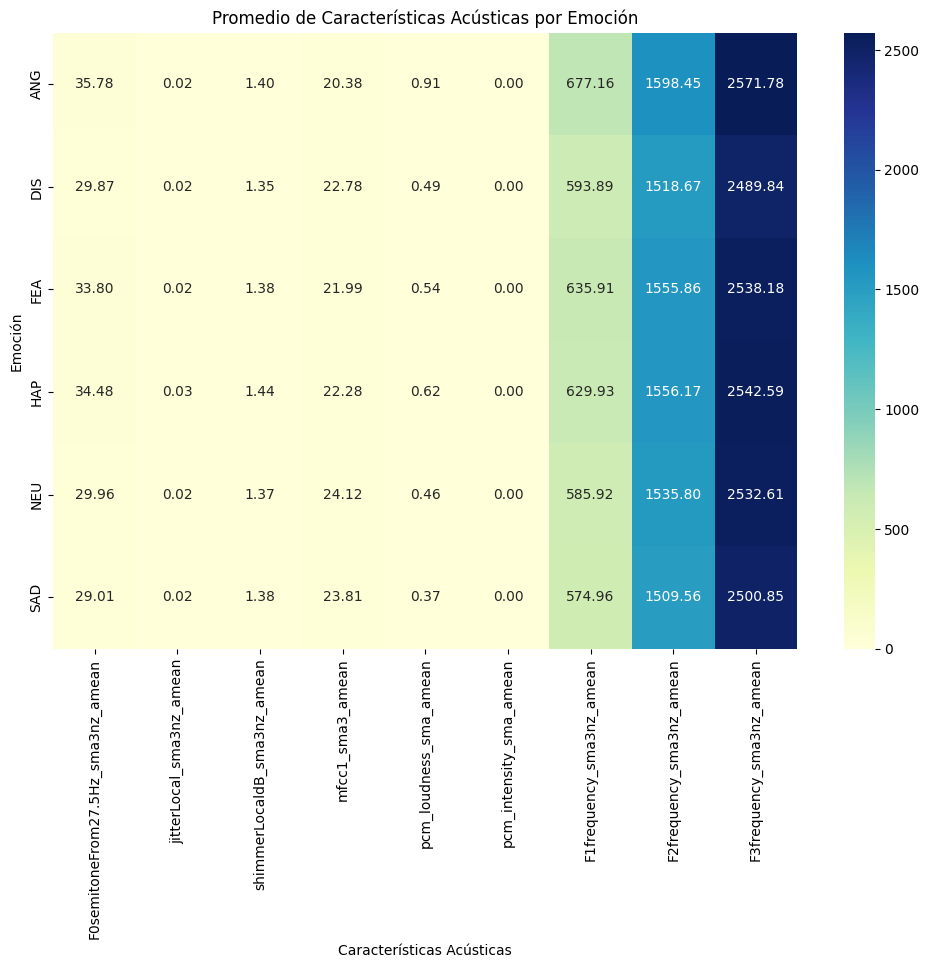

In [ ]:
# Agrupar las características acústicas por emoción y calcular la media para cada emoción
df_grouped = df.groupby('emotion')[features].mean()

# Visualizar un heatmap de las características acústicas por emoción
plt.figure(figsize=(12, 8))
sns.heatmap(df_grouped, annot=True, cmap='YlGnBu', fmt='.2f')
plt.title('Promedio de Características Acústicas por Emoción')
plt.ylabel('Emoción')
plt.xlabel('Características Acústicas')
plt.show()


In [ ]:
import pandas as pd
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score

# Cargar el archivo CSV con los datos (suponiendo que 'metadata.csv' tiene las características)
data = pd.read_csv("metadata.csv")

# Seleccionamos las columnas de características (sin la columna de etiquetas 'emotion')
X = data.drop(columns=['emotion', 'file', 'spectrogram_path', 'id', 'dimensions', 'height', 'width', 'sampling_rate', 'window_size', 'hop_size', 'n_fft', 'window_function'])
y = data['emotion']

# Dividir en datos de entrenamiento y prueba
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

# Entrenar un modelo básico (Random Forest)
model = RandomForestClassifier(n_estimators=100, random_state=42)
model.fit(X_train, y_train)

# Evaluar el modelo
y_pred = model.predict(X_test)
accuracy = accuracy_score(y_test, y_pred)
print(f"Accuracy: {accuracy:.4f}")


Accuracy: 0.3767


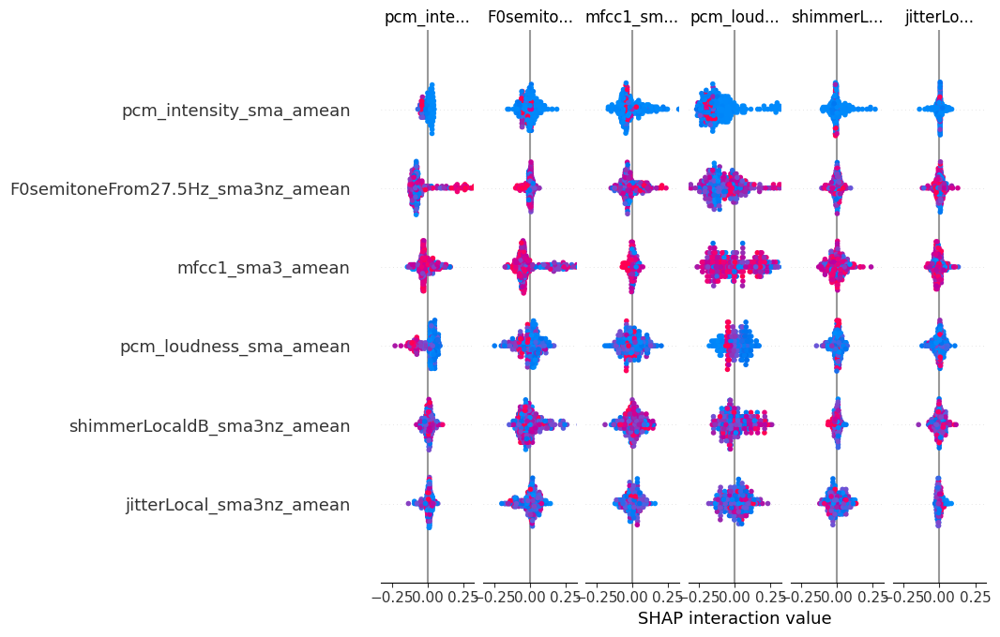

In [ ]:
import shap

# Crear un objeto explainer con SHAP
explainer = shap.TreeExplainer(model)
shap_values = explainer.shap_values(X_test)

# Visualizar el resumen de SHAP
shap.summary_plot(shap_values, X_test)


In [ ]:
import lime
from lime.lime_tabular import LimeTabularExplainer

# Crear un explicador LIME
explainer_lime = LimeTabularExplainer(
    training_data=X_train.values,
    feature_names=X_train.columns,
    class_names=y.unique(),
    discretize_continuous=True
)

# Seleccionar un ejemplo de predicción para explicar
idx = 0  # Aquí seleccionamos el primer ejemplo
explanation = explainer_lime.explain_instance(X_test.iloc[idx].values, model.predict_proba, num_features=10)

# Mostrar la explicación de LIME
explanation.show_in_notebook()


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:493: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(


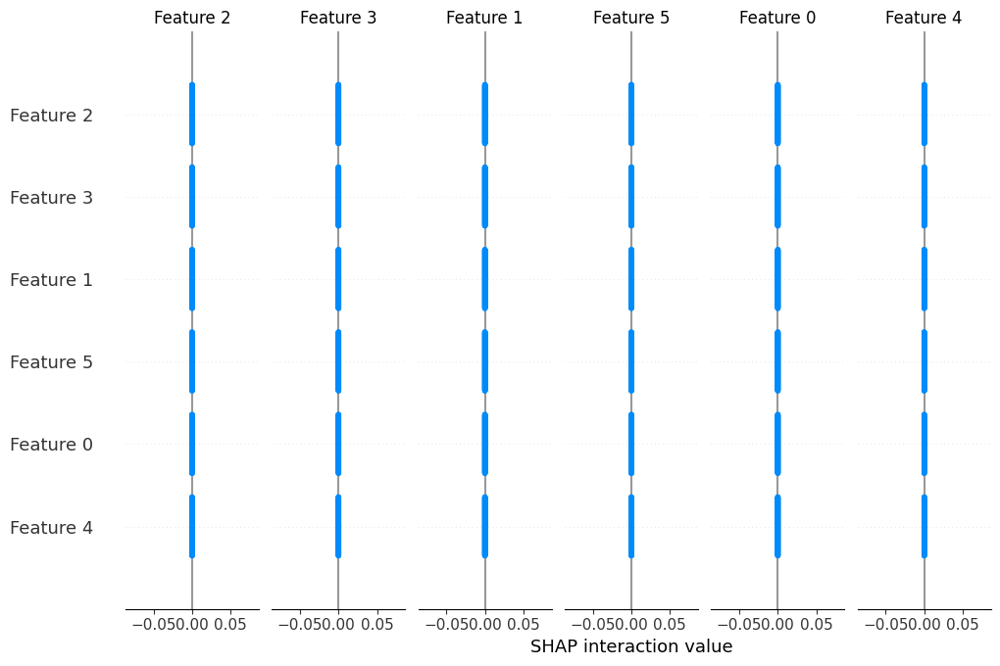

In [ ]:
import shap

# Crear un objeto explainer con SHAP para un modelo de Random Forest
explainer = shap.TreeExplainer(model)
shap_values = explainer.shap_values(X_test)

# Visualizar el resumen de SHAP para las imágenes de espectrogramas
shap.summary_plot(shap_values, X_test)


In [ ]:
import shap
import numpy as np
import pandas as pd
from sklearn.ensemble import RandomForestClassifier

# Cargar el archivo metadata.csv
feature_data = pd.read_csv('metadata.csv')

# Ver las primeras filas del archivo para confirmar su estructura
print(feature_data.head())

# Suponiendo que feature_data es el DataFrame que contiene las características de los espectrogramas
# Y las etiquetas de emoción están en la columna 'emotion'

# Selección de las características y la variable objetivo
X = feature_data.drop(columns=['emotion', 'file', 'spectrogram_path', 'id', 'dimensions', 'height', 'width', 'sampling_rate', 'window_size', 'hop_size', 'n_fft', 'window_function'])
y = feature_data['emotion']

# Entrenamiento del modelo Random Forest
model = RandomForestClassifier(n_estimators=100, random_state=42)
model.fit(X, y)

# Usar SHAP para explicar las predicciones
explainer = shap.TreeExplainer(model)
shap_values = explainer.shap_values(X)

# Visualizar los valores de SHAP para la primera clase
shap.summary_plot(shap_values[0], X)


   F0semitoneFrom27.5Hz_sma3nz_amean  jitterLocal_sma3nz_amean  \
0                          35.559376                  0.023770   
1                          35.242695                  0.035631   
2                          25.237286                  0.011599   
3                          24.813677                  0.020852   
4                          32.879570                  0.016261   

   shimmerLocaldB_sma3nz_amean  mfcc1_sma3_amean  pcm_loudness_sma_amean  \
0                     1.498933         20.924550                0.411601   
1                     1.334410         23.338686                1.124664   
2                     0.912609         25.136976                0.498719   
3                     1.173514         24.556091                0.435625   
4                     1.251932         22.709730                0.862807   

   pcm_intensity_sma_amean  F1frequency_sma3nz_amean  \
0             2.723288e-07                  674.5390   
1             1.340342e-05        

AssertionError: The shape of the shap_values matrix does not match the shape of the provided data matrix.

In [ ]:
import lime
from lime.lime_image import LimeImageExplainer
import numpy as np
import matplotlib.pyplot as plt
import librosa
import librosa.display

# Suponiendo que tienes un espectrograma guardado como imagen y su correspondiente vector de características
def explain_with_lime(img, model, X):
    # Creamos el explainer de LIME
    explainer = LimeImageExplainer()

    # LIME necesita una función de predicción que tome imágenes (como espectrogramas)
    def predict_fn(images):
        images = images / 255.0  # Normalizar las imágenes
        # Assuming your model takes features as input
        # Reshape to match expected input shape
        images = images.reshape(images.shape[0], -1)
        return model.predict(images)


    # Explicamos la predicción para una imagen específica
    explanation = explainer.explain_instance(img, predict_fn, top_labels=5, hide_color=0, num_samples=1000, segmentation_fn=lime.wrappers.scikit_image.SegmentationAlgorithm('quickshift', kernel_size=4, max_dist=200, ratio=0.2, convert2lab=False))

    # Mostrar la explicación
    temp, mask = explanation.get_image_and_mask(0, positive_only=True, num_features=5, hide_rest=False)
    plt.imshow(temp)
    plt.title("LIME Explanation (Top 5 features)")
    plt.show()

# Assuming 'espectrogramas' is a list of spectrograms,
#  we select the first one and convert it to an image-like format:
#  Replace 0 with the index of the spectrogram you want to use
spectrogram = espectrogramas[0].numpy()
spectrogram = spectrogram.transpose(1, 2, 0) # Transpose to (height, width, channels)
# Ensure spectrogram values are within 0-255 range for image representation
spectrogram = (spectrogram - spectrogram.min()) / (spectrogram.max() - spectrogram.min()) * 255
spectrogram = spectrogram.astype(np.uint8)  # Convert to uint8

# Pass the prepared spectrogram to explain_with_lime
explain_with_lime(spectrogram, model, X)

  0%|          | 0/1000 [00:00<?, ?it/s]

/usr/local/lib/python3.10/dist-packages/sklearn/base.py:493: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(


ValueError: X has 15360 features, but RandomForestClassifier is expecting 9 features as input.

In [ ]:
import lime
from lime.lime_image import LimeImageExplainer
import numpy as np
import matplotlib.pyplot as plt
import librosa
import librosa.display

# Suponiendo que tienes un espectrograma guardado como imagen y su correspondiente vector de características
def explain_with_lime(img, model, X):
    # Creamos el explainer de LIME
    explainer = LimeImageExplainer()

    # LIME necesita una función de predicción que tome imágenes (como espectrogramas)
    def predict_fn(images):
        images = images / 255.0  # Normalizar las imágenes
        # Assuming your model takes features as input
        # Reshape to match expected input shape
        images = images.reshape(images.shape[0], -1)
        return model.predict(images)

    # Explicamos la predicción para una imagen específica
    # Setting 'convert_to_grayscale=True' for single-channel images
    explanation = explainer.explain_instance(img, predict_fn, top_labels=5, hide_color=0, num_samples=1000, segmentation_fn=lime.wrappers.scikit_image.SegmentationAlgorithm('quickshift', kernel_size=4, max_dist=200, ratio=0.2, convert2lab=False))

    # Mostrar la explicación
    temp, mask = explanation.get_image_and_mask(0, positive_only=True, num_features=5, hide_rest=False)
    plt.imshow(temp)
    plt.title("LIME Explanation (Top 5 features)")
    plt.show()

# Assuming 'espectrogramas' is a list of spectrograms,
#  we select the first one and convert it to an image-like format:
#  Replace 0 with the index of the spectrogram you want to use
spectrogram = espectrogramas[0].numpy()
spectrogram = spectrogram.transpose(1, 2, 0) # Transpose to (height, width, channels)
# Ensure spectrogram values are within 0-255 range for image representation
spectrogram = (spectrogram - spectrogram.min()) / (spectrogram.max() - spectrogram.min()) * 255
spectrogram = spectrogram.astype(np.uint8)  # Convert to uint8

# Pass the prepared spectrogram to explain_with_lime
explain_with_lime(spectrogram, model, X)

  0%|          | 0/1000 [00:00<?, ?it/s]

/usr/local/lib/python3.10/dist-packages/sklearn/base.py:493: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(


ValueError: X has 15360 features, but RandomForestClassifier is expecting 9 features as input.

In [ ]:
import lime
from lime.lime_image import LimeImageExplainer
import numpy as np
import matplotlib.pyplot as plt
import librosa.display

# Suponiendo que tienes un espectrograma guardado como imagen y su correspondiente vector de características
def explain_with_lime(img, model, X):
    # Creamos el explainer de LIME
    explainer = LimeImageExplainer()

    # LIME necesita una función de predicción que tome imágenes (como espectrogramas)
    def predict_fn(images):
        images = images / 255.0  # Normalizar las imágenes
        return model.predict(images)

    # Explicamos la predicción para una imagen específica
    explanation = explainer.explain_instance(img, predict_fn, top_labels=5, hide_color=0, num_samples=1000)

    # Mostrar la explicación
    temp, mask = explanation.get_image_and_mask(0, positive_only=True, num_features=5, hide_rest=False)
    plt.imshow(temp)
    plt.title("LIME Explanation (Top 5 features)")
    plt.show()

# Aquí img es el espectrograma convertido en imagen (por ejemplo, usando librosa y guardado como PNG)
# Y X son las características correspondientes de entrada
explain_with_lime(img, model, X)


NameError: name 'img' is not defined

In [ ]:
from sklearn.metrics import classification_report, confusion_matrix

# Predicciones del modelo
y_pred = model.predict(X)

# Imprimir las métricas de evaluación
print("Classification Report:\n", classification_report(y, y_pred))

# Matriz de confusión
conf_matrix = confusion_matrix(y, y_pred)
plt.figure(figsize=(10, 7))
plt.imshow(conf_matrix, cmap='Blues', interpolation='nearest')
plt.title("Confusion Matrix")
plt.colorbar()
plt.xticks(np.arange(len(valid_emotions)), valid_emotions, rotation=45)
plt.yticks(np.arange(len(valid_emotions)), valid_emotions)
plt.ylabel('True label')
plt.xlabel('Predicted label')
plt.show()


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:486: UserWarning: X has feature names, but RandomForestClassifier was fitted without feature names
  warnings.warn(


ValueError: X has 9 features, but RandomForestClassifier is expecting 16384 features as input.

In [ ]:
from lime import lime_image
from skimage.segmentation import mark_boundaries
import matplotlib.pyplot as plt
import numpy as np

# Seleccionar una muestra del conjunto de validación
sample_data, _ = next(iter(val_dataloader))
single_image = sample_data[0].numpy().squeeze()  # Seleccionar la primera imagen y hacer squeeze para reducir dimensiones

# Crear un explainer de LIME
explainer = lime_image.LimeImageExplainer()

# Explicar la predicción para una imagen
explanation = explainer.explain_instance(single_image, lambda x: model(torch.tensor(x).float().unsqueeze(1)).detach().numpy(), top_labels=1, hide_color=0, num_samples=1000)

# Visualizar
temp, mask = explanation.get_image_and_mask(label=explanation.top_labels[0], positive_only=False, hide_rest=False, num_features=5, min_weight=0.0)
plt.imshow(mark_boundaries(temp, mask))
plt.show()


In [ ]:
import kagglehub
import numpy as np
import librosa
import librosa.display
import matplotlib.pyplot as plt
import pandas as pd
import os  # Importar el módulo os
import glob  # Importar la función glob
import opensmile

# Paso 1: Descargar el dataset de Kaggle y devolver la ruta donde se almacena
path = kagglehub.dataset_download("ejlok1/cremad")
print("Path to dataset files:", path)

# Paso 1.1: Definir los audio_ids que deseas eliminar
invalid_audio_ids = ['1088_ITH_HAP_XX.wav', '1017_IEO_SAD_HI.wav', '1040_ITH_SAD_X.wav']

# 1. Parámetros para el STFT
sampling_rate = 16000
window_size = 512
hop_size = 256
n_fft = 1024
normalize = True

# Inicializar OpenSMILE

smile = opensmile.Smile(
    feature_set=opensmile.FeatureSet.eGeMAPS,
    feature_level=opensmile.FeatureLevel.Functionals,
)


# Crear carpeta para guardar espectrogramas
os.makedirs('spectrograms', exist_ok=True)

# 2. Buscar archivos con extensión .wav en la carpeta 'AudioWAV'
audio_files = glob.glob(os.path.join(path, "AudioWAV", "*.wav"))
print(f"Found {len(audio_files)} audio files.")

# 3. Parametros de almacenamiento
max_files = 100
limited_audio_files = audio_files[:max_files]
valid_emotions = ['ANG', 'DIS', 'FEA', 'HAP', 'NEU', 'SAD']
print(f"Limiting to {len(limited_audio_files)} audio files.")

# Lista para almacenar los resultados
results = []

# 4. Procesar un número limitado de archivos de audio
for file_path in limited_audio_files:
    file_name = os.path.basename(file_path)
    if file_name in invalid_audio_ids:
        print(f"Archivo inválido omitido: {file_name}")
        continue  # Saltar archivos inválidos
    parts = file_name.split('_')
    emotion = parts[2] if len(parts) > 2 else 'UNKNOWN'  # Asigna UNKNOWN si no hay emoción

    # Verificar si la emoción es válida
    if emotion not in valid_emotions:
        print(f"Emoción no válida en {file_name}: {emotion}")
        continue  # Saltar archivos con emociones no válidas

    # 5. Cargar el audio y calcular el Log-Mel Spectrogram
    x, sr = librosa.load(file_path, sr=sampling_rate)
    stft = librosa.stft(x, n_fft=n_fft, hop_length=hop_size, win_length=window_size)
    magnitude = np.abs(stft)
    mel_filter = librosa.filters.mel(sr=sampling_rate, n_fft=n_fft, n_mels=128)
    mel_spectrogram = np.dot(mel_filter, magnitude)
    log_mel_spectrogram = librosa.power_to_db(mel_spectrogram, ref=np.max)

    # 6. Normalización (opcional)
    if normalize:
        log_mel_spectrogram = (log_mel_spectrogram - np.mean(log_mel_spectrogram)) / np.std(log_mel_spectrogram)

    # 7. Visualizar y guardar el Log-Mel Spectrogram
    plt.figure(figsize=(10, 4))
    librosa.display.specshow(log_mel_spectrogram, sr=sampling_rate, x_axis='time', y_axis='mel')
    plt.colorbar(format='%+2.0f dB')
    plt.title(f'Log-Mel Spectrogram - {emotion}')
    plt.tight_layout()

# Guardar el espectrograma como PNG con el nombre original sin la extensión .wav
    spectrogram_filename = f'{file_name[:-4]}.png'  # Eliminar .wav
    os.makedirs('spectrograms', exist_ok=True)
    plt.savefig(os.path.join('spectrograms', spectrogram_filename))
    plt.close()
    # Extraer características de OpenSMILE
    open_smile_features = smile.process_file(file_path)
    open_smile_features['emotion'] = emotion
    open_smile_features['spectrogram_path'] = os.path.join('spectrograms', spectrogram_filename)
    open_smile_features['id'] = spectrogram_filename  # ID basado en el nombre del espectrograma
    open_smile_features['dimensions'] = f"{log_mel_spectrogram.shape[0]}x{log_mel_spectrogram.shape[1]}"
    open_smile_features['height'] = log_mel_spectrogram.shape[0]
    open_smile_features['width'] = log_mel_spectrogram.shape[1]
    open_smile_features['sampling_rate'] = sampling_rate
    open_smile_features['window_size'] = window_size
    open_smile_features['hop_size'] = hop_size
    open_smile_features['n_fft'] = n_fft
    open_smile_features['window_function'] = 'Hamming'

    # Agregar a la lista de resultados
    results.append(open_smile_features)
if results:
    final_df = pd.concat(results, ignore_index=True)
    metadata_filename = 'metadata.csv'
    final_df.to_csv(metadata_filename, index=False)

print("Espectrogramas y metadatos guardados.")

Path to dataset files: /root/.cache/kagglehub/datasets/ejlok1/cremad/versions/1
Found 7442 audio files.
Limiting to 100 audio files.


/usr/local/lib/python3.10/dist-packages/opensmile/core/smile.py:251: UserWarning: Feature set 'FeatureSet.eGeMAPS' is deprecated, consider switching to 'FeatureSet.eGeMAPSv02'.
  warnings.warn(


Espectrogramas y metadatos guardados.


In [ ]:
import kagglehub
import numpy as np
import pandas as pd
import os
import glob
import opensmile

# Paso 1: Descargar el dataset de Kaggle y devolver la ruta donde se almacena
path = kagglehub.dataset_download("ejlok1/cremad")
print("Path to dataset files:", path)

# Inicializa openSMILE con diferentes configuraciones
smiles = {
    "eGeMAPSv02": opensmile.Smile(feature_set=opensmile.FeatureSet.eGeMAPSv02, feature_level=opensmile.FeatureLevel.Functionals),
    "emobase": opensmile.Smile(feature_set=opensmile.FeatureSet.emobase, feature_level=opensmile.FeatureLevel.Functionals),
    "eGeMAPS": opensmile.Smile(feature_set=opensmile.FeatureSet.eGeMAPS, feature_level=opensmile.FeatureLevel.Functionals)
}

# Define los encabezados requeridos para cada conjunto de características
required_headers = {
    "eGeMAPSv02": ["F0semitoneFrom27.5Hz_sma3nz_amean", "jitterLocal_sma3nz_amean", "shimmerLocaldB_sma3nz_amean", "mfcc1_sma3_amean"],
    "emobase": ["pcm_loudness_sma_amean", "pcm_intensity_sma_amean"],
    "eGeMAPS": ["F1frequency_sma3nz_amean", "F2frequency_sma3nz_amean", "F3frequency_sma3nz_amean"]
}

# Paso 2: Buscar archivos de audio .wav en la carpeta "AudioWAV"
audio_files = glob.glob(os.path.join(path, "AudioWAV", "*.wav"))

# Crear carpeta de salida para CSV
output_folder = "."
#os.makedirs(output_folder, exist_ok=True)

# Función para extraer y guardar características en CSV
def extract_and_save_features(audio_files, smiles, output_folder):
    for name, smile in smiles.items():
        # Crear DataFrame vacío para almacenar las características
        feature_data = pd.DataFrame()

        # Limitar la cantidad de archivos de audio para pruebas (por ejemplo, los primeros 5)
        limited_audio_files = audio_files[:5]

        for file_path in limited_audio_files:
            features = smile.process_file(file_path)  # Extraer características
            features["file"] = os.path.basename(file_path)  # Añadir columna con el nombre del archivo
            feature_data = pd.concat([feature_data, features], axis=0)  # Agregar al DataFrame

        # Guardar en CSV
        output_csv = os.path.join(output_folder, f"{name}_features.csv")
        feature_data.to_csv(output_csv, index=False)
        print(f"Features extraídas y guardadas en {output_csv}")

# Llamar a la función para extraer y guardar características
extract_and_save_features(audio_files, smiles, output_folder)

# Verificar si los CSV contienen los encabezados requeridos
def check_headers(output_folder, required_headers):
    for name, headers in required_headers.items():
        csv_file = os.path.join(output_folder, f"{name}_features.csv")
        df = pd.read_csv(csv_file)

        missing_headers = [header for header in headers if header not in df.columns]
        if not missing_headers:
            print(f"Todas las características necesarias están presentes en {csv_file}")
        else:
            print(f"Faltan las siguientes características en {csv_file}: {missing_headers}")

# Llamar a la función para verificar los encabezados
check_headers(output_folder, required_headers)


Path to dataset files: /root/.cache/kagglehub/datasets/ejlok1/cremad/versions/1


/usr/local/lib/python3.10/dist-packages/opensmile/core/smile.py:251: UserWarning: Feature set 'FeatureSet.eGeMAPS' is deprecated, consider switching to 'FeatureSet.eGeMAPSv02'.
  warnings.warn(


Features extraídas y guardadas en ./eGeMAPSv02_features.csv
Features extraídas y guardadas en ./emobase_features.csv
Features extraídas y guardadas en ./eGeMAPS_features.csv
Todas las características necesarias están presentes en ./eGeMAPSv02_features.csv
Todas las características necesarias están presentes en ./emobase_features.csv
Faltan las siguientes características en ./eGeMAPS_features.csv: ['F0frequency_sma3nz_amean']


In [ ]:
import kagglehub
import numpy as np
import pandas as pd
import os
import glob
import opensmile

# Paso 1: Descargar el dataset de Kaggle y devolver la ruta donde se almacena
path = kagglehub.dataset_download("ejlok1/cremad")
print("Path to dataset files:", path)

# Inicializa openSMILE con diferentes configuraciones
smiles = {
    "eGeMAPSv02": opensmile.Smile(feature_set=opensmile.FeatureSet.eGeMAPSv02, feature_level=opensmile.FeatureLevel.Functionals),
    "emobase": opensmile.Smile(feature_set=opensmile.FeatureSet.emobase, feature_level=opensmile.FeatureLevel.Functionals),
    "eGeMAPS": opensmile.Smile(feature_set=opensmile.FeatureSet.eGeMAPS, feature_level=opensmile.FeatureLevel.Functionals)
}

# Define los encabezados requeridos para cada conjunto de características
required_headers = {
    "eGeMAPSv02": ["F0semitoneFrom27.5Hz_sma3nz_amean", "jitterLocal_sma3nz_amean", "shimmerLocaldB_sma3nz_amean", "mfcc1_sma3_amean"],
    "emobase": ["pcm_loudness_sma_amean", "pcm_intensity_sma_amean"],
    "eGeMAPS": ["F1frequency_sma3nz_amean", "F2frequency_sma3nz_amean", "F3frequency_sma3nz_amean"]
}

# Paso 2: Buscar archivos de audio .wav en la carpeta "AudioWAV"
audio_files = glob.glob(os.path.join(path, "AudioWAV", "*.wav"))

# Crear carpeta de salida para CSV
output_folder = "."
# os.makedirs(output_folder, exist_ok=True)

# Función para extraer y guardar características en CSV
def extract_and_save_features(audio_files, smiles, output_folder):
    for name, smile in smiles.items():
        # Crear DataFrame vacío para almacenar las características
        feature_data = pd.DataFrame()

        # Limitar la cantidad de archivos de audio para pruebas (por ejemplo, los primeros 5)
        limited_audio_files = audio_files[:5]

        for file_path in limited_audio_files:
            features = smile.process_file(file_path)  # Extraer características
            feature_data = pd.concat([feature_data, features[required_headers[name]]], axis=0)  # Agregar solo las columnas requeridas al DataFrame

        # Guardar en CSV individual
        output_csv = os.path.join(output_folder, f"{name}_features.csv")
        feature_data.to_csv(output_csv, index=False)
        print(f"Features extraídas y guardadas en {output_csv}")

# Llamar a la función para extraer y guardar características
extract_and_save_features(audio_files, smiles, output_folder)

# Combinar archivos CSV en uno solo sin cambiar nombres ni agregar identificadores
def combine_csv_files(output_folder, smiles):
    combined_df = pd.DataFrame()

    for name in smiles.keys():
        csv_file = os.path.join(output_folder, f"{name}_features.csv")
        if os.path.exists(csv_file):
            df = pd.read_csv(csv_file)
            combined_df = pd.concat([combined_df, df], axis=1)  # Combinar lado a lado las columnas seleccionadas

    # Guardar el archivo combinado en el directorio actual
    combined_csv_path = os.path.join(output_folder, "combined_features.csv")
    combined_df.to_csv(combined_csv_path, index=False)
    print(f"Archivo combinado guardado en {combined_csv_path}")

# Llamar a la función para combinar los CSV en uno solo
combine_csv_files(output_folder, smiles)


Path to dataset files: /root/.cache/kagglehub/datasets/ejlok1/cremad/versions/1


/usr/local/lib/python3.10/dist-packages/opensmile/core/smile.py:251: UserWarning: Feature set 'FeatureSet.eGeMAPS' is deprecated, consider switching to 'FeatureSet.eGeMAPSv02'.
  warnings.warn(


Features extraídas y guardadas en ./eGeMAPSv02_features.csv
Features extraídas y guardadas en ./emobase_features.csv
Features extraídas y guardadas en ./eGeMAPS_features.csv
Archivo combinado guardado en ./combined_features.csv


In [ ]:
import kagglehub
import numpy as np
import pandas as pd
import os
import glob
import opensmile
import librosa
import librosa.display
import matplotlib.pyplot as plt
import torch
import torch.nn as nn
import torch.optim as optim
from torchvision import transforms
from torch.utils.data import Dataset, DataLoader, random_split

# Definir las emociones e intensidad aceptada
valid_emotions = ["ANG", "NEU"]
# 1. Parámetros para el STFT
sampling_rate = 16000
window_size = 512
hop_size = 256
n_fft = 1024
normalize = True
invalid_audio_ids = ['1088_ITH_HAP_XX.wav', '1017_IEO_SAD_HI.wav', '1040_ITH_SAD_X.wav']

# Paso 1: Descargar el dataset de Kaggle y devolver la ruta donde se almacena
path = kagglehub.dataset_download("ejlok1/cremad")
print("Path to dataset files:", path)

# Inicializa openSMILE con diferentes configuraciones
smiles = {
    "eGeMAPSv02": opensmile.Smile(feature_set=opensmile.FeatureSet.eGeMAPSv02, feature_level=opensmile.FeatureLevel.Functionals),
    "emobase": opensmile.Smile(feature_set=opensmile.FeatureSet.emobase, feature_level=opensmile.FeatureLevel.Functionals),
    "eGeMAPS": opensmile.Smile(feature_set=opensmile.FeatureSet.eGeMAPS, feature_level=opensmile.FeatureLevel.Functionals)
}

# Define los encabezados requeridos para cada conjunto de características
required_headers = {
    "eGeMAPSv02": ["F0semitoneFrom27.5Hz_sma3nz_amean", "jitterLocal_sma3nz_amean", "shimmerLocaldB_sma3nz_amean", "mfcc1_sma3_amean"],
    "emobase": ["pcm_loudness_sma_amean", "pcm_intensity_sma_amean"],
    "eGeMAPS": ["F1frequency_sma3nz_amean", "F2frequency_sma3nz_amean", "F3frequency_sma3nz_amean"]
}

# Paso 2: Buscar archivos de audio .wav en la carpeta "AudioWAV"
audio_files = glob.glob(os.path.join(path, "AudioWAV", "*.wav"))

# Crear carpeta de salida para CSV
output_folder = "."
os.makedirs('spectrograms', exist_ok=True)

# Función para extraer y guardar características en CSV
def extract_and_save_features(audio_files, smiles, output_folder):
  feature_data = pd.DataFrame()
  for file_path in audio_files[:5]:
    file_name = os.path.basename(file_path)
    if file_name in invalid_audio_ids:
      print(f"Archivo inválido omitido: {file_name}")
      continue  # Saltar archivos inválidos
    parts = file_name.split('_')
    if len(parts) > 2:
      emotion = parts[2]
    else:
      continue  # Saltar si no hay emoción en el nombre del archivo
    if emotion not in valid_emotions:
      print(f"Emoción no válida en {file_name}: {emotion}")
      continue  # Saltar archivos con emociones no válidas
    x, sr = librosa.load(file_path, sr=sampling_rate)
    stft = librosa.stft(x, n_fft=n_fft, hop_length=hop_size, win_length=window_size)
    magnitude = np.abs(stft)
    mel_filter = librosa.filters.mel(sr=sampling_rate, n_fft=n_fft, n_mels=128)
    mel_spectrogram = np.dot(mel_filter, magnitude)
    log_mel_spectrogram = librosa.power_to_db(mel_spectrogram, ref=np.max)
    # 6. Normalización (opcional)
    if normalize:
        log_mel_spectrogram = (log_mel_spectrogram - np.mean(log_mel_spectrogram)) / np.std(log_mel_spectrogram)
    # 7. Visualizar y guardar el Log-Mel Spectrogram
    plt.figure(figsize=(10, 4))
    librosa.display.specshow(log_mel_spectrogram, sr=sampling_rate, x_axis='time', y_axis='mel')
    plt.colorbar(format='%+2.0f dB')
    plt.title(f'Log-Mel Spectrogram - {emotion}')
    plt.tight_layout()
# Guardar el espectrograma como PNG con el nombre original sin la extensión .wav
    spectrogram_filename = f'{file_name[:-4]}.png'  # Eliminar .wav
    os.makedirs('spectrograms', exist_ok=True)
    plt.savefig(os.path.join('spectrograms', spectrogram_filename))
    plt.close()
    for name, smile in smiles.items():
        features = smile.process_file(file_path)  # Extraer características
        features["file"] = file_name  # Añadir columna con el nombre del archivo
        features["smile_config"] = name  # Añadir configuración de openSMILE usada
        # Filtrar columnas según `required_headers` para cada configuración
        if name in required_headers:
            filtered_features = features[required_headers[name]]
            filtered_features["file"] = file_name
            filtered_features["smile_config"] = name
            feature_data = pd.concat([feature_data, filtered_features], axis=0)
    # Guardar todas las características combinadas en un solo archivo CSV
    csv_path = os.path.join(output_folder, "combined_features.csv")
    feature_data.to_csv(csv_path, index=False)
    print(f"Características extraídas y guardadas en {csv_path}")

# Llamar a la función para extraer y guardar características
extract_and_save_features(audio_files, smiles, output_folder)


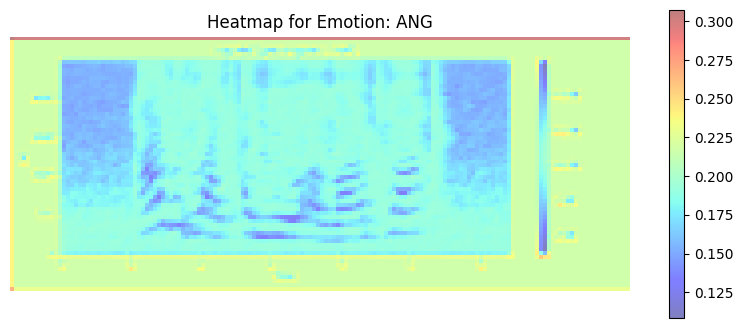

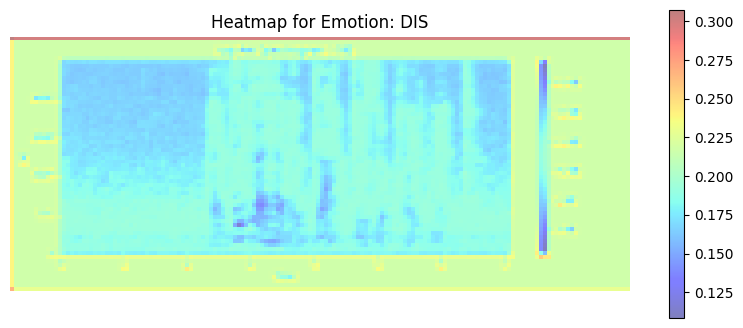

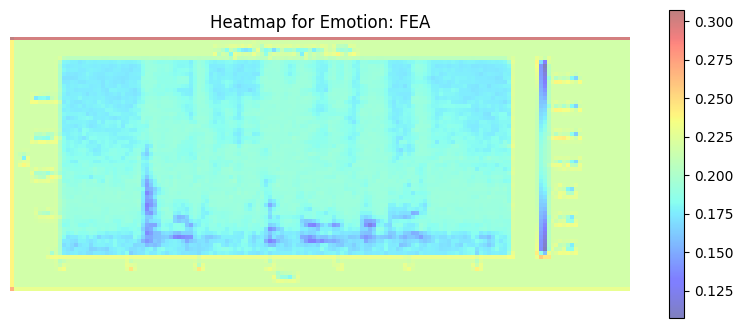

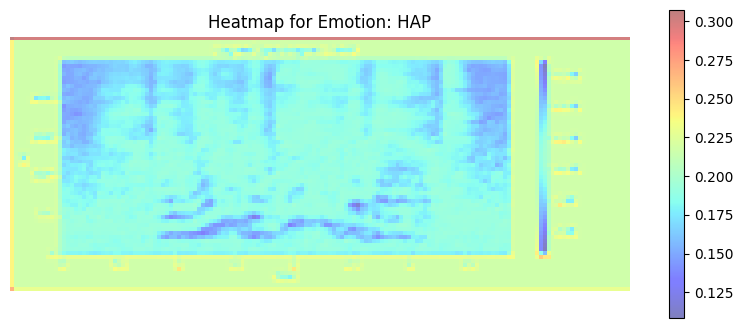

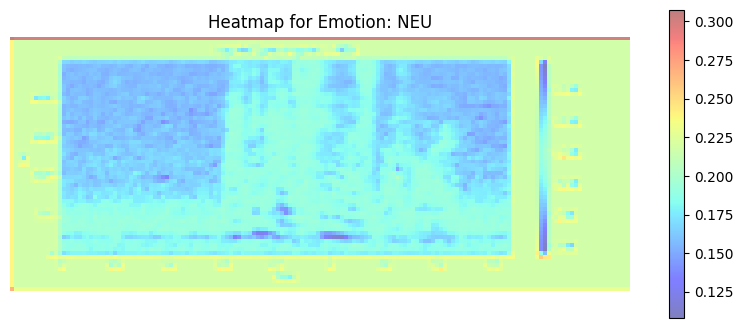

...

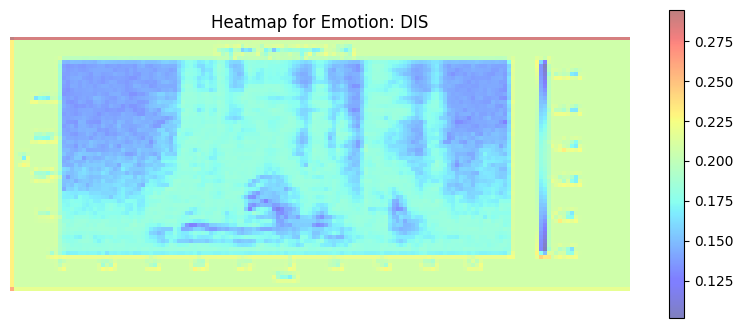

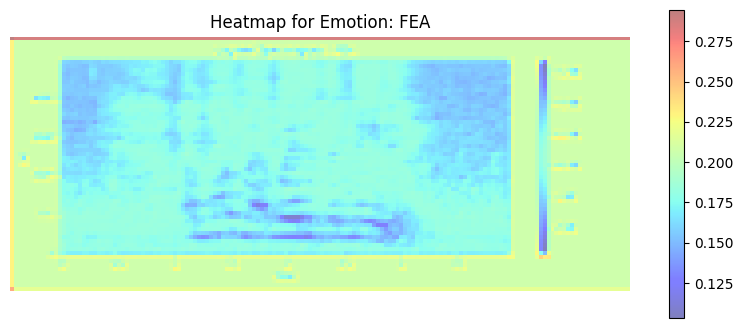

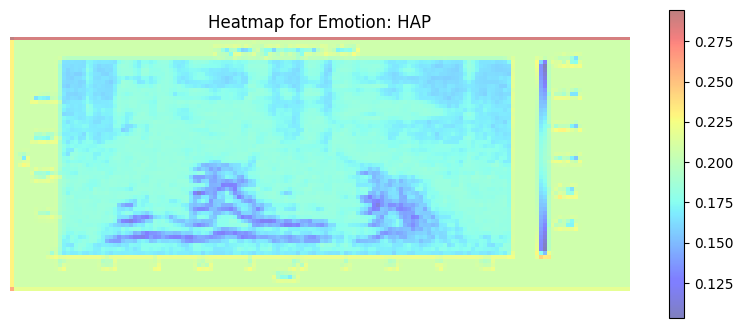

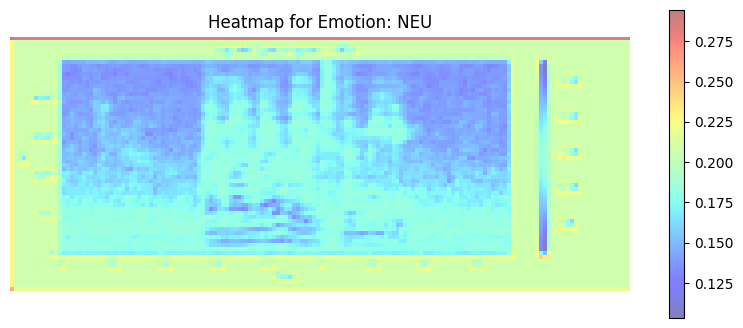

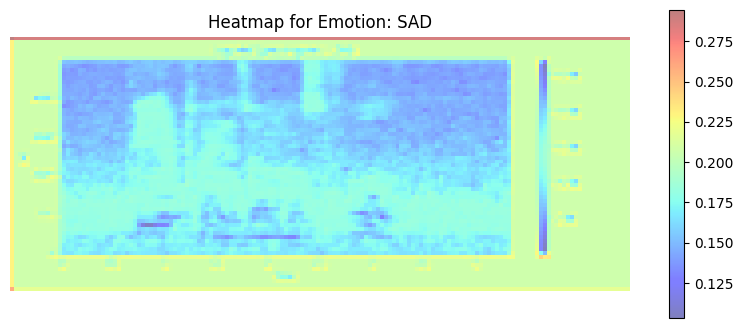

Epoch [1/10], Loss: 31.4364
Epoch [2/10], Loss: 20.0866


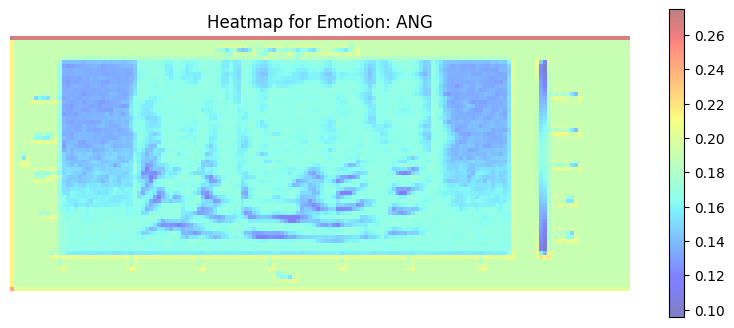

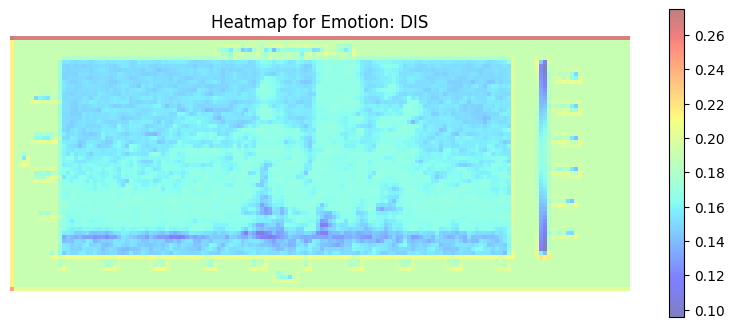

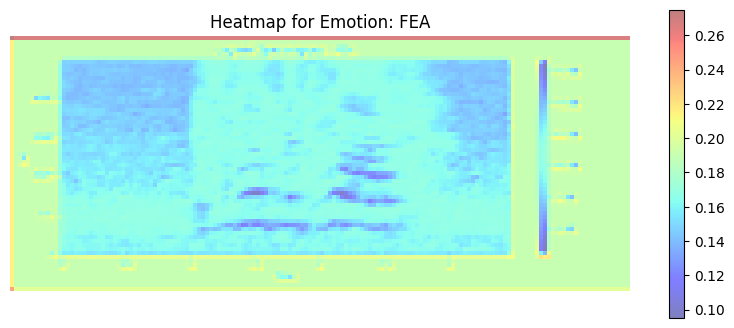

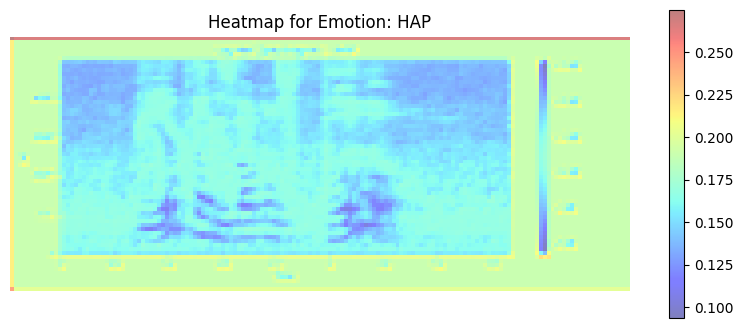

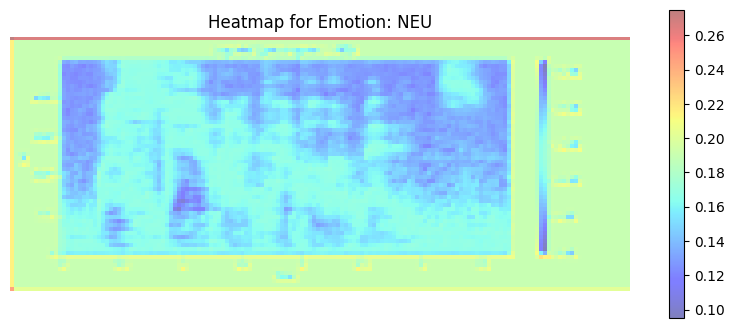

...

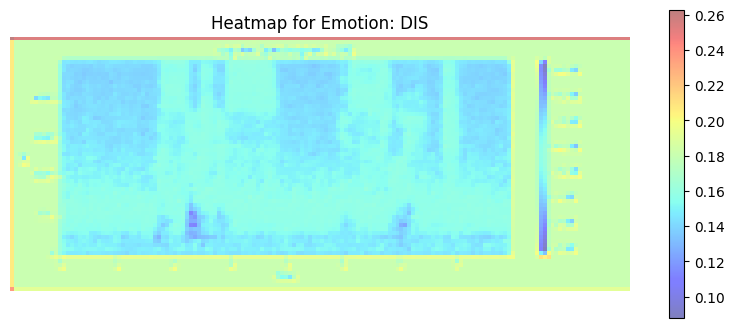

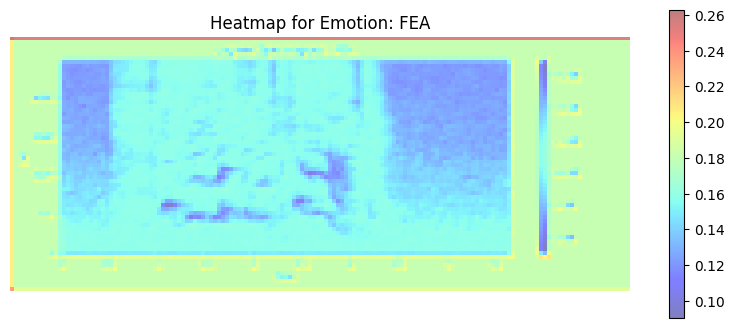

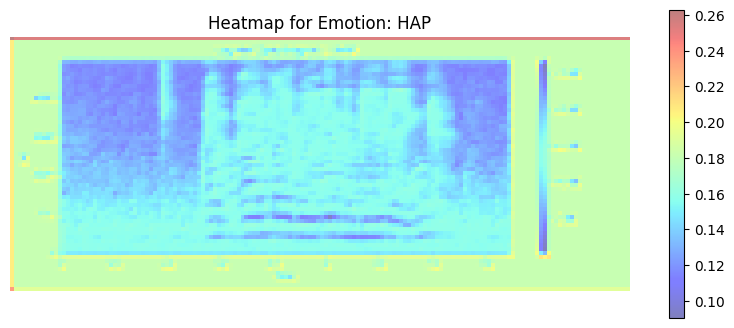

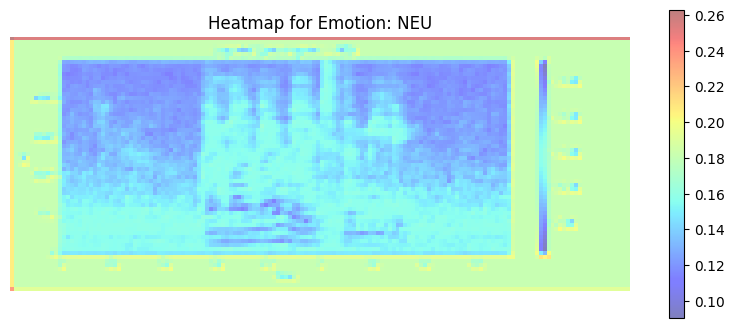

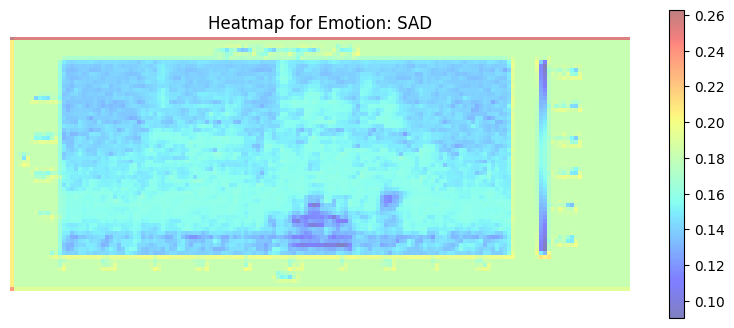

Epoch [3/10], Loss: 23.4859
Epoch [4/10], Loss: 22.5067


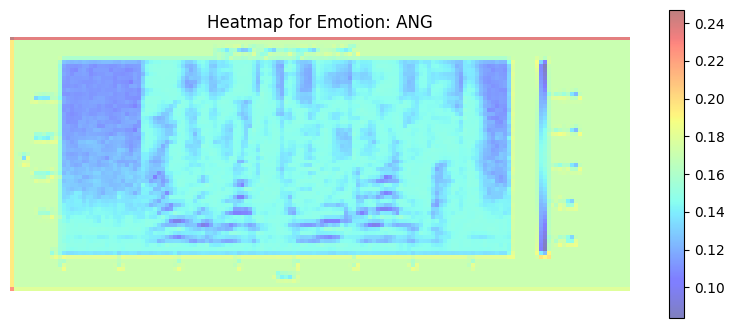

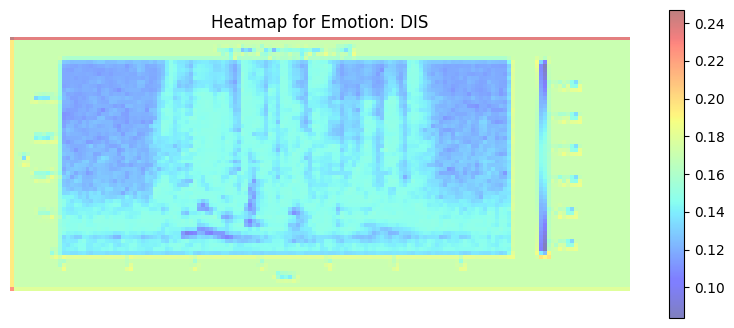

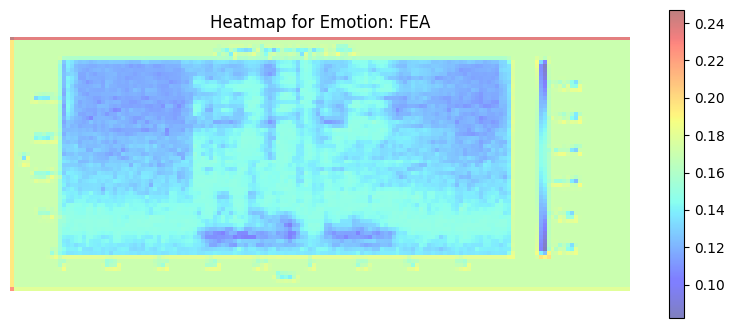

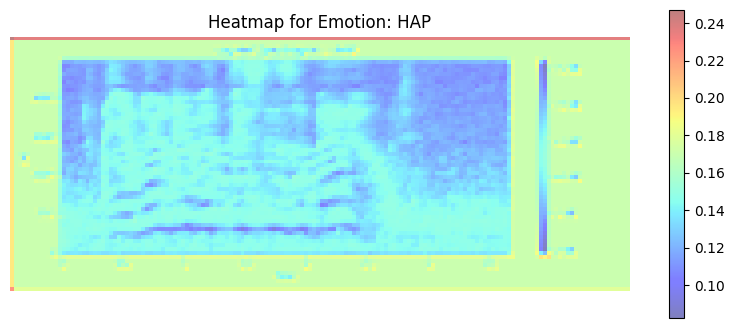

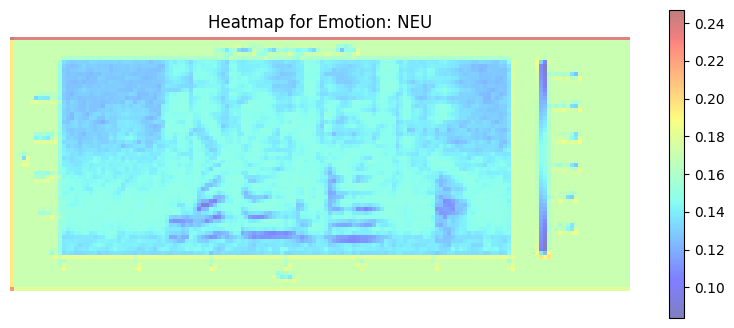

...

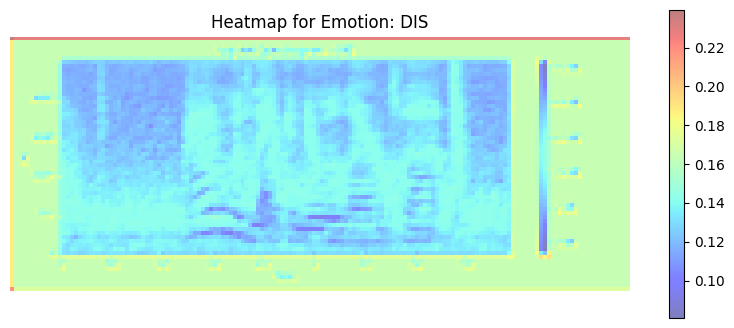

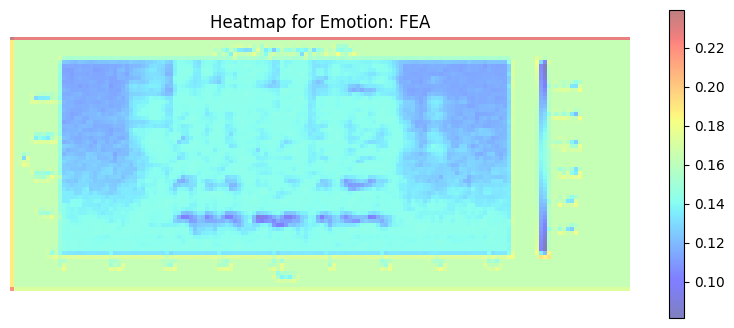

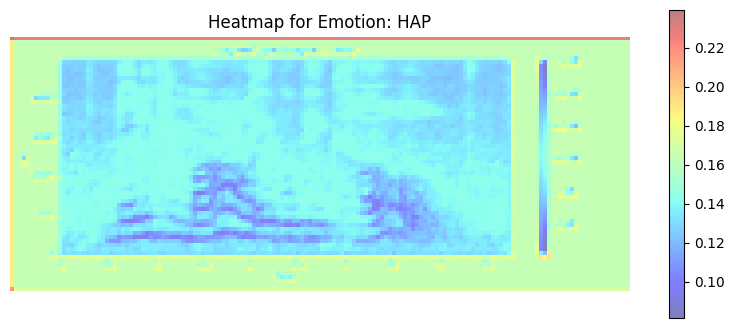

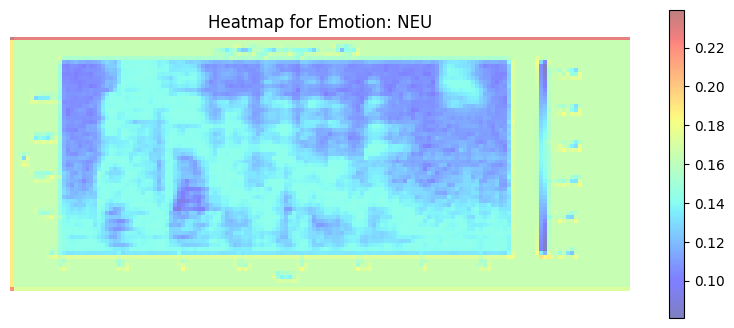

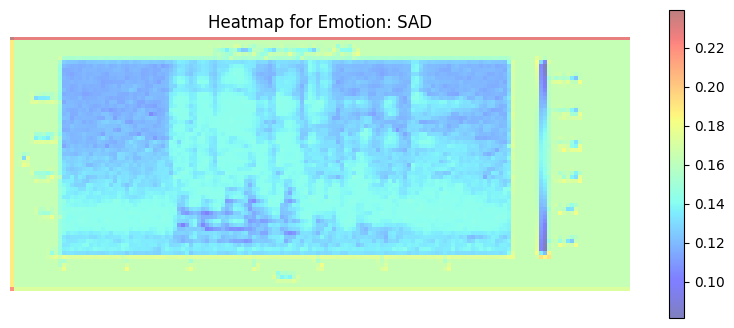

Epoch [5/10], Loss: 5.6518
Epoch [6/10], Loss: 6.9920


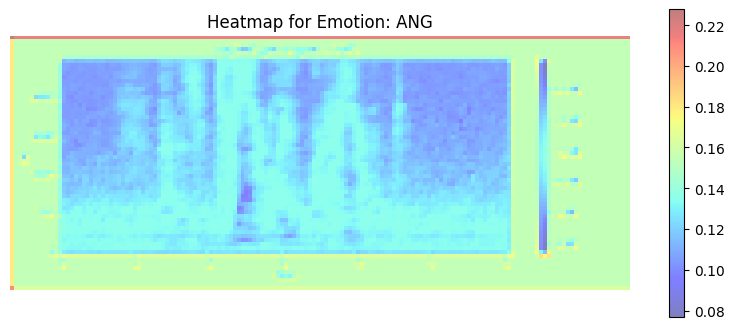

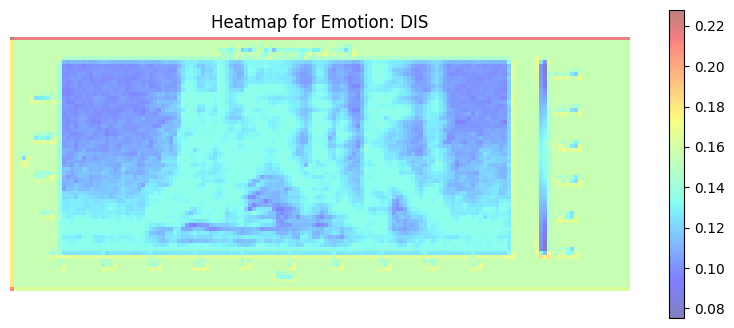

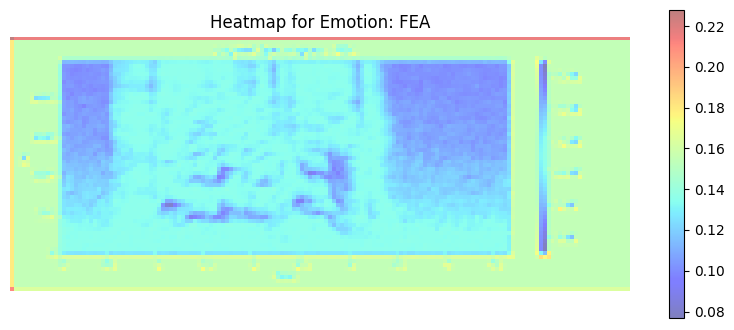

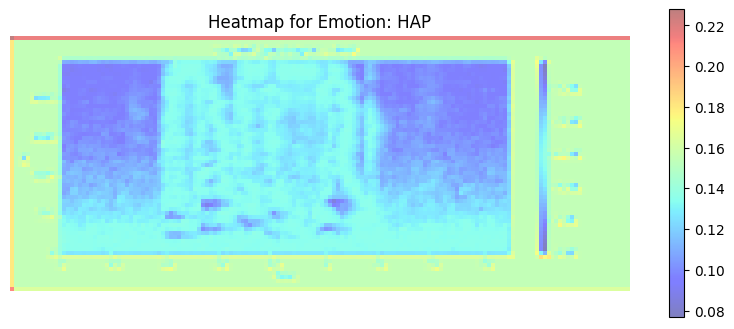

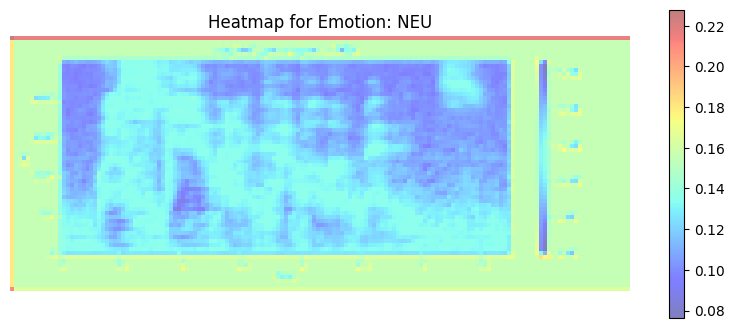

...

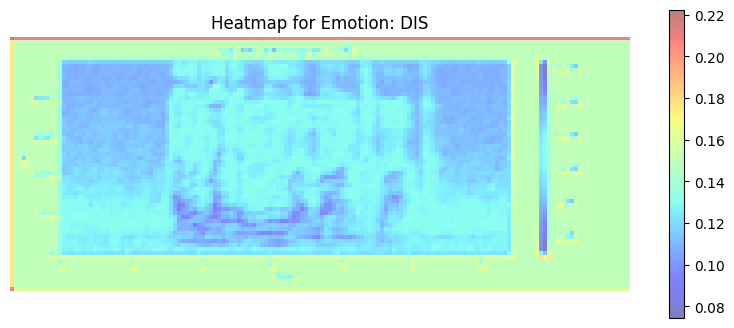

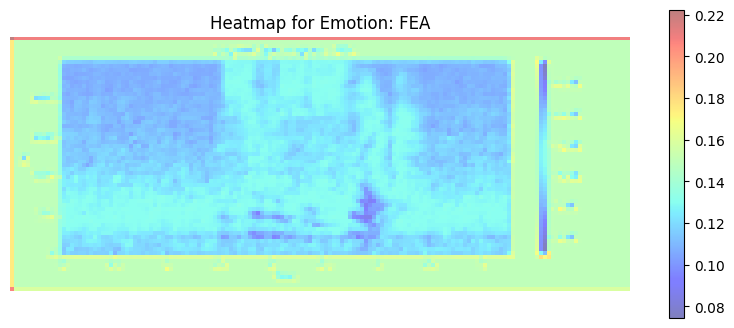

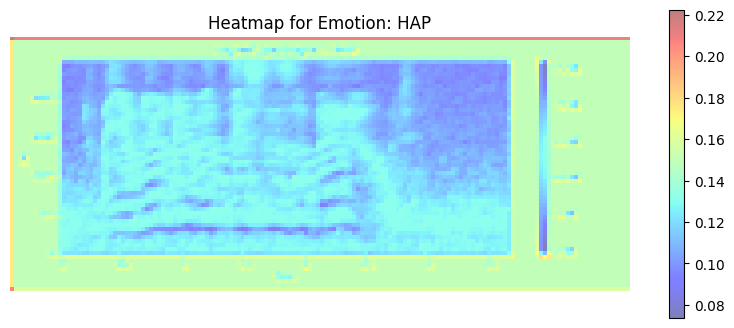

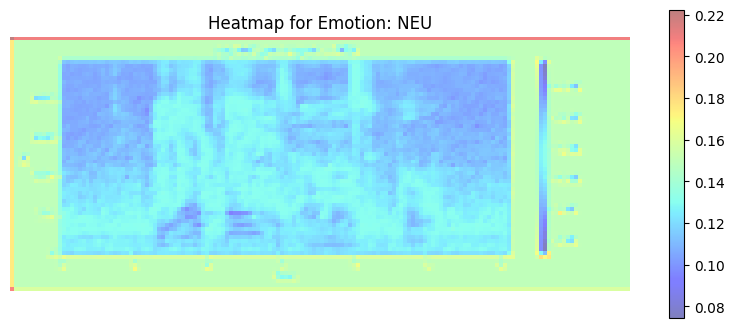

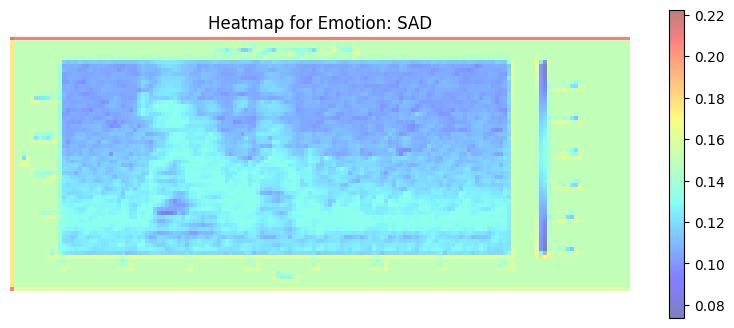

Epoch [7/10], Loss: 7.8026
Epoch [8/10], Loss: 3.4619


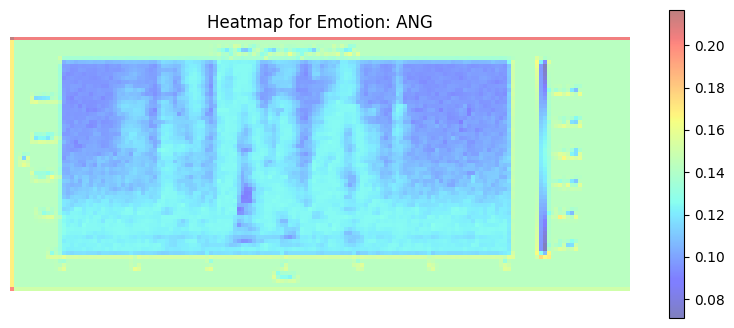

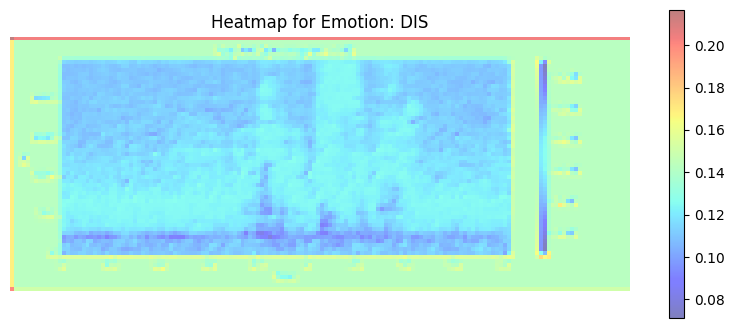

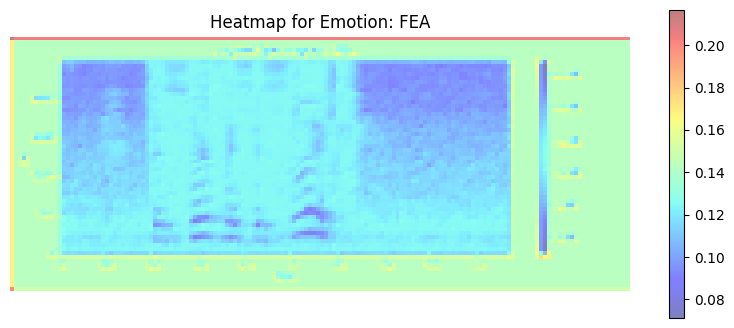

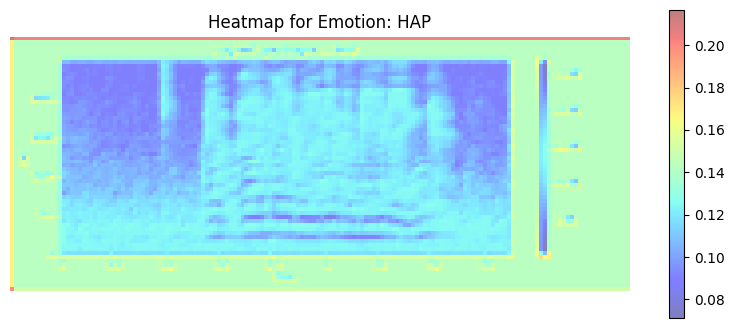

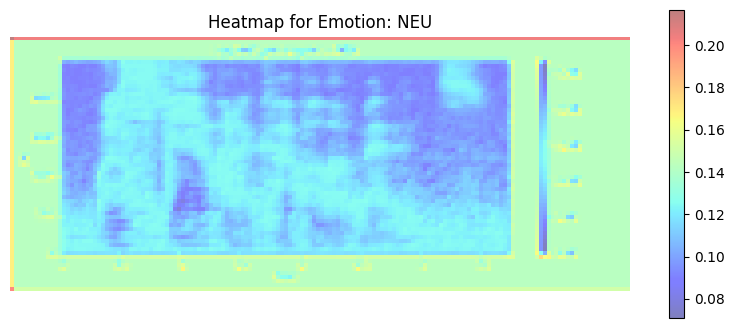

...

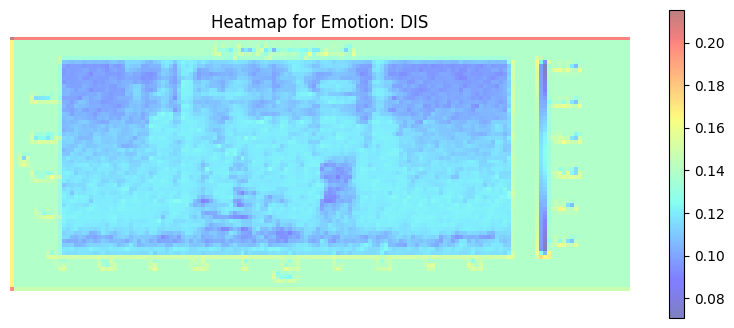

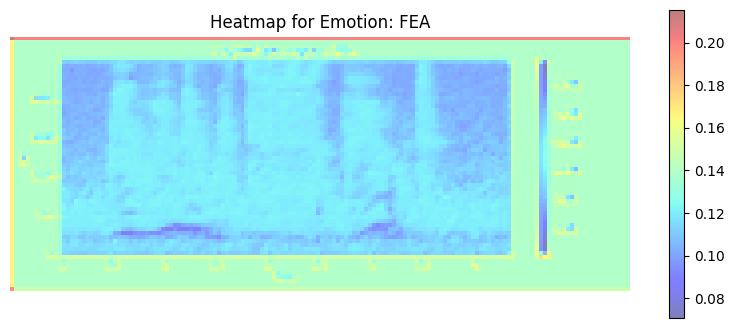

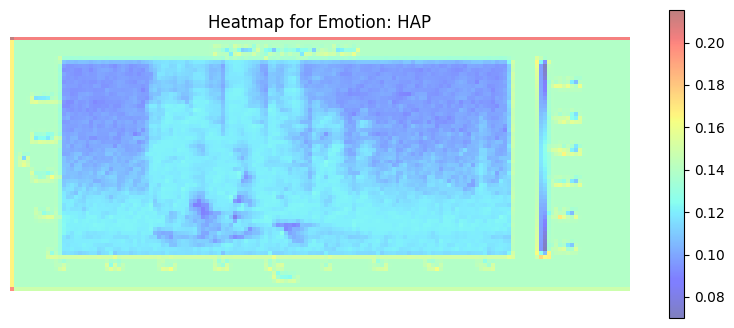

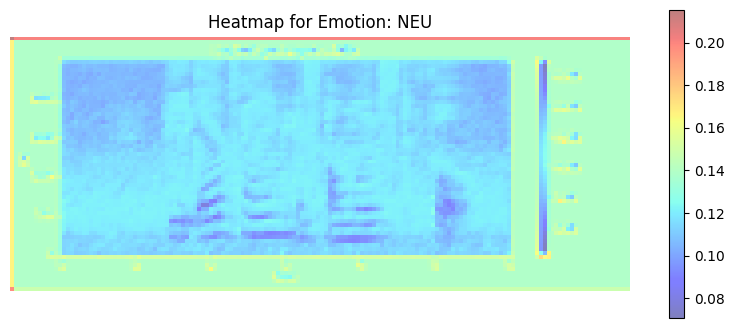

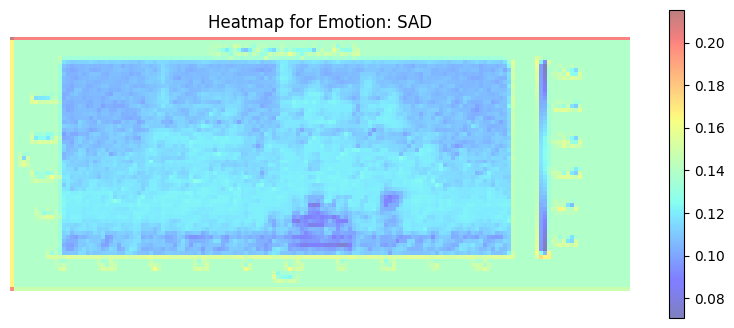

Epoch [9/10], Loss: 1.6628
Epoch [10/10], Loss: 2.7035
Accuracy: 15.00%
Modelo guardado.


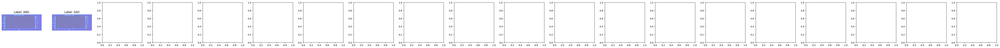

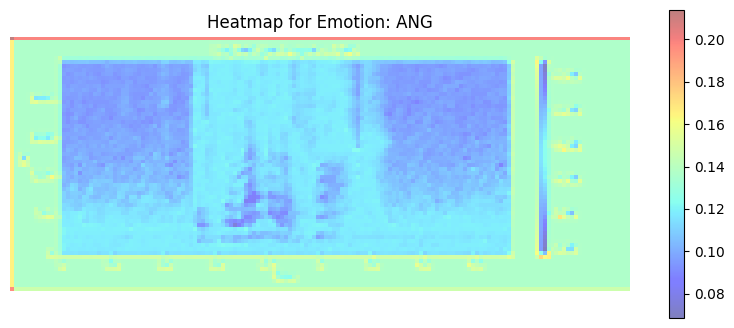

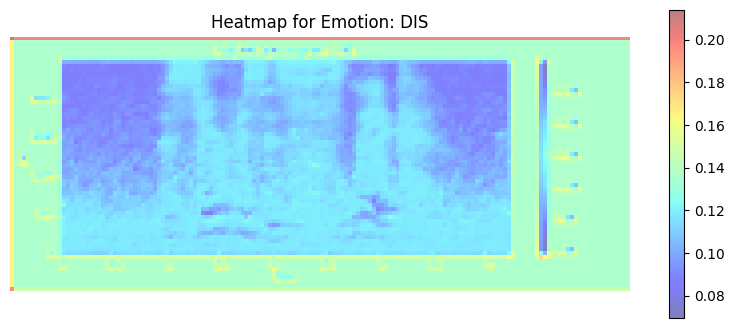

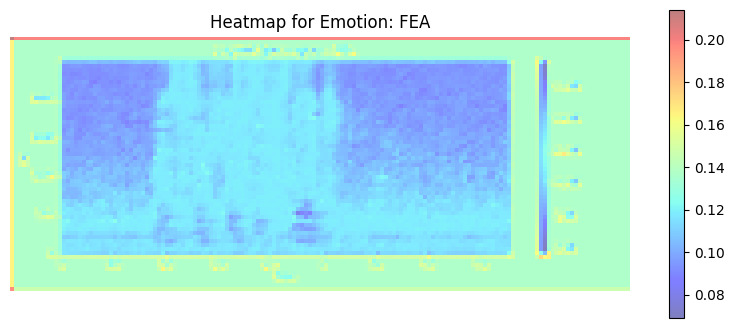

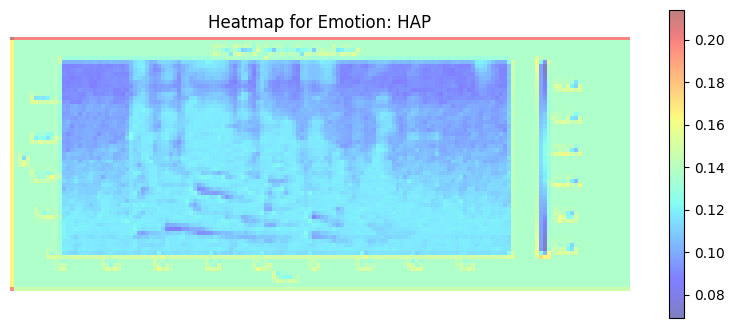

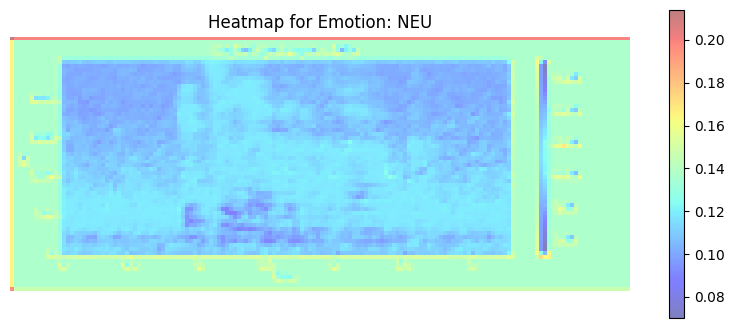

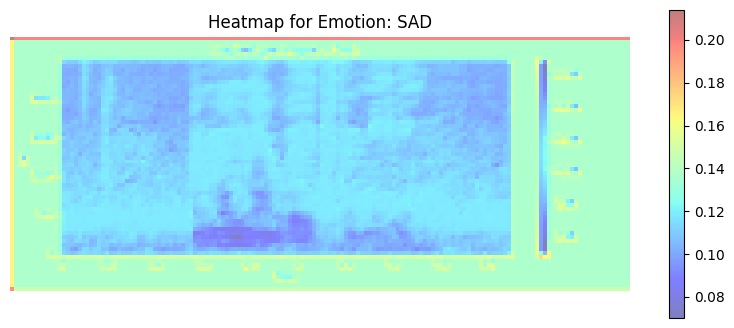

Visualización completada.


In [ ]:
import os
import pandas as pd
import torch
import torch.nn as nn
import torch.optim as optim
from torchvision import transforms
from torch.utils.data import Dataset, DataLoader, random_split
from PIL import Image
from sklearn.metrics import accuracy_score
import matplotlib.pyplot as plt
import numpy as np

# 0. Definir el ConvolutionalStem
class ConvolutionalStem(nn.Module):
    def __init__(self):
        super(ConvolutionalStem, self).__init__()
        self.conv1 = nn.Conv2d(1, 16, kernel_size=3, stride=1, padding=1)
        self.relu = nn.ReLU()
        self.pool = nn.MaxPool2d(kernel_size=2, stride=2)

    def forward(self, x):
        x = self.conv1(x)
        x = self.relu(x)
        x = self.pool(x)
        return x

# 1. Definir el dataset
class SpectrogramDataset(Dataset):
    def __init__(self, metadata_file, spectrogram_dir, transform=None):
        self.metadata = pd.read_csv(metadata_file)
        self.spectrogram_dir = spectrogram_dir
        self.transform = transform

    def __len__(self):
        return len(self.metadata)

    def __getitem__(self, idx):
        img_path = os.path.join(self.spectrogram_dir, self.metadata.iloc[idx]['id'])
        emotion = self.metadata.iloc[idx]['emotion']

        # Cargar la imagen
        image = Image.open(img_path).convert('L')
        if self.transform:
            image = self.transform(image)

        label = valid_emotions.index(emotion)
        return image, label

# 2. Definir el modelo (Vision Transformer)
class VisionTransformer(nn.Module):
    def __init__(self, num_classes=6):
        super(VisionTransformer, self).__init__()
        self.convolutional_stem = ConvolutionalStem()

        # Determinar el tamaño de entrada dinámicamente
        dummy_input = torch.randn(1, 1, 128, 313)
        dummy_output = self.convolutional_stem(dummy_input)
        self.fc_input_size = dummy_output.view(dummy_output.size(0), -1).shape[1]

        self.fc = nn.Linear(self.fc_input_size, num_classes)

    def forward(self, x):
        x = self.convolutional_stem(x)
        x = x.view(x.size(0), -1)
        x = self.fc(x)
        return x

    def get_activations(self, x):
        x = self.convolutional_stem(x)
        return x  # Devuelve las activaciones de la capa convolucional

# 3. Definir la función de entrenamiento
def train_model_with_visualization(model, dataloader, criterion, optimizer, num_epochs=10):
    model.train()
    for epoch in range(num_epochs):
        for images, labels in dataloader:
            optimizer.zero_grad()
            outputs = model(images)
            loss = criterion(outputs, labels)
            loss.backward()
            optimizer.step()

            # Visualización de mapas de calor para una emoción específica
            if epoch % 2 == 0:  # Visualiza cada 2 épocas
                plot_heatmaps_for_all_emotions(model, dataloader)

        print(f'Epoch [{epoch + 1}/{num_epochs}], Loss: {loss.item():.4f}')

# 4. Configurar transformaciones y datos
transform = transforms.Compose([
    transforms.Resize((128, 313)),
    transforms.ToTensor(),
])

# 5. Crear el dataset
dataset = SpectrogramDataset(metadata_file='metadata.csv',
                             spectrogram_dir='spectrograms',
                             transform=transform)

# 6. Dividir el dataset en entrenamiento y validación
train_size = int(0.8 * len(dataset))
val_size = len(dataset) - train_size
train_dataset, val_dataset = random_split(dataset, [train_size, val_size])

# 7. Crear DataLoaders para entrenamiento y validación
train_dataloader = DataLoader(train_dataset, batch_size=16, shuffle=True)
val_dataloader = DataLoader(val_dataset, batch_size=16, shuffle=False)

# 8. Inicializar el modelo, criterio y optimizador
model = VisionTransformer(num_classes=len(valid_emotions))
criterion = nn.CrossEntropyLoss()
optimizer = optim.Adam(model.parameters(), lr=0.001)

# 9. Entrenar el modelo
train_model_with_visualization(model, train_dataloader, criterion, optimizer, num_epochs=10)

# 10. Evaluar el modelo
def evaluate_model(model, dataloader):
    model.eval()
    all_labels = []
    all_preds = []
    with torch.no_grad():
        for images, labels in dataloader:
            outputs = model(images)
            _, predicted = torch.max(outputs.data, 1)
            all_labels.extend(labels.numpy())
            all_preds.extend(predicted.numpy())

    accuracy = accuracy_score(all_labels, all_preds)
    print(f'Accuracy: {accuracy * 100:.2f}%')

# ... (toda la parte anterior de tu código)

# 11. Evaluar el modelo en el conjunto de validación
evaluate_model(model, val_dataloader)

# 12. Guardar el modelo entrenado
torch.save(model.state_dict(), 'modelo_entrenado.pth')
print("Modelo guardado.")

# 13. Función para visualizar todos los mapas de calor en un solo cuadro
def plot_heatmaps_all(model, dataloader):
    model.eval()
    num_samples = len(dataloader.dataset)
    fig, axes = plt.subplots(nrows=1, ncols=num_samples, figsize=(num_samples * 3, 3))

    with torch.no_grad():
        for i, (images, labels) in enumerate(dataloader):
            # Get the activations for the first image in the batch
            activations = model.get_activations(images)

            # Calculate the heatmap
            heatmap = activations.squeeze().cpu().numpy()
            heatmap = np.mean(heatmap, axis=0)

            # Visualize
            axes[i].imshow(heatmap, cmap='jet', alpha=0.5)
            axes[i].set_title(f'Label: {labels[0]}')  # Directly using the label
            axes[i].axis('off')

    plt.tight_layout()
    plt.show()



# 14. Visualizar todos los mapas de calor
def plot_heatmaps_all(model, dataloader):
    model.eval()
    num_samples = len(dataloader.dataset)
    fig, axes = plt.subplots(nrows=1, ncols=num_samples, figsize=(num_samples * 3, 3))

    with torch.no_grad():
        for i, (images, labels) in enumerate(dataloader):
            # Obtener las activaciones para la primera imagen en el batch
            activations = model.get_activations(images)

            # Promediar las activaciones a través del batch
            heatmap = activations.mean(dim=0).squeeze().cpu().numpy()

            # Comprobar si el mapa de calor es 2D
            if heatmap.ndim != 2:
                heatmap = heatmap[0]  # Suponiendo que tienes un mapa de calor con una dimensión adicional

            # Visualizar
            axes[i].imshow(heatmap, cmap='jet', alpha=0.5)
            axes[i].set_title(f'Label: {valid_emotions[labels[0]]}')  # Usar la etiqueta
            axes[i].axis('off')

    plt.tight_layout()
    plt.show()

# Llama a la función
plot_heatmaps_all(model, val_dataloader)


# 15. Visualizar mapas de calor por emoción en subplots
# 15. Visualizar mapas de calor por cada emoción
def plot_heatmaps_for_all_emotions(model, dataloader):
    model.eval()  # Cambia a modo de evaluación
    with torch.no_grad():  # Desactiva el cálculo de gradientes
        for target_emotion in valid_emotions:  # Itera sobre todas las emociones
            found = False  # Bandera para indicar si encontramos la emoción
            for images, labels in dataloader:  # Itera sobre el dataloader
                for i in range(len(labels)):  # Recorre las etiquetas en el batch
                    # Comprobar si la etiqueta coincide con la emoción objetivo
                    if valid_emotions[labels[i]] == target_emotion:
                        activations = model.get_activations(images[i].unsqueeze(0))  # Obtener activaciones
                        heatmap = activations.squeeze().cpu().numpy()  # Procesar activaciones
                        heatmap = np.mean(heatmap, axis=0)  # Calcular el mapa de calor

                        # Visualizar el mapa de calor
                        plt.figure(figsize=(10, 4))
                        plt.imshow(heatmap, cmap='jet', alpha=0.5)
                        plt.title(f'Heatmap for Emotion: {target_emotion}')
                        plt.axis('off')
                        plt.colorbar()
                        plt.show()

                        found = True  # Marcamos que encontramos la emoción
                        break  # Salimos del bucle interno

                if found:
                    break  # Salimos del bucle externo si ya mostramos el mapa de calor

# Llama a la función para visualizar mapas de calor para todas las emociones
plot_heatmaps_for_all_emotions(model, val_dataloader)

print("Visualización completada.")

In [ ]:
import os
import pandas as pd
import torch
import torch.nn as nn
import torch.optim as optim
from torchvision import transforms
from torch.utils.data import Dataset, DataLoader, random_split
from PIL import Image
from sklearn.metrics import accuracy_score
# 2 Parametros de almacenamiento

valid_emotions = ['ANG', 'DIS', 'FEA', 'HAP', 'NEU', 'SAD']

# 0. Definir el ConvolutionalStem
class ConvolutionalStem(nn.Module):
    def __init__(self):
        super(ConvolutionalStem, self).__init__()
        self.conv1 = nn.Conv2d(1, 16, kernel_size=3, stride=1, padding=1)
        self.relu = nn.ReLU()
        self.pool = nn.MaxPool2d(kernel_size=2, stride=2)

    def forward(self, x):
        x = self.conv1(x)
        x = self.relu(x)
        x = self.pool(x)
        return x

# 1. Definir el dataset
class SpectrogramDataset(Dataset):
    def __init__(self, metadata_file, spectrogram_dir, transform=None):
        self.metadata = pd.read_csv(metadata_file)
        self.spectrogram_dir = spectrogram_dir  # Store the directory of spectrograms
        self.transform = transform

    def __len__(self):
        return len(self.metadata)

    def __getitem__(self, idx):
        img_path = os.path.join(self.spectrogram_dir, self.metadata.iloc[idx]['id'])  # Join with spectrogram dir
        emotion = self.metadata.iloc[idx]['emotion']

        # Cargar la imagen
        image = Image.open(img_path).convert('L')  # Convertir a escala de grises
        if self.transform:
            image = self.transform(image)

        # Convertir la etiqueta a un índice
        label = valid_emotions.index(emotion)
        return image, label

# 2. Definir el modelo (Vision Transformer)
class VisionTransformer(nn.Module):
    def __init__(self, num_classes=6):
        super(VisionTransformer, self).__init__()
        self.convolutional_stem = ConvolutionalStem()  # Define tu ConvolutionalStem aquí

        # Determinar el tamaño de entrada dinámicamente
        dummy_input = torch.randn(1, 1, 128, 313)  # Cambia según las dimensiones de tus espectrogramas
        dummy_output = self.convolutional_stem(dummy_input)
        self.fc_input_size = dummy_output.view(dummy_output.size(0), -1).shape[1]

        self.fc = nn.Linear(self.fc_input_size, num_classes)

    def forward(self, x):
        x = self.convolutional_stem(x)
        x = x.view(x.size(0), -1)  # Flatten
        x = self.fc(x)
        return x

# 3. Definir la función de entrenamiento
def train_model(model, dataloader, criterion, optimizer, num_epochs=10):
    model.train()
    for epoch in range(num_epochs):
        for images, labels in dataloader:
            optimizer.zero_grad()
            outputs = model(images)
            loss = criterion(outputs, labels)
            loss.backward()
            optimizer.step()

        print(f'Epoch [{epoch + 1}/{num_epochs}], Loss: {loss.item():.4f}')

# 4. Configurar transformaciones y datos
transform = transforms.Compose([
    transforms.Resize((128, 313)),  # Ajusta al tamaño que necesita tu modelo
    transforms.ToTensor(),            # Convierte a tensor
])

# 5. Crear el dataset
dataset = SpectrogramDataset(metadata_file='metadata.csv',
                             spectrogram_dir='spectrograms',  # Pass the spectrogram directory
                             transform=transform)

# 6. Dividir el dataset en entrenamiento y validación
train_size = int(0.8 * len(dataset))  # 80% para entrenamiento
val_size = len(dataset) - train_size   # 20% para validación
train_dataset, val_dataset = random_split(dataset, [train_size, val_size])

# 7. Crear DataLoaders para entrenamiento y validación
train_dataloader = DataLoader(train_dataset, batch_size=16, shuffle=True)
val_dataloader = DataLoader(val_dataset, batch_size=16, shuffle=False)

# 8. Inicializar el modelo, criterio y optimizador
model = VisionTransformer(num_classes=len(valid_emotions))
criterion = nn.CrossEntropyLoss()
optimizer = optim.Adam(model.parameters(), lr=0.001)

# 9. Entrenar el modelo
train_model(model, train_dataloader, criterion, optimizer, num_epochs=10)

# 10. Evaluar el modelo
def evaluate_model(model, dataloader):
    model.eval()
    all_labels = []
    all_preds = []
    with torch.no_grad():
        for images, labels in dataloader:
            outputs = model(images)
            _, predicted = torch.max(outputs.data, 1)
            all_labels.extend(labels.numpy())
            all_preds.extend(predicted.numpy())

    accuracy = accuracy_score(all_labels, all_preds)
    print(f'Accuracy: {accuracy * 100:.2f}%')

# 11. Evaluar el modelo en el conjunto de validación
evaluate_model(model, val_dataloader)

print("Entrenamiento y evaluación completados.")


Epoch [1/10], Loss: 11.6930
Epoch [2/10], Loss: 14.9894
Epoch [3/10], Loss: 4.1919
Epoch [4/10], Loss: 8.7288
Epoch [5/10], Loss: 2.4585
Epoch [6/10], Loss: 3.4287
Epoch [7/10], Loss: 2.8454
Epoch [8/10], Loss: 1.9309
Epoch [9/10], Loss: 1.6972
Epoch [10/10], Loss: 1.3908
Accuracy: 15.00%
Entrenamiento y evaluación completados.


In [ ]:
import os
import pandas as pd
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import Dataset, DataLoader, random_split
from torchvision import transforms
from PIL import Image
import numpy as np


# 1. Definir el dataset para prosodia
class ProsodyDataset(Dataset):
    def __init__(self, prosody_file, metadata_file):
        self.prosody_data = pd.read_csv(prosody_file)
        self.metadata = pd.read_csv(metadata_file)
        self.metadata.dropna(subset=['emotion'], inplace=True)
        self.emotions = self.metadata['emotion'].unique()

        # Crear un diccionario para mapear IDs a emociones
        self.id_to_emotion = dict(zip(self.metadata['id'], self.metadata['emotion']))

    def __len__(self):
        return len(self.prosody_data)

    def __getitem__(self, idx):
        # Cargar características de prosodia
        prosody_features = self.prosody_data.iloc[idx, :].values.astype(np.float32)
        # Obtener el ID y la emoción correspondiente
        prosody_id = self.prosody_data.iloc[idx]['id']
        label = self.id_to_emotion[prosody_id]
        label_idx = np.where(self.emotions == label)[0][0]
        return prosody_features, label_idx

# 2. Cargar el modelo entrenado de espectrogramas
model_path = 'modelo_entrenado.pth'
base_model = VisionTransformer(num_classes=len(valid_emotions))
base_model.load_state_dict(torch.load(model_path, weights_only=True))
base_model.eval()  # Modo de evaluación

# 3. Crear el dataset y DataLoader para prosodia
prosody_dataset = ProsodyDataset(prosody_file='metadata_opensmile.csv',
                                 metadata_file='metadata.csv')
prosody_dataloader = DataLoader(prosody_dataset, batch_size=16, shuffle=True)

# 4. Ejemplo de evaluación del modelo en los datos de prosodia
def evaluate_prosody_model(model, dataloader):
    model.eval()
    all_labels = []
    all_preds = []
    with torch.no_grad():
        for prosody_features, labels in dataloader:
            outputs = model(prosody_features)  # Asegúrate de que el modelo sea compatible con prosody_features
            _, predicted = torch.max(outputs.data, 1)
            all_labels.extend(labels.numpy())
            all_preds.extend(predicted.numpy())

    accuracy = accuracy_score(all_labels, all_preds)
    print(f'Accuracy on Prosody Dataset: {accuracy * 100:.2f}%')

# 5. Evaluar el modelo en el conjunto de prosodia
evaluate_prosody_model(base_model, prosody_dataloader)


# 6. Dividir el dataset en entrenamiento y validación
train_size = int(0.8 * len(dataset))
val_size = len(dataset) - train_size
train_dataset, val_dataset = random_split(dataset, [train_size, val_size])

# 7. Crear DataLoaders para entrenamiento y validación
train_dataloader = DataLoader(train_dataset, batch_size=16, shuffle=True)
val_dataloader = DataLoader(val_dataset, batch_size=16, shuffle=False)

# 8. Inicializar el modelo, criterio y optimizador
model = VisionTransformer(num_classes=len(valid_emotions))
criterion = nn.CrossEntropyLoss()
optimizer = optim.Adam(model.parameters(), lr=0.001)

# 9. Entrenar el modelo
train_model(model, train_dataloader, criterion, optimizer, num_epochs=10)

# 10. Evaluar el modelo
def evaluate_model(model, dataloader):
    model.eval()
    all_labels = []
    all_preds = []
    with torch.no_grad():
        for images, labels in dataloader:
            outputs = model(images)
            _, predicted = torch.max(outputs.data, 1)
            all_labels.extend(labels.numpy())
            all_preds.extend(predicted.numpy())

    accuracy = accuracy_score(all_labels, all_preds)
    print(f'Accuracy: {accuracy * 100:.2f}%')

# Evaluar el modelo en el conjunto de validación
evaluate_model(model, val_dataloader)

# Guardar el modelo entrenado
torch.save(model.state_dict(), 'modelo_entrenado.pth')
print("Modelo guardado.")

# 11. Definir el dataset para prosodia
class ProsodyDataset(Dataset):
    def __init__(self, prosody_file, metadata_file):
        self.prosody_data = pd.read_csv(prosody_file)
        self.metadata = pd.read_csv(metadata_file)
        self.metadata.dropna(subset=['emotion'], inplace=True)  # Asegúrate de que no haya NaN
        self.emotions = self.metadata['emotion'].unique()

        # Crear un diccionario para mapear IDs a emociones
        self.id_to_emotion = dict(zip(self.metadata['id'], self.metadata['emotion']))

    def __len__(self):
        return len(self.prosody_data)

    def __getitem__(self, idx):
        # Cargar características de prosodia
        prosody_features = self.prosody_data.iloc[idx, :].values.astype(np.float32)  # Ajusta según el CSV
        # Obtener el ID y la emoción correspondiente
        prosody_id = self.prosody_data.iloc[idx]['id']  # Asumiendo que hay una columna 'id' en prosody_data
        label = self.id_to_emotion[prosody_id]
        label_idx = np.where(self.emotions == label)[0][0]  # Obtener índice de la emoción
        return prosody_features, label_idx

# 12. Crear el dataset y DataLoader para prosodia
prosody_dataset = ProsodyDataset(prosody_file='metadata_opensmile.csv',
                                 metadata_file='metadata.csv')
prosody_dataloader = DataLoader(prosody_dataset, batch_size=16, shuffle=True)


# 13. Cargar el modelo entrenado de espectrogramas
model_path = 'modelo_entrenado.pth'
base_model = VisionTransformer(num_classes=len(valid_emotions))
base_model.load_state_dict(torch.load(model_path))
base_model.eval()  # Modo de evaluación para evitar el cálculo de gradientes

# 14. Crear el dataset y DataLoader para prosodia
prosody_dataset = ProsodyDataset(metadata_file='metadata_opensmile.csv')
prosody_dataloader = DataLoader(prosody_dataset, batch_size=16, shuffle=True)

# 15. Crear el modelo para prosodia
prosody_model = ProsodyModel(base_model, num_classes=len(prosody_dataset.emotions))

# 16. Configurar el criterio y optimizador
criterion = nn.CrossEntropyLoss()
optimizer = torch.optim.Adam(prosody_model.parameters(), lr=0.001)

# 17. Función de entrenamiento para prosodia
def train_prosody_model(model, dataloader, criterion, optimizer, num_epochs=10):
    model.train()
    for epoch in range(num_epochs):
        for features, labels in dataloader:
            optimizer.zero_grad()
            outputs = model(features)
            loss = criterion(outputs, labels)
            loss.backward()
            optimizer.step()
        print(f'Epoch [{epoch + 1}/{num_epochs}], Loss: {loss.item():.4f}')

# 18. Entrenar el modelo de prosodia
train_prosody_model(prosody_model, prosody_dataloader, criterion, optimizer, num_epochs=10)

# 19. Evaluar el modelo de prosodia (opcional)


KeyError: 'id'

In [ ]:
import os
import pandas as pd
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import Dataset, DataLoader, random_split
import numpy as np
from sklearn.metrics import accuracy_score

# 1. Definir el dataset para prosodia
class ProsodyDataset(Dataset):
    def __init__(self, prosody_file, metadata_file):
        self.prosody_data = pd.read_csv(prosody_file)
        self.metadata = pd.read_csv(metadata_file)
        self.metadata.dropna(subset=['emotion'], inplace=True)
        self.emotions = self.metadata['emotion'].unique()

        # Crear un diccionario para mapear IDs a emociones
        self.id_to_emotion = dict(zip(self.metadata['id'], self.metadata['emotion']))

    def __len__(self):
        return len(self.prosody_data)

    def __getitem__(self, idx):
        # Cargar características de prosodia
        prosody_features = self.prosody_data.iloc[idx, :].values.astype(np.float32)
        # Obtener el ID y la emoción correspondiente
        prosody_id = self.prosody_data.iloc[idx]['id']
        label = self.id_to_emotion.get(prosody_id, -1)  # Manejo de casos donde el ID no se encuentra
        if label == -1:
            raise ValueError(f'ID {prosody_id} no encontrado en la metadata.')
        label_idx = np.where(self.emotions == label)[0][0]
        return prosody_features, label_idx

# 2. Definir el modelo (ejemplo simple)
class VisionTransformer(nn.Module):
    def __init__(self, num_classes):
        super(VisionTransformer, self).__init__()
        # Definir tu arquitectura aquí

    def forward(self, x):
        # Definir la propagación hacia adelante aquí
        return x  # Cambia esto según tu implementación

# 3. Cargar el modelo entrenado de espectrogramas
model_path = 'modelo_entrenado.pth'
base_model = VisionTransformer(num_classes=len(valid_emotions))
base_model.load_state_dict(torch.load(model_path))
base_model.eval()  # Modo de evaluación

# 4. Crear el dataset y DataLoader para prosodia
prosody_dataset = ProsodyDataset(prosody_file='metadata_opensmile.csv',
                                 metadata_file='metadata.csv')
prosody_dataloader = DataLoader(prosody_dataset, batch_size=16, shuffle=True)

# 5. Evaluar el modelo en el conjunto de prosodia
def evaluate_prosody_model(model, dataloader):
    model.eval()
    all_labels = []
    all_preds = []
    with torch.no_grad():
        for prosody_features, labels in dataloader:
            outputs = model(prosody_features)
            _, predicted = torch.max(outputs.data, 1)
            all_labels.extend(labels.numpy())
            all_preds.extend(predicted.numpy())

    accuracy = accuracy_score(all_labels, all_preds)
    print(f'Accuracy on Prosody Dataset: {accuracy * 100:.2f}%')

# 6. Evaluar el modelo en el conjunto de prosodia
evaluate_prosody_model(base_model, prosody_dataloader)

# 7. Dividir el dataset en entrenamiento y validación (solo para imágenes)
# Aquí, asegúrate de que `dataset` esté definido correctamente para imágenes.
# train_size = int(0.8 * len(dataset))
# val_size = len(dataset) - train_size
# train_dataset, val_dataset = random_split(dataset, [train_size, val_size])

# 8. Crear DataLoaders para entrenamiento y validación
# train_dataloader = DataLoader(train_dataset, batch_size=16, shuffle=True)
# val_dataloader = DataLoader(val_dataset, batch_size=16, shuffle=False)

# 9. Inicializar el modelo, criterio y optimizador
# model = VisionTransformer(num_classes=len(valid_emotions))
# criterion = nn.CrossEntropyLoss()
# optimizer = optim.Adam(model.parameters(), lr=0.001)

# 10. Entrenar el modelo (solo para imágenes)
# train_model(model, train_dataloader, criterion, optimizer, num_epochs=10)

# 11. Evaluar el modelo
# evaluate_model(model, val_dataloader)

# 12. Guardar el modelo entrenado
# torch.save(model.state_dict(), 'modelo_entrenado.pth')
# print("Modelo guardado.")

# 13. Entrenar el modelo de prosodia (si es necesario)
# Aquí podrías definir otra clase de modelo o usar el mismo, dependiendo de tu caso.
# train_prosody_model(prosody_model, prosody_dataloader, criterion, optimizer, num_epochs=10)

# 14. Evaluar el modelo de prosodia (opcional)


<ipython-input-50-c24eb9b8a48d>:48: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  base_model.load_state_dict(torch.load(model_path))


RuntimeError: Error(s) in loading state_dict for VisionTransformer:
	Unexpected key(s) in state_dict: "convolutional_stem.conv1.weight", "convolutional_stem.conv1.bias", "fc.weight", "fc.bias". 

In [ ]:
import os
import pandas as pd
import torch
import torch.nn as nn
from torch.utils.data import Dataset, DataLoader
from sklearn.metrics import accuracy_score
import numpy as np

# 1. Definir el dataset para prosodia
class ProsodyDataset(Dataset):
    def __init__(self, metadata_file):
        self.metadata = pd.read_csv(metadata_file)
        self.metadata.dropna(subset=['emotion'], inplace=True)  # Eliminar filas sin emoción
        self.emotions = self.metadata['emotion'].unique()

    def __len__(self):
        return len(self.metadata)

    def __getitem__(self, idx):
        # Cargar características de prosodia
        prosody_features = self.metadata.iloc[idx, 2:-1].values.astype(np.float32)  # Ajusta según tu CSV
        label = self.metadata.iloc[idx]['emotion']
        return prosody_features, label

# 2. Definir el modelo (usar el modelo original)
class VisionTransformer(nn.Module):
    # Define la arquitectura como lo hiciste anteriormente...

# 3. Cargar el modelo previamente entrenado
def load_trained_model(model_path, num_classes):
    model = VisionTransformer(num_classes)
    model.load_state_dict(torch.load(model_path))
    model.eval()
    return model

# 4. Función para evaluar el modelo en el conjunto de prosodia
def evaluate_prosody_model(model, dataloader):
    all_labels = []
    all_preds = []
    with torch.no_grad():
        for prosody_features, labels in dataloader:
            outputs = model(prosody_features)
            _, predicted = torch.max(outputs, 1)
            all_labels.extend(labels.numpy())
            all_preds.extend(predicted.numpy())

    accuracy = accuracy_score(all_labels, all_preds)
    print(f'Accuracy en prosodia: {accuracy * 100:.2f}%')

# 5. Configuración y ejecución
prosody_dataset = ProsodyDataset(metadata_file='metadata.csv')
prosody_dataloader = DataLoader(prosody_dataset, batch_size=16, shuffle=False)

model_path = 'modelo_entrenado.pth'
num_classes = len(prosody_dataset.emotions)

model = load_trained_model(model_path, num_classes)

# 6. Evaluar el modelo en el conjunto de prosodia
evaluate_prosody_model(model, prosody_dataloader)

print("Evaluación completada.")


IndentationError: expected an indented block after class definition on line 26 (<ipython-input-42-3b42d7412acd>, line 30)

In [ ]:
import os
import pandas as pd
import torch
import torch.nn as nn
import torch.optim as optim
from torchvision import transforms
from torch.utils.data import Dataset, DataLoader, random_split
from PIL import Image
from sklearn.metrics import accuracy_score
import numpy as np

# 0. Definir el ConvolutionalStem
class ConvolutionalStem(nn.Module):
    def __init__(self):
        super(ConvolutionalStem, self).__init__()
        self.conv1 = nn.Conv2d(1, 16, kernel_size=3, stride=1, padding=1)
        self.relu = nn.ReLU()
        self.pool = nn.MaxPool2d(kernel_size=2, stride=2)

    def forward(self, x):
        x = self.conv1(x)
        x = self.relu(x)
        x = self.pool(x)
        return x

# 1. Definir el dataset para espectrogramas y prosodia
class MultiModalDataset(Dataset):
    def __init__(self, metadata_file, spectrogram_dir, transform=None):
        self.metadata = pd.read_csv(metadata_file)
        self.spectrogram_dir = spectrogram_dir
        self.transform = transform

    def __len__(self):
        return len(self.metadata)

    def __getitem__(self, idx):
        # Cargar espectrograma
        image_name = self.metadata.iloc[idx].get('spectrogram_path', self.metadata.iloc[idx]['id'])
        image_name = os.path.basename(image_name)
        img_path = os.path.join(self.spectrogram_dir, image_name) # Corrected: Removed extra 'spectrograms'
        image = Image.open(img_path).convert('L')
        if self.transform:
            image = self.transform(image)

        # Cargar prosodia
        prosody_features = self.metadata.iloc[idx, 2:-1].values.astype(np.float32)  # Suponiendo que las características de prosodia están en las columnas restantes
        label = valid_emotions.index(self.metadata.iloc[idx]['emotion'])
        return image, prosody_features, label

# 2. Definir el modelo (Vision Transformer)
class VisionTransformer(nn.Module):
    def __init__(self, num_classes=6):
        super(VisionTransformer, self).__init__()
        self.convolutional_stem = ConvolutionalStem()
        dummy_input = torch.randn(1, 1, 128, 313)
        dummy_output = self.convolutional_stem(dummy_input)
        self.fc_input_size = dummy_output.view(dummy_output.size(0), -1).shape[1]
        self.fc = nn.Linear(self.fc_input_size, num_classes)

    def forward(self, x):
        x = self.convolutional_stem(x)
        x = x.view(x.size(0), -1)
        x = self.fc(x)
        return x

    def get_activations(self, x):
        x = self.convolutional_stem(x)
        return x

# 3. Definir el modelo multimodal
class MultiModalEmotionModel(nn.Module):
    def __init__(self, num_classes, prosody_feature_size):
        super(MultiModalEmotionModel, self).__init__()
        self.visual_model = VisionTransformer(num_classes=num_classes)
        self.prosody_model = nn.Linear(prosody_feature_size, 128)  # Reducción de dimensionalidad para prosodia
        self.fc = nn.Linear(128 + num_classes, num_classes)

    def forward(self, spectrograms, prosody):
        visual_features = self.visual_model(spectrograms)
        prosody_features = self.prosody_model(prosody)
        combined = torch.cat((visual_features, prosody_features), dim=1)
        return self.fc(combined)

# 4. Definir la función de entrenamiento
def train_multimodal_model(model, dataloader, criterion, optimizer, num_epochs=10):
    model.train()
    for epoch in range(num_epochs):
        for spectrograms, prosody, labels in dataloader:
            optimizer.zero_grad()
            outputs = model(spectrograms, prosody)
            loss = criterion(outputs, labels)
            loss.backward()
            optimizer.step()
        print(f'Epoch [{epoch + 1}/{num_epochs}], Loss: {loss.item():.4f}')

# 5. Configurar transformaciones y datos
transform = transforms.Compose([
    transforms.Resize((128, 313)),
    transforms.ToTensor(),
])

# 6. Crear el dataset
dataset = MultiModalDataset(metadata_file='metadata.csv', spectrogram_dir='spectrograms', transform=transform)

# 7. Dividir el dataset en entrenamiento y validación
train_size = int(0.8 * len(dataset))
val_size = len(dataset) - train_size
train_dataset, val_dataset = random_split(dataset, [train_size, val_size])

# 8. Crear DataLoaders para entrenamiento y validación
train_dataloader = DataLoader(train_dataset, batch_size=16, shuffle=True)
val_dataloader = DataLoader(val_dataset, batch_size=16, shuffle=False)

# 9. Inicializar el modelo, criterio y optimizador
prosody_feature_size = dataset.metadata.shape[1] - 3  # Número de características de prosodia
model = MultiModalEmotionModel(num_classes=len(valid_emotions), prosody_feature_size=prosody_feature_size)
criterion = nn.CrossEntropyLoss()
optimizer = optim.Adam(model.parameters(), lr=0.001)

# 10. Entrenar el modelo
train_multimodal_model(model, train_dataloader, criterion, optimizer, num_epochs=10)

# 11. Evaluar el modelo
def evaluate_model(model, dataloader):
    model.eval()
    all_labels = []
    all_preds = []
    with torch.no_grad():
        for spectrograms, prosody, labels in dataloader:
            outputs = model(spectrograms, prosody)
            _, predicted = torch.max(outputs.data, 1)
            all_labels.extend(labels.numpy())
            all_preds.extend(predicted.numpy())

    accuracy = accuracy_score(all_labels, all_preds)
    print(f'Accuracy: {accuracy * 100:.2f}%')

# 12. Evaluar el modelo en el conjunto de validación
evaluate_model(model, val_dataloader)

# 13. Guardar el modelo entrenado
torch.save(model.state_dict(), 'modelo_multimodal_entrenado.pth')
print("Modelo guardado.")

print("Entrenamiento y evaluación completados.")


ValueError: could not convert string to float: 'FEA'

In [ ]:
import os
import pandas as pd
import torch
import torch.nn as nn
import torch.optim as optim
from torchvision import transforms
from torch.utils.data import Dataset, DataLoader, random_split
from PIL import Image
from sklearn.metrics import accuracy_score
import numpy as np

# 0. Definir el ConvolutionalStem
class ConvolutionalStem(nn.Module):
    def __init__(self):
        super(ConvolutionalStem, self).__init__()
        self.conv1 = nn.Conv2d(1, 16, kernel_size=3, stride=1, padding=1)
        self.relu = nn.ReLU()
        self.pool = nn.MaxPool2d(kernel_size=2, stride=2)

    def forward(self, x):
        x = self.conv1(x)
        x = self.relu(x)
        x = self.pool(x)
        return x

# 1. Definir el dataset para espectrogramas y prosodia
class MultiModalDataset(Dataset):
    def __init__(self, metadata_file, spectrogram_dir, transform=None):
        self.metadata = pd.read_csv(metadata_file)
        self.spectrogram_dir = spectrogram_dir
        self.transform = transform

        # Filtrar solo las columnas de prosodia (suponiendo que están en las últimas columnas)
        self.prosody_columns = self.metadata.columns[2:-1]  # Ajusta según tus columnas
        self.metadata[self.prosody_columns] = self.metadata[self.prosody_columns].apply(pd.to_numeric, errors='coerce')  # Convertir a numérico

        # Eliminar filas con NaN
        self.metadata.dropna(subset=['emotion'] + list(self.prosody_columns), inplace=True)

        # Verificar si hay datos
        if len(self.metadata) == 0:
            raise ValueError("El dataset está vacío después de filtrar los datos.")

    def __len__(self):
        return len(self.metadata)

    def __getitem__(self, idx):
        # Cargar espectrograma
        spectrogram_filename = self.metadata.iloc[idx]['spectrogram_path']
        if not isinstance(spectrogram_filename, str):  # Asegurarse de que sea un string
            spectrogram_filename = str(spectrogram_filename)

        img_path = os.path.join(self.spectrogram_dir, spectrogram_filename)
        image = Image.open(img_path).convert('L')
        if self.transform:
            image = self.transform(image)

        # Cargar prosodia
        prosody_features = self.metadata.iloc[idx][self.prosody_columns].values.astype(np.float32)
        label = valid_emotions.index(self.metadata.iloc[idx]['emotion'])
        return image, prosody_features, label

# 2. Definir el modelo (Vision Transformer)
class VisionTransformer(nn.Module):
    def __init__(self, num_classes=6):
        super(VisionTransformer, self).__init__()
        self.convolutional_stem = ConvolutionalStem()
        dummy_input = torch.randn(1, 1, 128, 313)
        dummy_output = self.convolutional_stem(dummy_input)
        self.fc_input_size = dummy_output.view(dummy_output.size(0), -1).shape[1]
        self.fc = nn.Linear(self.fc_input_size, num_classes)

    def forward(self, x):
        x = self.convolutional_stem(x)
        x = x.view(x.size(0), -1)
        x = self.fc(x)
        return x

    def get_activations(self, x):
        x = self.convolutional_stem(x)
        return x

# 3. Definir el modelo multimodal
class MultiModalEmotionModel(nn.Module):
    def __init__(self, num_classes, prosody_feature_size):
        super(MultiModalEmotionModel, self).__init__()
        self.visual_model = VisionTransformer(num_classes=num_classes)
        self.prosody_model = nn.Linear(prosody_feature_size, 128)  # Reducción de dimensionalidad para prosodia
        self.fc = nn.Linear(128 + num_classes, num_classes)

    def forward(self, spectrograms, prosody):
        visual_features = self.visual_model(spectrograms)
        prosody_features = self.prosody_model(prosody)
        combined = torch.cat((visual_features, prosody_features), dim=1)
        return self.fc(combined)

# 4. Definir la función de entrenamiento
def train_multimodal_model(model, dataloader, criterion, optimizer, num_epochs=10):
    model.train()
    for epoch in range(num_epochs):
        for spectrograms, prosody, labels in dataloader:
            optimizer.zero_grad()
            outputs = model(spectrograms, prosody)
            loss = criterion(outputs, labels)
            loss.backward()
            optimizer.step()
        print(f'Epoch [{epoch + 1}/{num_epochs}], Loss: {loss.item():.4f}')

# 5. Configurar transformaciones y datos
transform = transforms.Compose([
    transforms.Resize((128, 313)),
    transforms.ToTensor(),
])

# 6. Crear el dataset
dataset = MultiModalDataset(metadata_file='metadata.csv', spectrogram_dir='spectrograms', transform=transform)

# Verificar el tamaño del dataset antes de la división
print(f"Tamaño del dataset: {len(dataset)}")

# 7. Dividir el dataset en entrenamiento y validación
train_size = int(0.8 * len(dataset))
val_size = len(dataset) - train_size
train_dataset, val_dataset = random_split(dataset, [train_size, val_size])

# 8. Crear DataLoaders para entrenamiento y validación
train_dataloader = DataLoader(train_dataset, batch_size=16, shuffle=True)
val_dataloader = DataLoader(val_dataset, batch_size=16, shuffle=False)

# 9. Inicializar el modelo, criterio y optimizador
prosody_feature_size = len(dataset.prosody_columns)  # Número de características de prosodia
model = MultiModalEmotionModel(num_classes=len(valid_emotions), prosody_feature_size=prosody_feature_size)
criterion = nn.CrossEntropyLoss()
optimizer = optim.Adam(model.parameters(), lr=0.001)

# 10. Entrenar el modelo
train_multimodal_model(model, train_dataloader, criterion, optimizer, num_epochs=10)

# 11. Evaluar el modelo
def evaluate_model(model, dataloader):
    model.eval()
    all_labels = []
    all_preds = []
    with torch.no_grad():
        for spectrograms, prosody, labels in dataloader:
            outputs = model(spectrograms, prosody)
            _, predicted = torch.max(outputs.data, 1)
            all_labels.extend(labels.numpy())
            all_preds.extend(predicted.numpy())

    accuracy = accuracy_score(all_labels, all_preds)
    print(f'Accuracy: {accuracy * 100:.2f}%')

# 12. Evaluar el modelo en el conjunto de validación
evaluate_model(model, val_dataloader)

# 13. Guardar el modelo entrenado
torch.save(model.state_dict(), 'modelo_multimodal_entrenado.pth')
print("Modelo guardado.")

print("Entrenamiento y evaluación completados.")


ValueError: El dataset está vacío después de filtrar los datos.

In [ ]:
import kagglehub
import numpy as np
import librosa
import librosa.display
import matplotlib.pyplot as plt
import pandas as pd
import os
import glob
import opensmile

# Paso 1: Descargar el dataset de Kaggle y devolver la ruta donde se almacena
path = kagglehub.dataset_download("ejlok1/cremad")
print("Path to dataset files:", path)

# Paso 1.1: Definir los audio_ids que deseas eliminar
invalid_audio_ids = ['1088_ITH_HAP_XX.wav', '1017_IEO_SAD_HI.wav', '1040_ITH_SAD_X.wav']

# 1. Parámetros para el STFT
sampling_rate = 16000
window_size = 512
hop_size = 256
n_fft = 1024
normalize = True

# Inicializar OpenSMILE
smile = opensmile.Smile(
    feature_set=opensmile.FeatureSet.ComParE_2016,
    feature_level=opensmile.FeatureLevel.Functionals,
)

# Crear carpeta para guardar espectrogramas
os.makedirs('spectrograms', exist_ok=True)

# 2. Buscar archivos con extensión .wav en la carpeta 'AudioWAV'
audio_files = glob.glob(os.path.join(path, "AudioWAV", "*.wav"))
print(f"Found {len(audio_files)} audio files.")

# 3. Parámetros de almacenamiento
max_files = 100
limited_audio_files = audio_files[:max_files]
valid_emotions = ['ANG', 'DIS', 'FEA', 'HAP', 'NEU', 'SAD']
print(f"Limiting to {len(limited_audio_files)} audio files.")

# Abrir el archivo CSV para escribir los resultados
metadata_filename = 'metadata.csv'
with open(metadata_filename, 'w') as csv_file:
    # Escribir el encabezado del CSV
    csv_file.write('id,spectrogram_path,emotion,dimensions,height,width,sampling_rate,window_size,hop_size,n_fft,window_function\n')

    # 4. Procesar un número limitado de archivos de audio
    for file_path in limited_audio_files:
        file_name = os.path.basename(file_path)
        if file_name in invalid_audio_ids:
            print(f"Archivo inválido omitido: {file_name}")
            continue  # Saltar archivos inválidos
        parts = file_name.split('_')
        emotion = parts[2] if len(parts) > 2 else 'UNKNOWN'  # Asigna UNKNOWN si no hay emoción

        # Verificar si la emoción es válida
        if emotion not in valid_emotions:
            print(f"Emoción no válida en {file_name}: {emotion}")
            continue  # Saltar archivos con emociones no válidas

        # 5. Cargar el audio y calcular el Log-Mel Spectrogram
        x, sr = librosa.load(file_path, sr=sampling_rate)
        stft = librosa.stft(x, n_fft=n_fft, hop_length=hop_size, win_length=window_size)
        magnitude = np.abs(stft)
        mel_filter = librosa.filters.mel(sr=sampling_rate, n_fft=n_fft, n_mels=128)
        mel_spectrogram = np.dot(mel_filter, magnitude)
        log_mel_spectrogram = librosa.power_to_db(mel_spectrogram, ref=np.max)

        # 6. Normalización (opcional)
        if normalize:
            log_mel_spectrogram = (log_mel_spectrogram - np.mean(log_mel_spectrogram)) / np.std(log_mel_spectrogram)

        # 7. Visualizar y guardar el Log-Mel Spectrogram
        plt.figure(figsize=(10, 4))
        librosa.display.specshow(log_mel_spectrogram, sr=sampling_rate, x_axis='time', y_axis='mel')
        plt.colorbar(format='%+2.0f dB')
        plt.title(f'Log-Mel Spectrogram - {emotion}')
        plt.tight_layout()

        # Guardar el espectrograma como PNG con el nombre original sin la extensión .wav
        spectrogram_filename = f'{file_name[:-4]}.png'  # Eliminar .wav
        plt.savefig(os.path.join('spectrograms', spectrogram_filename))
        plt.close()  # Cerrar la figura para liberar memoria

        # Extraer características de OpenSMILE
        open_smile_features = smile.process_file(file_path)
        open_smile_features['emotion'] = emotion
        open_smile_features['spectrogram_path'] = os.path.join('spectrograms', spectrogram_filename)
        open_smile_features['id'] = spectrogram_filename  # ID basado en el nombre del espectrograma
        open_smile_features['dimensions'] = f"{log_mel_spectrogram.shape[0]}x{log_mel_spectrogram.shape[1]}"
        open_smile_features['height'] = log_mel_spectrogram.shape[0]
        open_smile_features['width'] = log_mel_spectrogram.shape[1]
        open_smile_features['sampling_rate'] = sampling_rate
        open_smile_features['window_size'] = window_size
        open_smile_features['hop_size'] = hop_size
        open_smile_features['n_fft'] = n_fft
        open_smile_features['window_function'] = 'Hamming'

        # Escribir la fila en el CSV
        csv_file.write(f"{open_smile_features['id']},{open_smile_features['spectrogram_path']},{open_smile_features['emotion']},"
                       f"{open_smile_features['dimensions']},{open_smile_features['height']},{open_smile_features['width']},"
                       f"{open_smile_features['sampling_rate']},{open_smile_features['window_size']},"
                       f"{open_smile_features['hop_size']},{open_smile_features['n_fft']},"
                       f"{open_smile_features['window_function']}\n")

print("Espectrogramas y metadatos guardados.")


Path to dataset files: /root/.cache/kagglehub/datasets/ejlok1/cremad/versions/1
Found 7442 audio files.
Limiting to 100 audio files.
Espectrogramas y metadatos guardados.


In [ ]:
import kagglehub
import numpy as np
import librosa
import librosa.display
import matplotlib.pyplot as plt
import pandas as pd
import os
import glob
import opensmile

# Paso 1: Descargar el dataset de Kaggle
path = kagglehub.dataset_download("ejlok1/cremad")
print("Path to dataset files:", path)

# Definir los audio_ids que deseas eliminar
invalid_audio_ids = ['1088_ITH_HAP_XX.wav', '1017_IEO_SAD_HI.wav', '1040_ITH_SAD_X.wav']

# Parámetros para el STFT
sampling_rate = 16000
window_size = 512
hop_size = 256
n_fft = 1024
normalize = True

# Inicializar OpenSMILE
smile = opensmile.Smile(
    feature_set=opensmile.FeatureSet.ComParE_2016,
    feature_level=opensmile.FeatureLevel.Functionals,
)

# Crear carpeta para guardar espectrogramas
os.makedirs('spectrograms', exist_ok=True)

# Buscar archivos con extensión .wav
audio_files = glob.glob(os.path.join(path, "AudioWAV", "*.wav"))
print(f"Found {len(audio_files)} audio files.")

# Parámetros de almacenamiento
max_files = 100
limited_audio_files = audio_files[:max_files]
valid_emotions = ['ANG', 'DIS', 'FEA', 'HAP', 'NEU', 'SAD']
print(f"Limiting to {len(limited_audio_files)} audio files.")

# Abrir el archivo CSV para escribir los resultados
metadata_filename = 'metadata.csv'
with open(metadata_filename, 'w') as csv_file:
    # Escribir el encabezado del CSV
    csv_file.write('id,spectrogram_path,emotion,dimensions,height,width,sampling_rate,window_size,hop_size,n_fft,window_function\n')

    # Procesar archivos de audio
    for file_path in limited_audio_files:
        file_name = os.path.basename(file_path)
        if file_name in invalid_audio_ids:
            print(f"Archivo inválido omitido: {file_name}")
            continue  # Saltar archivos inválidos

        parts = file_name.split('_')
        emotion = parts[2] if len(parts) > 2 else 'UNKNOWN'  # Asigna UNKNOWN si no hay emoción

        # Verificar si la emoción es válida
        if emotion not in valid_emotions:
            print(f"Emoción no válida en {file_name}: {emotion}")
            continue  # Saltar archivos con emociones no válidas

        # Cargar el audio y calcular el Log-Mel Spectrogram
        try:
            x, sr = librosa.load(file_path, sr=sampling_rate, duration=5.0)  # Limitar a los primeros 5 segundos
        except Exception as e:
            print(f"Error al cargar {file_name}: {e}")
            continue

        stft = librosa.stft(x, n_fft=n_fft, hop_length=hop_size, win_length=window_size)
        magnitude = np.abs(stft)
        mel_filter = librosa.filters.mel(sr=sampling_rate, n_fft=n_fft, n_mels=128)
        mel_spectrogram = np.dot(mel_filter, magnitude)
        log_mel_spectrogram = librosa.power_to_db(mel_spectrogram, ref=np.max)

        # Normalización (opcional)
        if normalize:
            log_mel_spectrogram = (log_mel_spectrogram - np.mean(log_mel_spectrogram)) / np.std(log_mel_spectrogram)

        # Visualizar y guardar el Log-Mel Spectrogram
        plt.figure(figsize=(10, 4))
        librosa.display.specshow(log_mel_spectrogram, sr=sampling_rate, x_axis='time', y_axis='mel')
        plt.colorbar(format='%+2.0f dB')
        plt.title(f'Log-Mel Spectrogram - {emotion}')

        # Guardar el espectrograma como PNG
        spectrogram_filename = f'{file_name[:-4]}.png'
        plt.savefig(os.path.join('spectrograms', spectrogram_filename))
        plt.close()  # Cerrar la figura para liberar memoria

        # Extraer características de OpenSMILE
        open_smile_features = smile.process_file(file_path)
        open_smile_features['emotion'] = emotion
        open_smile_features['spectrogram_path'] = os.path.join('spectrograms', spectrogram_filename)
        open_smile_features['id'] = spectrogram_filename
        open_smile_features['dimensions'] = f"{log_mel_spectrogram.shape[0]}x{log_mel_spectrogram.shape[1]}"
        open_smile_features['height'] = log_mel_spectrogram.shape[0]
        open_smile_features['width'] = log_mel_spectrogram.shape[1]
        open_smile_features['sampling_rate'] = sampling_rate
        open_smile_features['window_size'] = window_size
        open_smile_features['hop_size'] = hop_size
        open_smile_features['n_fft'] = n_fft
        open_smile_features['window_function'] = 'Hamming'

        # Escribir la fila en el CSV
        csv_file.write(f"{open_smile_features['id']},{open_smile_features['spectrogram_path']},{open_smile_features['emotion']},"
                       f"{open_smile_features['dimensions']},{open_smile_features['height']},{open_smile_features['width']},"
                       f"{open_smile_features['sampling_rate']},{open_smile_features['window_size']},"
                       f"{open_smile_features['hop_size']},{open_smile_features['n_fft']},"
                       f"{open_smile_features['window_function']}\n")

print("Espectrogramas y metadatos guardados.")


Path to dataset files: /root/.cache/kagglehub/datasets/ejlok1/cremad/versions/1
Found 7442 audio files.
Limiting to 100 audio files.
Espectrogramas y metadatos guardados.


In [ ]:
import kagglehub
import numpy as np
import librosa
import librosa.display
import matplotlib.pyplot as plt
import pandas as pd
import os
import glob
import opensmile

# Paso 1: Descargar el dataset de Kaggle
path = kagglehub.dataset_download("ejlok1/cremad")
print("Path to dataset files:", path)

# Definir los audio_ids que deseas eliminar
invalid_audio_ids = ['1088_ITH_HAP_XX.wav', '1017_IEO_SAD_HI.wav', '1040_ITH_SAD_X.wav']

# Parámetros para el STFT
sampling_rate = 16000
window_size = 512
hop_size = 256
n_fft = 1024
normalize = True

# Inicializar OpenSMILE
smile = opensmile.Smile(
    feature_set=opensmile.FeatureSet.ComParE_2016,
    feature_level=opensmile.FeatureLevel.Functionals,
)

# Crear carpeta para guardar espectrogramas
os.makedirs('spectrograms', exist_ok=True)

# Buscar archivos con extensión .wav
audio_files = glob.glob(os.path.join(path, "AudioWAV", "*.wav"))
print(f"Found {len(audio_files)} audio files.")

# Parámetros de almacenamiento
max_files = 100
limited_audio_files = audio_files[:max_files]
valid_emotions = ['ANG', 'DIS', 'FEA', 'HAP', 'NEU', 'SAD']
print(f"Limiting to {len(limited_audio_files)} audio files.")

# Abrir el archivo CSV para escribir los resultados
metadata_filename = 'metadata.csv'
with open(metadata_filename, 'w') as csv_file:
    # Escribir el encabezado del CSV
    csv_file.write('id,spectrogram_path,emotion,dimensions,height,width,sampling_rate,window_size,hop_size,n_fft,window_function\n')

    # Procesar archivos de audio
    for file_path in limited_audio_files:
        file_name = os.path.basename(file_path)
        if file_name in invalid_audio_ids:
            print(f"Archivo inválido omitido: {file_name}")
            continue  # Saltar archivos inválidos

        parts = file_name.split('_')
        emotion = parts[2] if len(parts) > 2 else 'UNKNOWN'  # Asigna UNKNOWN si no hay emoción

        # Verificar si la emoción es válida
        if emotion not in valid_emotions:
            print(f"Emoción no válida en {file_name}: {emotion}")
            continue  # Saltar archivos con emociones no válidas

        # Cargar el audio y calcular el Log-Mel Spectrogram
        try:
            x, sr = librosa.load(file_path, sr=sampling_rate, duration=5.0)  # Limitar a los primeros 5 segundos
        except Exception as e:
            print(f"Error al cargar {file_name}: {e}")
            continue

        stft = librosa.stft(x, n_fft=n_fft, hop_length=hop_size, win_length=window_size)
        magnitude = np.abs(stft)
        mel_filter = librosa.filters.mel(sr=sampling_rate, n_fft=n_fft, n_mels=128)
        mel_spectrogram = np.dot(mel_filter, magnitude)
        log_mel_spectrogram = librosa.power_to_db(mel_spectrogram, ref=np.max)

        # Normalización (opcional)
        if normalize:
            log_mel_spectrogram = (log_mel_spectrogram - np.mean(log_mel_spectrogram)) / np.std(log_mel_spectrogram)

        # Visualizar y guardar el Log-Mel Spectrogram
        plt.figure(figsize=(10, 4))
        librosa.display.specshow(log_mel_spectrogram, sr=sampling_rate, x_axis='time', y_axis='mel')
        plt.colorbar(format='%+2.0f dB')
        plt.title(f'Log-Mel Spectrogram - {emotion}')

        # Guardar el espectrograma como PNG
        spectrogram_filename = f'{file_name[:-4]}.png'
        plt.savefig(os.path.join('spectrograms', spectrogram_filename))
        plt.close()  # Cerrar la figura para liberar memoria

        # Extraer características de OpenSMILE
        open_smile_features = smile.process_file(file_path)
        open_smile_features['emotion'] = emotion
        open_smile_features['spectrogram_path'] = os.path.join('spectrograms', spectrogram_filename)
        open_smile_features['id'] = spectrogram_filename
        open_smile_features['dimensions'] = f"{log_mel_spectrogram.shape[0]}x{log_mel_spectrogram.shape[1]}"
        open_smile_features['height'] = log_mel_spectrogram.shape[0]
        open_smile_features['width'] = log_mel_spectrogram.shape[1]
        open_smile_features['sampling_rate'] = sampling_rate
        open_smile_features['window_size'] = window_size
        open_smile_features['hop_size'] = hop_size
        open_smile_features['n_fft'] = n_fft
        open_smile_features['window_function'] = 'Hamming'

        # Escribir la fila en el CSV
        csv_file.write(f"{open_smile_features['id']},{open_smile_features['spectrogram_path']},{open_smile_features['emotion']},"
                       f"{open_smile_features['dimensions']},{open_smile_features['height']},{open_smile_features['width']},"
                       f"{open_smile_features['sampling_rate']},{open_smile_features['window_size']},"
                       f"{open_smile_features['hop_size']},{open_smile_features['n_fft']},"
                       f"{open_smile_features['window_function']}\n")

print("Espectrogramas y metadatos guardados.")


Path to dataset files: /root/.cache/kagglehub/datasets/ejlok1/cremad/versions/1
Found 7442 audio files.
Limiting to 100 audio files.
Espectrogramas y metadatos guardados.


Epoch [1/10], Loss: 3.1441
Epoch [2/10], Loss: 1.9413
Epoch [3/10], Loss: 1.6357
Epoch [4/10], Loss: 1.0783
Epoch [5/10], Loss: 0.7457
Epoch [6/10], Loss: 0.5196
Epoch [7/10], Loss: 0.5694
Epoch [8/10], Loss: 0.4019
Epoch [9/10], Loss: 0.2188
Epoch [10/10], Loss: 0.1801
Accuracy: 76.50%
Modelo guardado.


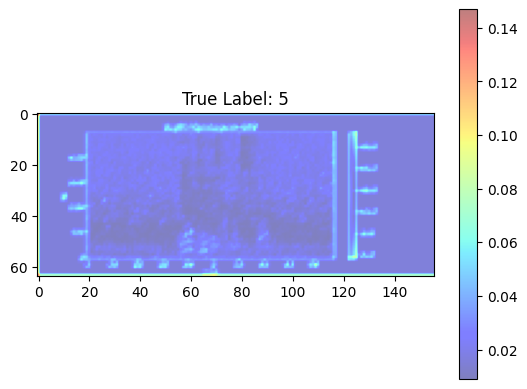

Entrenamiento, evaluación y visualización completados.


In [ ]:
import os
import pandas as pd
import torch
import torch.nn as nn
import torch.optim as optim
from torchvision import transforms
from torch.utils.data import Dataset, DataLoader, random_split
from PIL import Image
from sklearn.metrics import accuracy_score
import matplotlib.pyplot as plt
import numpy as np

# 0. Definir el ConvolutionalStem
class ConvolutionalStem(nn.Module):
    def __init__(self):
        super(ConvolutionalStem, self).__init__()
        self.conv1 = nn.Conv2d(1, 16, kernel_size=3, stride=1, padding=1)
        self.relu = nn.ReLU()
        self.pool = nn.MaxPool2d(kernel_size=2, stride=2)

    def forward(self, x):
        x = self.conv1(x)
        x = self.relu(x)
        x = self.pool(x)
        return x

# 1. Definir el dataset
class SpectrogramDataset(Dataset):
    def __init__(self, metadata_file, spectrogram_dir, transform=None):
        self.metadata = pd.read_csv(metadata_file)
        self.spectrogram_dir = spectrogram_dir
        self.transform = transform

    def __len__(self):
        return len(self.metadata)

    def __getitem__(self, idx):
        img_path = os.path.join(self.spectrogram_dir, self.metadata.iloc[idx]['id'])
        emotion = self.metadata.iloc[idx]['emotion']

        # Cargar la imagen
        image = Image.open(img_path).convert('L')
        if self.transform:
            image = self.transform(image)

        label = valid_emotions.index(emotion)
        return image, label

# 2. Definir el modelo (Vision Transformer)
class VisionTransformer(nn.Module):
    def __init__(self, num_classes=6):
        super(VisionTransformer, self).__init__()
        self.convolutional_stem = ConvolutionalStem()

        # Determinar el tamaño de entrada dinámicamente
        dummy_input = torch.randn(1, 1, 128, 313)
        dummy_output = self.convolutional_stem(dummy_input)
        self.fc_input_size = dummy_output.view(dummy_output.size(0), -1).shape[1]

        self.fc = nn.Linear(self.fc_input_size, num_classes)

    def forward(self, x):
        x = self.convolutional_stem(x)
        x = x.view(x.size(0), -1)
        x = self.fc(x)
        return x

    def get_activations(self, x):
        x = self.convolutional_stem(x)
        return x  # Devuelve las activaciones de la capa convolucional

# 3. Definir la función de entrenamiento
def train_model(model, dataloader, criterion, optimizer, num_epochs=10):
    model.train()
    for epoch in range(num_epochs):
        for images, labels in dataloader:
            optimizer.zero_grad()
            outputs = model(images)
            loss = criterion(outputs, labels)
            loss.backward()
            optimizer.step()

        print(f'Epoch [{epoch + 1}/{num_epochs}], Loss: {loss.item():.4f}')

# 4. Configurar transformaciones y datos
transform = transforms.Compose([
    transforms.Resize((128, 313)),
    transforms.ToTensor(),
])

# 5. Crear el dataset
dataset = SpectrogramDataset(metadata_file='metadata.csv',
                             spectrogram_dir='spectrograms',
                             transform=transform)

# 6. Dividir el dataset en entrenamiento y validación
train_size = int(0.8 * len(dataset))
val_size = len(dataset) - train_size
train_dataset, val_dataset = random_split(dataset, [train_size, val_size])

# 7. Crear DataLoaders para entrenamiento y validación
train_dataloader = DataLoader(train_dataset, batch_size=16, shuffle=True)
val_dataloader = DataLoader(val_dataset, batch_size=16, shuffle=False)

# 8. Inicializar el modelo, criterio y optimizador
model = VisionTransformer(num_classes=len(valid_emotions))
criterion = nn.CrossEntropyLoss()
optimizer = optim.Adam(model.parameters(), lr=0.001)

# 9. Entrenar el modelo
train_model(model, train_dataloader, criterion, optimizer, num_epochs=10)

# 10. Evaluar el modelo
def evaluate_model(model, dataloader):
    model.eval()
    all_labels = []
    all_preds = []
    with torch.no_grad():
        for images, labels in dataloader:
            outputs = model(images)
            _, predicted = torch.max(outputs.data, 1)
            all_labels.extend(labels.numpy())
            all_preds.extend(predicted.numpy())

    accuracy = accuracy_score(all_labels, all_preds)
    print(f'Accuracy: {accuracy * 100:.2f}%')

# 11. Evaluar el modelo en el conjunto de validación
evaluate_model(model, val_dataloader)

# 12. Guardar el modelo entrenado
torch.save(model.state_dict(), 'modelo_entrenado.pth')
print("Modelo guardado.")

# 13. Función para visualizar el mapa de calor
def plot_heatmap(model, dataloader, index):
    model.eval()
    with torch.no_grad():
        images, labels = next(iter(dataloader))
        image = images[index].unsqueeze(0)  # Selecciona la imagen deseada
        true_label = labels[index].item()

        # Obtener activaciones
        activations = model.get_activations(image)

        # Calcular el mapa de calor
        heatmap = activations.squeeze().cpu().numpy()
        heatmap = np.mean(heatmap, axis=0)

        # Visualizar
        plt.imshow(heatmap, cmap='jet', alpha=0.5)
        plt.title(f'True Label: {true_label}')
        plt.colorbar()
        plt.show()

# 14. Visualizar el mapa de calor para una imagen específica
plot_heatmap(model, val_dataloader, index=0)  # Cambia el índice según lo que desees visualizar

print("Entrenamiento, evaluación y visualización completados.")


In [ ]:
# 14. Visualizar el mapa de calor para una imagen específica
plot_heatmap(model, val_dataloader, index=0)  # Cambia el índice según lo que desees visualizar


AttributeError: 'VisionTransformer' object has no attribute 'get_activations'

In [ ]:
import kagglehub
import numpy as np
import librosa
import librosa.display
import matplotlib.pyplot as plt
import pandas as pd
import os
import glob
import opensmile

# 1. Descargar el dataset de Kaggle y devolver la ruta donde se almacena
path = kagglehub.dataset_download("ejlok1/cremad")
print("Path to dataset files:", path)

# 1.1. Definir los audio_ids que deseas eliminar
invalid_audio_ids = ['1088_ITH_HAP_XX.wav', '1017_IEO_SAD_HI.wav', '1040_ITH_SAD_X.wav']

# 2. Parámetros para el STFT
sampling_rate = 16000
window_size = 512
hop_size = 256
n_fft = 1024
normalize = True

# 3. Inicializar OpenSMILE
smile = opensmile.Smile(
    feature_set=opensmile.FeatureSet.ComParE_2016,
    feature_level=opensmile.FeatureLevel.Functionals,
)

# 4. Crear carpeta para guardar espectrogramas
os.makedirs('spectrograms', exist_ok=True)

# 5. Buscar archivos con extensión .wav en la carpeta 'AudioWAV'
audio_files = glob.glob(os.path.join(path, "AudioWAV", "*.wav"))
print(f"Found {len(audio_files)} audio files.")

# 6. Parámetros de almacenamiento
max_files = 7442
limited_audio_files = audio_files[:max_files]
valid_emotions = ['ANG', 'DIS', 'FEA', 'HAP', 'NEU', 'SAD']
print(f"Limiting to {len(limited_audio_files)} audio files.")

# 7. Lista para almacenar los resultados
results = []

# 8. Procesar archivos de audio
def process_audio_file(file_path, smile, valid_emotions):
    file_name = os.path.basename(file_path)
    if file_name in invalid_audio_ids:
        print(f"Archivo inválido omitido: {file_name}")
        return None

    parts = file_name.split('_')
    emotion = parts[2] if len(parts) > 2 else 'UNKNOWN'

    if emotion not in valid_emotions:
        print(f"Emoción no válida en {file_name}: {emotion}")
        return None

    # 9. Cargar el audio y calcular el Log-Mel Spectrogram
    x, sr = librosa.load(file_path, sr=sampling_rate)
    stft = librosa.stft(x, n_fft=n_fft, hop_length=hop_size, win_length=window_size)
    magnitude = np.abs(stft)
    mel_filter = librosa.filters.mel(sr=sampling_rate, n_fft=n_fft, n_mels=128)
    mel_spectrogram = np.dot(mel_filter, magnitude)
    log_mel_spectrogram = librosa.power_to_db(mel_spectrogram, ref=np.max)

    # 10. Normalización (opcional)
    if normalize:
        log_mel_spectrogram = (log_mel_spectrogram - np.mean(log_mel_spectrogram)) / np.std(log_mel_spectrogram)

    # 11. Visualizar y guardar el Log-Mel Spectrogram
    plt.figure(figsize=(10, 4))
    librosa.display.specshow(log_mel_spectrogram, sr=sampling_rate, x_axis='time', y_axis='mel')
    plt.colorbar(format='%+2.0f dB')
    plt.title(f'Log-Mel Spectrogram - {emotion}')
    plt.tight_layout()

    # 12. Guardar el espectrograma como PNG
    spectrogram_filename = f'{file_name[:-4]}.png'
    os.makedirs('spectrograms', exist_ok=True)
    plt.savefig(os.path.join('spectrograms', spectrogram_filename))
    plt.close()

    # 13. Extraer características de OpenSMILE
    open_smile_features = smile.process_file(file_path)
    open_smile_features['emotion'] = emotion
    open_smile_features['spectrogram_path'] = os.path.join('spectrograms', spectrogram_filename)
    open_smile_features['id'] = spectrogram_filename
    open_smile_features['dimensions'] = f"{log_mel_spectrogram.shape[0]}x{log_mel_spectrogram.shape[1]}"
    open_smile_features['height'] = log_mel_spectrogram.shape[0]
    open_smile_features['width'] = log_mel_spectrogram.shape[1]
    open_smile_features['sampling_rate'] = sampling_rate
    open_smile_features['window_size'] = window_size
    open_smile_features['hop_size'] = hop_size
    open_smile_features['n_fft'] = n_fft
    open_smile_features['window_function'] = 'Hamming'

    return open_smile_features  # Retornar el resultado procesado

# 14. Procesar archivos de audio
for file_path in limited_audio_files:
    result = process_audio_file(file_path, smile, valid_emotions)
    if result is not None:
        results.append(result)

# 15. Guardar los resultados en un DataFrame
if results:
    final_df = pd.concat(results, ignore_index=True)
    metadata_filename = 'metadata.csv'
    final_df.to_csv(metadata_filename, index=False)

print("Espectrogramas y metadatos guardados.")


Path to dataset files: /root/.cache/kagglehub/datasets/ejlok1/cremad/versions/1
Found 7442 audio files.
Limiting to 7442 audio files.
Archivo inválido omitido: 1088_ITH_HAP_XX.wav


In [ ]:
import os
import pandas as pd
import torch
import torch.nn as nn
import torch.optim as optim
from torchvision import transforms
from torch.utils.data import Dataset, DataLoader, random_split
from PIL import Image
from sklearn.metrics import accuracy_score
# 2 Parametros de almacenamiento

valid_emotions = ['ANG', 'DIS', 'FEA', 'HAP', 'NEU', 'SAD']

# 0. Definir el ConvolutionalStem
class ConvolutionalStem(nn.Module):
    def __init__(self):
        super(ConvolutionalStem, self).__init__()
        self.conv1 = nn.Conv2d(1, 16, kernel_size=3, stride=1, padding=1)
        self.relu = nn.ReLU()
        self.pool = nn.MaxPool2d(kernel_size=2, stride=2)

    def forward(self, x):
        x = self.conv1(x)
        x = self.relu(x)
        x = self.pool(x)
        return x

# 1. Definir el dataset
class SpectrogramDataset(Dataset):
    def __init__(self, metadata_file, spectrogram_dir, transform=None):
        self.metadata = pd.read_csv(metadata_file)
        self.spectrogram_dir = spectrogram_dir  # Store the directory of spectrograms
        self.transform = transform

    def __len__(self):
        return len(self.metadata)

    def __getitem__(self, idx):
        img_path = os.path.join(self.spectrogram_dir, self.metadata.iloc[idx]['id'])  # Join with spectrogram dir
        emotion = self.metadata.iloc[idx]['emotion']

        # Cargar la imagen
        image = Image.open(img_path).convert('L')  # Convertir a escala de grises
        if self.transform:
            image = self.transform(image)

        # Convertir la etiqueta a un índice
        label = valid_emotions.index(emotion)
        return image, label

# 2. Definir el modelo (Vision Transformer)
class VisionTransformer(nn.Module):
    def __init__(self, num_classes=6):
        super(VisionTransformer, self).__init__()
        self.convolutional_stem = ConvolutionalStem()  # Define tu ConvolutionalStem aquí

        # Determinar el tamaño de entrada dinámicamente
        dummy_input = torch.randn(1, 1, 128, 313)  # Cambia según las dimensiones de tus espectrogramas
        dummy_output = self.convolutional_stem(dummy_input)
        self.fc_input_size = dummy_output.view(dummy_output.size(0), -1).shape[1]

        self.fc = nn.Linear(self.fc_input_size, num_classes)

    def forward(self, x):
        x = self.convolutional_stem(x)
        x = x.view(x.size(0), -1)  # Flatten
        x = self.fc(x)
        return x

# 3. Definir la función de entrenamiento
def train_model(model, dataloader, criterion, optimizer, num_epochs=10):
    model.train()
    for epoch in range(num_epochs):
        for images, labels in dataloader:
            optimizer.zero_grad()
            outputs = model(images)
            loss = criterion(outputs, labels)
            loss.backward()
            optimizer.step()

        print(f'Epoch [{epoch + 1}/{num_epochs}], Loss: {loss.item():.4f}')

# 4. Configurar transformaciones y datos
transform = transforms.Compose([
    transforms.Resize((128, 313)),  # Ajusta al tamaño que necesita tu modelo
    transforms.ToTensor(),            # Convierte a tensor
])

# 5. Crear el dataset
dataset = SpectrogramDataset(metadata_file='metadata.csv',
                             spectrogram_dir='spectrograms',  # Pass the spectrogram directory
                             transform=transform)

# 6. Dividir el dataset en entrenamiento y validación
train_size = int(0.8 * len(dataset))  # 80% para entrenamiento
val_size = len(dataset) - train_size   # 20% para validación
train_dataset, val_dataset = random_split(dataset, [train_size, val_size])

# 7. Crear DataLoaders para entrenamiento y validación
train_dataloader = DataLoader(train_dataset, batch_size=16, shuffle=True)
val_dataloader = DataLoader(val_dataset, batch_size=16, shuffle=False)

# 8. Inicializar el modelo, criterio y optimizador
model = VisionTransformer(num_classes=len(valid_emotions))
criterion = nn.CrossEntropyLoss()
optimizer = optim.Adam(model.parameters(), lr=0.001)

# 9. Entrenar el modelo
train_model(model, train_dataloader, criterion, optimizer, num_epochs=10)

# 10. Evaluar el modelo
def evaluate_model(model, dataloader):
    model.eval()
    all_labels = []
    all_preds = []
    with torch.no_grad():
        for images, labels in dataloader:
            outputs = model(images)
            _, predicted = torch.max(outputs.data, 1)
            all_labels.extend(labels.numpy())
            all_preds.extend(predicted.numpy())

    accuracy = accuracy_score(all_labels, all_preds)
    print(f'Accuracy: {accuracy * 100:.2f}%')

# 11. Evaluar el modelo en el conjunto de validación
evaluate_model(model, val_dataloader)

print("Entrenamiento y evaluación completados.")


Epoch [1/10], Loss: 7.1301
Epoch [2/10], Loss: 2.7326
Epoch [3/10], Loss: 1.9017
Epoch [4/10], Loss: 1.4929
Epoch [5/10], Loss: 0.6922
Epoch [6/10], Loss: 0.4996
Epoch [7/10], Loss: 0.6342
Epoch [8/10], Loss: 0.3382
Epoch [9/10], Loss: 0.3192
Epoch [10/10], Loss: 0.2623
Accuracy: 87.50%
Entrenamiento y evaluación completados.


In [ ]:
# 1. Cargar el modelo de espectrogramas
model_path = 'modelo_entrenado.pth'
base_model = VisionTransformer(num_classes=len(valid_emotions))
base_model.load_state_dict(torch.load(model_path))
base_model.eval()  # Modo de evaluación para evitar el cálculo de gradientes

# 2. Crear el modelo para prosodia
prosody_dataset = ProsodyDataset(metadata_file='metadata_opensmile.csv')
prosody_dataloader = DataLoader(prosody_dataset, batch_size=16, shuffle=True)

prosody_model = ProsodyModel(base_model, num_classes=len(prosody_dataset.emotions))

# 3. Configurar el criterio y optimizador
criterion = nn.CrossEntropyLoss()
optimizer = torch.optim.Adam(prosody_model.parameters(), lr=0.001)

# 4. Función de entrenamiento
def train_prosody_model(model, dataloader, criterion, optimizer, num_epochs=10):
    model.train()
    for epoch in range(num_epochs):
        for features, labels in dataloader:
            optimizer.zero_grad()
            outputs = model(features)
            loss = criterion(outputs, labels)
            loss.backward()
            optimizer.step()
        print(f'Epoch [{epoch + 1}/{num_epochs}], Loss: {loss.item():.4f}')

# 5. Entrenar el modelo
train_prosody_model(prosody_model, prosody_dataloader, criterion, optimizer, num_epochs=10)

# 6. Evaluar el modelo (opcional)


In [ ]:
import os
import pandas as pd
import torch
import torch.nn as nn
import torch.optim as optim
from torchvision import transforms
from torch.utils.data import Dataset, DataLoader, random_split
from PIL import Image
from sklearn.metrics import accuracy_score

# 0. Definir el ConvolutionalStem
class ConvolutionalStem(nn.Module):
    def __init__(self):
        super(ConvolutionalStem, self).__init__()
        self.conv1 = nn.Conv2d(1, 16, kernel_size=3, stride=1, padding=1)
        self.relu = nn.ReLU()
        self.pool = nn.MaxPool2d(kernel_size=2, stride=2)

    def forward(self, x):
        x = self.conv1(x)
        x = self.relu(x)
        x = self.pool(x)
        return x

# 1. Definir el dataset
class SpectrogramDataset(Dataset):
    def __init__(self, metadata_file, spectrogram_dir, transform=None):
        self.metadata = pd.read_csv(metadata_file)
        self.spectrogram_dir = spectrogram_dir  # Store the directory of spectrograms
        self.transform = transform

    def __len__(self):
        return len(self.metadata)

    def __getitem__(self, idx):
        img_path = os.path.join(self.spectrogram_dir, self.metadata.iloc[idx]['id'])  # Join with spectrogram dir
        emotion = self.metadata.iloc[idx]['emotion']

        # Cargar la imagen
        image = Image.open(img_path).convert('L')  # Convertir a escala de grises
        if self.transform:
            image = self.transform(image)

        # Convertir la etiqueta a un índice
        label = valid_emotions.index(emotion)
        return image, label

# 2. Definir el modelo (Vision Transformer)
# Modelo para extraer características
class VisionTransformer(nn.Module):
    def __init__(self, num_classes=6):
        super(VisionTransformer, self).__init__()
        self.convolutional_stem = ConvolutionalStem()
        dummy_input = torch.randn(1, 1, 128, 313)
        dummy_output = self.convolutional_stem(dummy_input)
        self.fc_input_size = dummy_output.view(dummy_output.size(0), -1).shape[1]
        self.fc = nn.Linear(self.fc_input_size, num_classes)

    def forward(self, x):
        x = self.convolutional_stem(x)
        features = x.view(x.size(0), -1)  # Flatten para obtener características
        x = self.fc(features)
        return x, features  # Devolver también las características

# 3. Definir la función de entrenamiento
def train_model(model, dataloader, criterion, optimizer, num_epochs=10):
    model.train()
    for epoch in range(num_epochs):
        for images, labels in dataloader:
            optimizer.zero_grad()
            outputs = model(images)
            loss = criterion(outputs, labels)
            loss.backward()
            optimizer.step()

        print(f'Epoch [{epoch + 1}/{num_epochs}], Loss: {loss.item():.4f}')

# 4. Configurar transformaciones y datos
transform = transforms.Compose([
    transforms.Resize((128, 313)),  # Ajusta al tamaño que necesita tu modelo
    transforms.ToTensor(),            # Convierte a tensor
])

# 5. Crear el dataset
dataset = SpectrogramDataset(metadata_file='metadata.csv',
                             spectrogram_dir='spectrograms',  # Pass the spectrogram directory
                             transform=transform)

# 6. Dividir el dataset en entrenamiento y validación
train_size = int(0.8 * len(dataset))  # 80% para entrenamiento
val_size = len(dataset) - train_size   # 20% para validación
train_dataset, val_dataset = random_split(dataset, [train_size, val_size])

# 7. Crear DataLoaders para entrenamiento y validación
train_dataloader = DataLoader(train_dataset, batch_size=16, shuffle=True)
val_dataloader = DataLoader(val_dataset, batch_size=16, shuffle=False)

# 8. Inicializar el modelo, criterio y optimizador
model = VisionTransformer(num_classes=len(valid_emotions))
criterion = nn.CrossEntropyLoss()
optimizer = optim.Adam(model.parameters(), lr=0.001)

# 9. Entrenar el modelo
train_model(model, train_dataloader, criterion, optimizer, num_epochs=10)

# 10. Evaluar el modelo
def evaluate_model(model, dataloader):
    model.eval()
    all_labels = []
    all_preds = []
    all_features = []  # Lista para almacenar características
    with torch.no_grad():
        for images, labels in dataloader:
            outputs, features = model(images)  # Obtener también características
            _, predicted = torch.max(outputs.data, 1)
            all_labels.extend(labels.numpy())
            all_preds.extend(predicted.numpy())
            all_features.append(features.numpy())  # Almacenar características

    # Convertir la lista de características a un solo array
    all_features = np.concatenate(all_features, axis=0)

# 11. Evaluar el modelo en el conjunto de validación
evaluate_model(model, val_dataloader)

# 12. Guardar el modelo entrenado
torch.save(model.state_dict(), 'modelo_entrenado.pth')
print("Modelo guardado.")

print("Entrenamiento y evaluación completados.")


NameError: name 'valid_emotions' is not defined

In [ ]:
import os
import pandas as pd
import torch
import torch.nn as nn
import torch.optim as optim
from torchvision import transforms
from torch.utils.data import Dataset, DataLoader, random_split
from PIL import Image
from sklearn.metrics import accuracy_score
import numpy as np

# 0. Definir el ConvolutionalStem
class ConvolutionalStem(nn.Module):
    def __init__(self):
        super(ConvolutionalStem, self).__init__()
        self.conv1 = nn.Conv2d(1, 16, kernel_size=3, stride=1, padding=1)
        self.relu = nn.ReLU()
        self.pool = nn.MaxPool2d(kernel_size=2, stride=2)

    def forward(self, x):
        x = self.conv1(x)
        x = self.relu(x)
        x = self.pool(x)
        return x

# 1. Definir el dataset
class SpectrogramDataset(Dataset):
    def __init__(self, metadata_file, spectrogram_dir, transform=None):
        self.metadata = pd.read_csv(metadata_file)
        self.spectrogram_dir = spectrogram_dir
        self.transform = transform

        # Determinar automáticamente el número de características de OpenSMILE
        self.open_smile_features_start_idx = 11  # Cambiar según el índice donde empiezan las características
        self.num_open_smile_features = self.metadata.shape[1] - self.open_smile_features_start_idx - 2  # Restar 'emotion' y 'id'

    def __len__(self):
        return len(self.metadata)

    def __getitem__(self, idx):
        img_path = os.path.join(self.spectrogram_dir, self.metadata.iloc[idx]['id'])
        emotion = self.metadata.iloc[idx]['emotion']

        # Cargar la imagen
        image = Image.open(img_path).convert('L')
        if self.transform:
            image = self.transform(image)

        # Convertir la etiqueta a un índice
        label = valid_emotions.index(emotion)

        # Obtener las características de OpenSMILE
        open_smile_features = self.metadata.iloc[idx, self.open_smile_features_start_idx:-2].values.astype(np.float32)

        return image, label, open_smile_features

# 2. Definir el modelo combinado
class CombinedModel(nn.Module):
    def __init__(self, num_classes=6, num_open_smile_features=0):
        super(CombinedModel, self).__init__()
        self.convolutional_stem = ConvolutionalStem()

        # Definir la parte del modelo para las características de OpenSMILE
        self.open_smile_fc = nn.Linear(num_open_smile_features, 128)

        # Determinar el tamaño de entrada dinámicamente para la parte del espectrograma
        dummy_input = torch.randn(1, 1, 128, 313)
        dummy_output = self.convolutional_stem(dummy_input)
        self.fc_input_size = dummy_output.view(dummy_output.size(0), -1).shape[1]

        self.fc_combined = nn.Linear(self.fc_input_size + 128, num_classes)

    def forward(self, x_spectrogram, x_open_smile):
        x_spectrogram = self.convolutional_stem(x_spectrogram)
        x_spectrogram = x_spectrogram.view(x_spectrogram.size(0), -1)  # Flatten

        x_open_smile = self.open_smile_fc(x_open_smile)

        # Combinar ambas salidas
        x_combined = torch.cat((x_spectrogram, x_open_smile), dim=1)
        x_out = self.fc_combined(x_combined)
        return x_out

# 3. Definir la función de entrenamiento
def train_model(model, dataloader, criterion, optimizer, num_epochs=10):
    model.train()
    for epoch in range(num_epochs):
        for images, labels, open_smile_features in dataloader:
            optimizer.zero_grad()
            outputs = model(images, open_smile_features)  # Pasar ambas entradas
            loss = criterion(outputs, labels)
            loss.backward()
            optimizer.step()

        print(f'Epoch [{epoch + 1}/{num_epochs}], Loss: {loss.item():.4f}')

# 4. Configurar transformaciones y datos
transform = transforms.Compose([
    transforms.Resize((128, 313)),
    transforms.ToTensor(),
])

# 5. Crear el dataset
dataset = SpectrogramDataset(metadata_file='metadata.csv',
                             spectrogram_dir='spectrograms',
                             transform=transform)

# Inicializar el modelo
model = CombinedModel(num_classes=len(valid_emotions), num_open_smile_features=dataset.num_open_smile_features)

# 6. Dividir el dataset en entrenamiento y validación
train_size = int(0.8 * len(dataset))  # 80% para entrenamiento
val_size = len(dataset) - train_size   # 20% para validación
train_dataset, val_dataset = random_split(dataset, [train_size, val_size])

# 7. Crear DataLoaders para entrenamiento y validación
train_dataloader = DataLoader(train_dataset, batch_size=16, shuffle=True)
val_dataloader = DataLoader(val_dataset, batch_size=16, shuffle=False)

# 8. Inicializar el criterio y optimizador
criterion = nn.CrossEntropyLoss()
optimizer = optim.Adam(model.parameters(), lr=0.001)

# 9. Entrenar el modelo
train_model(model, train_dataloader, criterion, optimizer, num_epochs=10)

# 10. Evaluar el modelo
def evaluate_model(model, dataloader):
    model.eval()
    all_labels = []
    all_preds = []
    with torch.no_grad():
        for images, labels, open_smile_features in dataloader:  # Agregar open_smile_features
            outputs = model(images, open_smile_features)  # Pasar ambas entradas
            _, predicted = torch.max(outputs.data, 1)
            all_labels.extend(labels.numpy())
            all_preds.extend(predicted.numpy())

    accuracy = accuracy_score(all_labels, all_preds)
    print(f'Accuracy: {accuracy * 100:.2f}%')

# 11. Evaluar el modelo en el conjunto de validación
evaluate_model(model, val_dataloader)

print("Entrenamiento y evaluación completados.")


Epoch [1/10], Loss: 738543.7500
Epoch [2/10], Loss: 318783.1875
Epoch [3/10], Loss: 134309.7969
Epoch [4/10], Loss: 12260.6123
Epoch [5/10], Loss: 15542.9971
Epoch [6/10], Loss: 31735.1953
Epoch [7/10], Loss: 142968.6562
Epoch [8/10], Loss: 74404.8594
Epoch [9/10], Loss: 3181048.0000
Epoch [10/10], Loss: 4042536.5000
Accuracy: 17.00%
Entrenamiento y evaluación completados.


In [ ]:
import os
import pandas as pd
import torch
import torch.nn as nn
import torch.optim as optim
from torchvision import transforms
from torch.utils.data import Dataset, DataLoader, random_split
from PIL import Image
from sklearn.metrics import accuracy_score
import numpy as np

# 0. Definir el ConvolutionalStem
class ConvolutionalStem(nn.Module):
    def __init__(self):
        super(ConvolutionalStem, self).__init__()
        self.conv1 = nn.Conv2d(1, 16, kernel_size=3, stride=1, padding=1)
        self.relu = nn.ReLU()
        self.pool = nn.MaxPool2d(kernel_size=2, stride=2)

    def forward(self, x):
        x = self.conv1(x)
        x = self.relu(x)
        x = self.pool(x)
        return x

# 1. Definir el dataset
class SpectrogramDataset(Dataset):
    def __init__(self, metadata_file, spectrogram_dir, transform=None):
        self.metadata = pd.read_csv(metadata_file)
        self.spectrogram_dir = spectrogram_dir
        self.transform = transform

        # Asumiendo que las primeras 3 columnas son irrelevantes (emotion, spectrogram_path, id)
        irrelevant_columns = ['emotion', 'spectrogram_path', 'id',	'dimensions',	'height	',	'width',	'sampling_rate',	'	window_size',	'hop_size	',	'n_fft',	'window_function']
        self.open_smile_features_start_idx = len(irrelevant_columns)  # Start from the next column
        self.num_open_smile_features = self.metadata.shape[1] - self.open_smile_features_start_idx

        print(f'Número de características de OpenSMILE: {self.num_open_smile_features}')  # Debugging

    def __len__(self):
        return len(self.metadata)

    def __getitem__(self, idx):
        img_path = os.path.join(self.spectrogram_dir, self.metadata.iloc[idx]['id'])
        emotion = self.metadata.iloc[idx]['emotion']

        # Cargar la imagen
        image = Image.open(img_path).convert('L')
        if self.transform:
            image = self.transform(image)

        # Convertir la etiqueta a un índice
        label = valid_emotions.index(emotion)

        # Obtener las características de OpenSMILE
        open_smile_features = self.metadata.iloc[idx, self.open_smile_features_start_idx:].values.astype(np.float32)

        return image, label, open_smile_features

# 2. Definir el modelo combinado
class CombinedModel(nn.Module):
    def __init__(self, num_classes=6, num_open_smile_features=0):
        super(CombinedModel, self).__init__()
        self.convolutional_stem = ConvolutionalStem()

        # Definir la parte del modelo para las características de OpenSMILE
        self.open_smile_fc = nn.Linear(num_open_smile_features, 128)

        # Determinar el tamaño de entrada dinámicamente para la parte del espectrograma
        dummy_input = torch.randn(1, 1, 128, 313)
        dummy_output = self.convolutional_stem(dummy_input)
        self.fc_input_size = dummy_output.view(dummy_output.size(0), -1).shape[1]

        print(f'Tamaño de entrada para la parte espectrograma: {self.fc_input_size}')  # Debugging

        self.fc_combined = nn.Linear(self.fc_input_size + 128, num_classes)

    def forward(self, x_spectrogram, x_open_smile):
        x_spectrogram = self.convolutional_stem(x_spectrogram)
        x_spectrogram = x_spectrogram.view(x_spectrogram.size(0), -1)  # Flatten

        x_open_smile = self.open_smile_fc(x_open_smile)

        # Combinar ambas salidas
        x_combined = torch.cat((x_spectrogram, x_open_smile), dim=1)
        x_out = self.fc_combined(x_combined)
        return x_out

# 3. Función de entrenamiento
def train_model(model, dataloader, criterion, optimizer, num_epochs=10):
    model.train()
    for epoch in range(num_epochs):
        for images, labels, open_smile_features in dataloader:
            optimizer.zero_grad()
            outputs = model(images, open_smile_features)  # Pasar ambas entradas
            loss = criterion(outputs, labels)
            loss.backward()
            optimizer.step()

        print(f'Epoch [{epoch + 1}/{num_epochs}], Loss: {loss.item():.4f}')

# 4. Configurar transformaciones y datos
transform = transforms.Compose([
    transforms.Resize((128, 313)),
    transforms.ToTensor(),
])

# 5. Crear el dataset
dataset = SpectrogramDataset(metadata_file='metadata.csv',
                             spectrogram_dir='spectrograms',
                             transform=transform)

# Inicializar el modelo
model = CombinedModel(num_classes=len(valid_emotions), num_open_smile_features=dataset.num_open_smile_features)

# 6. Dividir el dataset en entrenamiento y validación
train_size = int(0.8 * len(dataset))  # 80% para entrenamiento
val_size = len(dataset) - train_size   # 20% para validación
train_dataset, val_dataset = random_split(dataset, [train_size, val_size])

# 7. Crear DataLoaders para entrenamiento y validación
train_dataloader = DataLoader(train_dataset, batch_size=16, shuffle=True)
val_dataloader = DataLoader(val_dataset, batch_size=16, shuffle=False)

# 8. Inicializar el criterio y optimizador
criterion = nn.CrossEntropyLoss()
optimizer = optim.Adam(model.parameters(), lr=0.001)

# 9. Entrenar el modelo
train_model(model, train_dataloader, criterion, optimizer, num_epochs=10)

# 10. Evaluar el modelo
def evaluate_model(model, dataloader):
    model.eval()
    all_labels = []
    all_preds = []
    with torch.no_grad():
        for images, labels, open_smile_features in dataloader:
            outputs = model(images, open_smile_features)  # Pasar ambas entradas
            _, predicted = torch.max(outputs.data, 1)
            all_labels.extend(labels.numpy())
            all_preds.extend(predicted.numpy())

    accuracy = accuracy_score(all_labels, all_preds)
    print(f'Accuracy: {accuracy * 100:.2f}%')

# 11. Evaluar el modelo en el conjunto de validación
evaluate_model(model, val_dataloader)

print("Entrenamiento y evaluación completados.")


Número de características de OpenSMILE: 6373
Tamaño de entrada para la parte espectrograma: 159744
Epoch [1/10], Loss: 1420732.1250
Epoch [2/10], Loss: 254032.7188
Epoch [3/10], Loss: 438069.2188
Epoch [4/10], Loss: 225826.1875
Epoch [5/10], Loss: 24783.8633
Epoch [6/10], Loss: 24500.2969
Epoch [7/10], Loss: 56864.6797
Epoch [8/10], Loss: 9073.7520
Epoch [9/10], Loss: 6499.8311
Epoch [10/10], Loss: 22883.4707
Accuracy: 19.00%
Entrenamiento y evaluación completados.


In [ ]:
import numpy as np
import librosa
import librosa.display
import matplotlib.pyplot as plt
import pandas as pd
import os # Import the os module

# 1. Parámetros para el STFT
audio_file = 'grabacion.wav'
sampling_rate = 16000  # Frecuencia de muestreo
window_size = 512       # Tamaño de la ventana
hop_size = 256          # Tamaño del salto
n_fft = 1024            # Número de puntos DFT

# 2. Cargar el audio
x, sr = librosa.load(audio_file, sr=sampling_rate)

# 3. Calcular STFT
stft = librosa.stft(x, n_fft=n_fft, hop_length=hop_size, win_length=window_size)

# 4. Calcular el espectrograma de magnitud
magnitude = np.abs(stft)

# 5. Convertir a Log-Mel Spectrogram
mel_filter = librosa.filters.mel(sr=sampling_rate, n_fft=n_fft, n_mels=128)  # 128 filtros Mel
mel_spectrogram = np.dot(mel_filter, magnitude)
log_mel_spectrogram = librosa.power_to_db(mel_spectrogram, ref=np.max)

# 6. Visualizar y guardar el Log-Mel Spectrogram
plt.figure(figsize=(10, 4))
librosa.display.specshow(log_mel_spectrogram, sr=sampling_rate, x_axis='time', y_axis='mel')
plt.colorbar(format='%+2.0f dB')
plt.title('Log-Mel Spectrogram')
plt.tight_layout()

# Guardar el espectrograma como PNG
spectrogram_filename = 'spectrogram.png'
os.makedirs('spectrograms', exist_ok=True)
# Save the spectrogram in the created directory
plt.savefig(os.path.join('spectrograms', spectrogram_filename))
plt.close()

# 7. Crear y guardar metadatos
metadata = {
    'id': os.path.join('spectrograms', spectrogram_filename),
    'dimensions': f"{log_mel_spectrogram.shape[0]}x{log_mel_spectrogram.shape[1]}",
    'height': log_mel_spectrogram.shape[0],
    'width': log_mel_spectrogram.shape[1],
    'sampling_rate': sampling_rate,
    'window_size': window_size,
    'hop_size': hop_size,
    'n_fft': n_fft,
    'window_function': 'Hamming'  # Puedes especificar otra si es necesario
}

# Guardar metadatos en un DataFrame y exportar a CSV
metadata_df = pd.DataFrame([metadata])
metadata_filename = 'metadata.csv'
metadata_df.to_csv(metadata_filename, index=False)

print("Espectrograma y metadatos guardados.")


Espectrograma y metadatos guardados.


In [ ]:
import kagglehub
import numpy as np
import librosa
import librosa.display
import matplotlib.pyplot as plt
import pandas as pd
import os  # Importar el módulo os
import glob  # Importar la función glob

# Paso 1: Descargar el dataset de Kaggle y devolver la ruta donde se almacena
path = kagglehub.dataset_download("ejlok1/cremad")
print("Path to dataset files:", path)

# Paso 1.1: Definir los audio_ids que deseas eliminar
invalid_audio_ids = ['1088_ITH_HAP_XX.wav', '1017_IEO_SAD_HI.wav', '1040_ITH_SAD_X.wav']

# 1. Parámetros para el STFT
sampling_rate = 16000
window_size = 512
hop_size = 256
n_fft = 1024
normalize = True

# 2 Parametros de almacenamiento
max_files = 1000
limited_audio_files = audio_files[:max_files]
valid_emotions = ['ANG', 'DIS', 'FEA', 'HAP', 'NEU', 'SAD']
# Inicializar OpenSMILE
smile = opensmile.Smile(
    feature_set=opensmile.FeatureSet.ComParE_2016,
    feature_level=opensmile.FeatureLevel.Functionals,
)

# 3. Buscar archivos con extensión .wav en la carpeta 'AudioWAV'
audio_files = glob.glob(os.path.join(path, "AudioWAV", "*.wav"))
print(f"Found {len(audio_files)} audio files.")
print(f"Limiting to {len(limited_audio_files)} audio files.")

# 4. Procesar un número limitado de archivos de audio
count = 0
for file_path in limited_audio_files:
    if count >= max_files:
        break  # Limitar el número de archivos procesados

    # Extraer la etiqueta de emoción desde el nombre del archivo
    file_name = os.path.basename(file_path)
    if file_name in invalid_audio_ids:
        print(f"Archivo inválido omitido: {file_name}")
        continue  # Saltar archivos inválidos
    parts = file_name.split('_')
    emotion = parts[2] if len(parts) > 2 else 'UNKNOWN'  # Asigna UNKNOWN si no hay emoción

    # Verificar si la emoción es válida
    if emotion not in valid_emotions:
        print(f"Emoción no válida en {file_name}: {emotion}")
        continue  # Saltar archivos con emociones no válidas

    # 5. Cargar el audio y calcular el Log-Mel Spectrogram
    x, sr = librosa.load(file_path, sr=sampling_rate)
    stft = librosa.stft(x, n_fft=n_fft, hop_length=hop_size, win_length=window_size)
    magnitude = np.abs(stft)
    mel_filter = librosa.filters.mel(sr=sampling_rate, n_fft=n_fft, n_mels=128)
    mel_spectrogram = np.dot(mel_filter, magnitude)
    log_mel_spectrogram = librosa.power_to_db(mel_spectrogram, ref=np.max)

    # 6. Normalización (opcional)
    if normalize:
        log_mel_spectrogram = (log_mel_spectrogram - np.mean(log_mel_spectrogram)) / np.std(log_mel_spectrogram)

    # 7. Visualizar y guardar el Log-Mel Spectrogram
    plt.figure(figsize=(10, 4))
    librosa.display.specshow(log_mel_spectrogram, sr=sampling_rate, x_axis='time', y_axis='mel')
    plt.colorbar(format='%+2.0f dB')
    plt.title(f'Log-Mel Spectrogram - {emotion}')
    plt.tight_layout()

# Guardar el espectrograma como PNG con el nombre original sin la extensión .wav
    spectrogram_filename = f'{file_name[:-4]}.png'  # Eliminar .wav
    os.makedirs('spectrograms', exist_ok=True)
    plt.savefig(os.path.join('spectrograms', spectrogram_filename))
    plt.close()
# 8. Extraer características de OpenSMILE
    audio_data, sr = librosa.load(file_path, sr=sampling_rate)
    open_smile_features = smile.process_file(file_path)
    features_list.append(open_smile_features)  # Acumular características
    # 8. Crear y guardar metadatos
    metadata = {
        'id': os.path.join(spectrogram_filename),
        'emotion': emotion,
        'dimensions': f"{log_mel_spectrogram.shape[0]}x{log_mel_spectrogram.shape[1]}",
        'height': log_mel_spectrogram.shape[0],
        'width': log_mel_spectrogram.shape[1],
        'sampling_rate': sampling_rate,
        'window_size': window_size,
        'hop_size': hop_size,
        'n_fft': n_fft,
        'window_function': 'Hamming'
    }
    # Guardar metadatos en un DataFrame y exportar a CSV
    metadata_df = pd.DataFrame([metadata])
    metadata_df = pd.concat(features_list, ignore_index=True)

    metadata_filename = 'metadata.csv'
    metadata_df.to_csv(metadata_filename, index=False, mode='a', header=not os.path.exists(metadata_filename))

print("Espectrogramas y metadatos guardados.")

In [ ]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import librosa
import librosa.display
import numpy as np

# 1. Parámetros para el STFT
audio_file = 'grabacion.wav'
sampling_rate = 16000  # Frecuencia de muestreo
window_size = 512       # Tamaño de la ventana
hop_size = 256          # Tamaño del salto
n_fft = 1024            # Número de puntos DFT

# 2. Cargar el audio y calcular el Log-Mel Spectrogram
def load_audio_and_compute_log_mel(audio_file):
    x, sr = librosa.load(audio_file, sr=sampling_rate)
    stft = librosa.stft(x, n_fft=n_fft, hop_length=hop_size, win_length=window_size)
    magnitude = np.abs(stft)
    mel_filter = librosa.filters.mel(sr=sampling_rate, n_fft=n_fft, n_mels=128)
    mel_spectrogram = np.dot(mel_filter, magnitude)
    log_mel_spectrogram = librosa.power_to_db(mel_spectrogram, ref=np.max)
    return log_mel_spectrogram

# 3. Definir el modelo
class VisionTransformer(nn.Module):
    def __init__(self, num_classes=7):
        super(VisionTransformer, self).__init__()
        self.convolutional_stem = ConvolutionalStem()

        # Calculate the output size of the convolutional stem dynamically
        dummy_input = torch.randn(1, 1, 128, 313)  # Use the shape of your log_mel_spectrogram
        dummy_output = self.convolutional_stem(dummy_input)
        self.fc_input_size = dummy_output.view(dummy_output.size(0), -1).shape[1]

        self.fc = nn.Linear(self.fc_input_size, num_classes)

    def forward(self, x):
        x = self.convolutional_stem(x)
        x = x.view(x.size(0), -1)  # Flatten
        x = self.fc(x)
        return x

# 4. Ejemplo de uso
log_mel_spectrogram = load_audio_and_compute_log_mel(audio_file)
log_mel_spectrogram = torch.tensor(log_mel_spectrogram).unsqueeze(0).unsqueeze(0)  # [1, 1, H, W]

model = VisionTransformer()
output = model(log_mel_spectrogram)
print(output)


tensor([[ 1.0761, -0.7321, -4.6220,  1.4044, -0.1673,  1.1734, -1.1001]],
       grad_fn=<AddmmBackward0>)


In [ ]:
import os
import pandas as pd
import torch
import torch.nn as nn
import torch.optim as optim
from torchvision import transforms
from torch.utils.data import Dataset, DataLoader, random_split
from PIL import Image
from sklearn.metrics import accuracy_score
import matplotlib.pyplot as plt
import numpy as np

# 0. Definir el ConvolutionalStem
class ConvolutionalStem(nn.Module):
    def __init__(self):
        super(ConvolutionalStem, self).__init__()
        self.conv1 = nn.Conv2d(1, 16, kernel_size=3, stride=1, padding=1)
        self.relu = nn.ReLU()
        self.pool = nn.MaxPool2d(kernel_size=2, stride=2)

    def forward(self, x):
        x = self.conv1(x)
        x = self.relu(x)
        x = self.pool(x)
        return x

# 1. Definir el dataset
class SpectrogramDataset(Dataset):
    def __init__(self, metadata_file, spectrogram_dir, transform=None):
        self.metadata = pd.read_csv(metadata_file)
        self.spectrogram_dir = spectrogram_dir
        self.transform = transform

    def __len__(self):
        return len(self.metadata)

    def __getitem__(self, idx):
        img_path = os.path.join(self.spectrogram_dir, self.metadata.iloc[idx]['id'])
        emotion = self.metadata.iloc[idx]['emotion']

        # Cargar la imagen
        image = Image.open(img_path).convert('L')
        if self.transform:
            image = self.transform(image)

        label = valid_emotions.index(emotion)
        return image, label

# 2. Definir el modelo (Vision Transformer)
class VisionTransformer(nn.Module):
    def __init__(self, num_classes=6):
        super(VisionTransformer, self).__init__()
        self.convolutional_stem = ConvolutionalStem()

        # Determinar el tamaño de entrada dinámicamente
        dummy_input = torch.randn(1, 1, 128, 313)
        dummy_output = self.convolutional_stem(dummy_input)
        self.fc_input_size = dummy_output.view(dummy_output.size(0), -1).shape[1]

        self.fc = nn.Linear(self.fc_input_size, num_classes)

    def forward(self, x):
        x = self.convolutional_stem(x)
        x = x.view(x.size(0), -1)
        x = self.fc(x)
        return x

    def get_activations(self, x):
        x = self.convolutional_stem(x)
        return x  # Devuelve las activaciones de la capa convolucional

# 3. Definir la función de entrenamiento
def train_model(model, dataloader, criterion, optimizer, num_epochs=10):
    model.train()
    for epoch in range(num_epochs):
        for images, labels in dataloader:
            optimizer.zero_grad()
            outputs = model(images)
            loss = criterion(outputs, labels)
            loss.backward()
            optimizer.step()

        print(f'Epoch [{epoch + 1}/{num_epochs}], Loss: {loss.item():.4f}')

# 4. Configurar transformaciones y datos
transform = transforms.Compose([
    transforms.Resize((128, 313)),
    transforms.ToTensor(),
])

# 5. Crear el dataset
dataset = SpectrogramDataset(metadata_file='metadata.csv',
                             spectrogram_dir='spectrograms',
                             transform=transform)

# 6. Dividir el dataset en entrenamiento y validación
train_size = int(0.8 * len(dataset))
val_size = len(dataset) - train_size
train_dataset, val_dataset = random_split(dataset, [train_size, val_size])

# 7. Crear DataLoaders para entrenamiento y validación
train_dataloader = DataLoader(train_dataset, batch_size=16, shuffle=True)
val_dataloader = DataLoader(val_dataset, batch_size=16, shuffle=False)

# 8. Inicializar el modelo, criterio y optimizador
model = VisionTransformer(num_classes=len(valid_emotions))
criterion = nn.CrossEntropyLoss()
optimizer = optim.Adam(model.parameters(), lr=0.001)

# 9. Entrenar el modelo
train_model(model, train_dataloader, criterion, optimizer, num_epochs=10)

# 10. Evaluar el modelo
def evaluate_model(model, dataloader):
    model.eval()
    all_labels = []
    all_preds = []
    with torch.no_grad():
        for images, labels in dataloader:
            outputs = model(images)
            _, predicted = torch.max(outputs.data, 1)
            all_labels.extend(labels.numpy())
            all_preds.extend(predicted.numpy())

    accuracy = accuracy_score(all_labels, all_preds)
    print(f'Accuracy: {accuracy * 100:.2f}%')

# 11. Evaluar el modelo en el conjunto de validación
evaluate_model(model, val_dataloader)

# 12. Guardar el modelo entrenado
torch.save(model.state_dict(), 'modelo_entrenado.pth')
print("Modelo guardado.")

# 13. Función para visualizar el mapa de calor
def plot_heatmap(model, dataloader, index):
    model.eval()
    with torch.no_grad():
        images, labels = next(iter(dataloader))
        image = images[index].unsqueeze(0)  # Selecciona la imagen deseada
        true_label = labels[index].item()

        # Obtener activaciones
        activations = model.get_activations(image)

        # Calcular el mapa de calor
        heatmap = activations.squeeze().cpu().numpy()
        heatmap = np.mean(heatmap, axis=0)

        # Visualizar
        plt.imshow(heatmap, cmap='jet', alpha=0.5)
        plt.title(f'True Label: {true_label}')
        plt.colorbar()
        plt.show()

# 14. Visualizar el mapa de calor para una imagen específica
plot_heatmap(model, val_dataloader, index=0)  # Cambia el índice según lo que desees visualizar

print("Entrenamiento, evaluación y visualización completados.")

In [ ]:
import os
import pandas as pd
import torch
import torch.nn as nn
import torch.optim as optim
from torchvision import transforms
from torch.utils.data import Dataset, DataLoader, random_split
from PIL import Image
from sklearn.metrics import accuracy_score

valid_emotions = ['ANG', 'DIS', 'FEA', 'HAP', 'NEU', 'SAD']

# 0. Definir el ConvolutionalStem
class ConvolutionalStem(nn.Module):
    def __init__(self):
        super(ConvolutionalStem, self).__init__()
        self.conv1 = nn.Conv2d(1, 16, kernel_size=3, stride=1, padding=1)
        self.relu = nn.ReLU()
        self.pool = nn.MaxPool2d(kernel_size=2, stride=2)

    def forward(self, x):
        x = self.conv1(x)
        x = self.relu(x)
        x = self.pool(x)
        return x

# 1. Definir el dataset
class SpectrogramDataset(Dataset):
    def __init__(self, metadata_file, spectrogram_dir, transform=None):
        self.metadata = pd.read_csv(metadata_file)
        self.spectrogram_dir = spectrogram_dir  # Store the directory of spectrograms
        self.transform = transform

    def __len__(self):
        return len(self.metadata)

    def __getitem__(self, idx):
        img_path = os.path.join(self.spectrogram_dir, self.metadata.iloc[idx]['id'])  # Join with spectrogram dir
        emotion = self.metadata.iloc[idx]['emotion']

        # Cargar la imagen
        image = Image.open(img_path).convert('L')  # Convertir a escala de grises
        if self.transform:
            image = self.transform(image)

        # Convertir la etiqueta a un índice
        label = valid_emotions.index(emotion)
        return image, label

# 2. Definir el modelo (Vision Transformer)
class VisionTransformer(nn.Module):
    def __init__(self, num_classes=len(valid_emotions)):
        super(VisionTransformer, self).__init__()
        self.convolutional_stem = ConvolutionalStem()  # Define tu ConvolutionalStem aquí

        # Determinar el tamaño de entrada dinámicamente
        dummy_input = torch.randn(1, 1, 128, 313)  # Cambia según las dimensiones de tus espectrogramas
        dummy_output = self.convolutional_stem(dummy_input)
        self.fc_input_size = dummy_output.view(dummy_output.size(0), -1).shape[1]

        self.fc = nn.Linear(self.fc_input_size, num_classes)

    def forward(self, x):
        x = self.convolutional_stem(x)
        x = x.view(x.size(0), -1)  # Flatten
        x = self.fc(x)
        return x

# 3. Definir la función de entrenamiento
def train_model(model, dataloader, criterion, optimizer, num_epochs=10):
    model.train()
    for epoch in range(num_epochs):
        for images, labels in dataloader:
            optimizer.zero_grad()
            outputs = model(images)
            loss = criterion(outputs, labels)
            loss.backward()
            optimizer.step()

        print(f'Epoch [{epoch + 1}/{num_epochs}], Loss: {loss.item():.4f}')

# 4. Configurar transformaciones y datos
transform = transforms.Compose([
    transforms.Resize((128, 313)),  # Ajusta al tamaño que necesita tu modelo
    transforms.ToTensor(),            # Convierte a tensor
])

# 5. Crear el dataset
dataset = SpectrogramDataset(metadata_file='metadata.csv',
                             spectrogram_dir='spectrograms',  # Pass the spectrogram directory
                             transform=transform)

# 6. Dividir el dataset en entrenamiento y validación
train_size = int(0.8 * len(dataset))  # 80% para entrenamiento
val_size = len(dataset) - train_size   # 20% para validación
train_dataset, val_dataset = random_split(dataset, [train_size, val_size])

# 7. Crear DataLoaders para entrenamiento y validación
train_dataloader = DataLoader(train_dataset, batch_size=16, shuffle=True)
val_dataloader = DataLoader(val_dataset, batch_size=16, shuffle=False)

# 8. Inicializar el modelo, criterio y optimizador
model = VisionTransformer(num_classes=len(valid_emotions))
criterion = nn.CrossEntropyLoss()
optimizer = optim.Adam(model.parameters(), lr=0.001)

# 9. Entrenar el modelo
train_model(model, train_dataloader, criterion, optimizer, num_epochs=10)

# 10. Evaluar el modelo
def evaluate_model(model, dataloader):
    model.eval()
    all_labels = []
    all_preds = []
    with torch.no_grad():
        for images, labels in dataloader:
            outputs = model(images)
            _, predicted = torch.max(outputs.data, 1)
            all_labels.extend(labels.numpy())
            all_preds.extend(predicted.numpy())

    accuracy = accuracy_score(all_labels, all_preds)
    print(f'Accuracy: {accuracy * 100:.2f}%')

# 11. Evaluar el modelo en el conjunto de validación
evaluate_model(model, val_dataloader)

print("Entrenamiento y evaluación completados.")

Epoch [1/10], Loss: 3.5963
Epoch [2/10], Loss: 1.8244
Epoch [3/10], Loss: 1.5282
Epoch [4/10], Loss: 1.1717
Epoch [5/10], Loss: 1.3041
Epoch [6/10], Loss: 0.6161
Epoch [7/10], Loss: 0.5729
Epoch [8/10], Loss: 0.4413
Epoch [9/10], Loss: 0.2991
Epoch [10/10], Loss: 0.2339
Accuracy: 94.00%
Entrenamiento y evaluación completados.


In [ ]:
import os
import pandas as pd
import torch
import torch.nn as nn
import torch.optim as optim
from torchvision import transforms
from torch.utils.data import Dataset, DataLoader, random_split
from PIL import Image
from sklearn.metrics import accuracy_score

valid_emotions = ['ANG', 'DIS', 'FEA', 'HAP', 'NEU', 'SAD']

# 0. Definir el ConvolutionalStem
class ConvolutionalStem(nn.Module):
    def __init__(self):
        super(ConvolutionalStem, self).__init__()
        self.conv1 = nn.Conv2d(1, 16, kernel_size=3, stride=1, padding=1)
        self.relu = nn.ReLU()
        self.pool = nn.MaxPool2d(kernel_size=2, stride=2)

    def forward(self, x):
        x = self.conv1(x)
        x = self.relu(x)
        x = self.pool(x)
        return x

# 1. Definir el dataset
class SpectrogramDataset(Dataset):
    def __init__(self, metadata_file, spectrogram_dir, transform=None):
        self.metadata = pd.read_csv(metadata_file)
        self.spectrogram_dir = spectrogram_dir  # Store the directory of spectrograms
        self.transform = transform

    def __len__(self):
        return len(self.metadata)

    def __getitem__(self, idx):
        img_path = os.path.join(self.spectrogram_dir, self.metadata.iloc[idx]['id'])  # Join with spectrogram dir
        emotion = self.metadata.iloc[idx]['emotion']

        # Cargar la imagen
        image = Image.open(img_path).convert('L')  # Convertir a escala de grises
        if self.transform:
            image = self.transform(image)

        # Convertir la etiqueta a un índice
        label = valid_emotions.index(emotion)
        return image, label

# 2. Definir el modelo (Vision Transformer)
class VisionTransformer(nn.Module):
    def __init__(self, num_classes=len(valid_emotions)):
        super(VisionTransformer, self).__init__()
        self.convolutional_stem = ConvolutionalStem()  # Define tu ConvolutionalStem aquí

        # Determinar el tamaño de entrada dinámicamente
        dummy_input = torch.randn(1, 1, 128, 313)  # Cambia según las dimensiones de tus espectrogramas
        dummy_output = self.convolutional_stem(dummy_input)
        self.fc_input_size = dummy_output.view(dummy_output.size(0), -1).shape[1]

        self.fc = nn.Linear(self.fc_input_size, num_classes)

    def forward(self, x):
        x = self.convolutional_stem(x)
        x = x.view(x.size(0), -1)  # Flatten
        x = self.fc(x)
        return x

# 3. Definir la función de entrenamiento
def train_model(model, dataloader, criterion, optimizer, num_epochs=10):
    model.train()
    for epoch in range(num_epochs):
        for images, labels in dataloader:
            optimizer.zero_grad()
            outputs = model(images)
            loss = criterion(outputs, labels)
            loss.backward()
            optimizer.step()

        print(f'Epoch [{epoch + 1}/{num_epochs}], Loss: {loss.item():.4f}')

# 4. Configurar transformaciones y datos
transform = transforms.Compose([
    transforms.Resize((128, 313)),  # Ajusta al tamaño que necesita tu modelo
    transforms.ToTensor(),            # Convierte a tensor
])

# 5. Crear el dataset
dataset = SpectrogramDataset(metadata_file='metadata.csv',
                             spectrogram_dir='spectrograms',  # Pass the spectrogram directory
                             transform=transform)

# 6. Dividir el dataset en entrenamiento y validación
train_size = int(0.8 * len(dataset))  # 80% para entrenamiento
val_size = len(dataset) - train_size   # 20% para validación
train_dataset, val_dataset = random_split(dataset, [train_size, val_size])

# 7. Crear DataLoaders para entrenamiento y validación
train_dataloader = DataLoader(train_dataset, batch_size=16, shuffle=True)
val_dataloader = DataLoader(val_dataset, batch_size=16, shuffle=False)

# 8. Inicializar el modelo, criterio y optimizador
model = VisionTransformer(num_classes=len(valid_emotions))
criterion = nn.CrossEntropyLoss()
optimizer = optim.Adam(model.parameters(), lr=0.001)

# 9. Entrenar el modelo
train_model(model, train_dataloader, criterion, optimizer, num_epochs=10)

# 10. Evaluar el modelo
def evaluate_model(model, dataloader):
    model.eval()
    all_labels = []
    all_preds = []
    with torch.no_grad():
        for images, labels in dataloader:
            outputs = model(images)
            _, predicted = torch.max(outputs.data, 1)
            all_labels.extend(labels.numpy())
            all_preds.extend(predicted.numpy())

    accuracy = accuracy_score(all_labels, all_preds)
    print(f'Accuracy: {accuracy * 100:.2f}%')

# 11. Evaluar el modelo en el conjunto de validación
evaluate_model(model, val_dataloader)
print("Entrenamiento y evaluación completados.")
torch.save(model.state_dict(), 'modelo_emociones.pth')
print("Modelo guardado como 'modelo_emociones.pth'")

Epoch [1/10], Loss: 2.1648
Epoch [2/10], Loss: 1.3407
Epoch [3/10], Loss: 0.8605
Epoch [4/10], Loss: 0.9315
Epoch [5/10], Loss: 0.5766
Epoch [6/10], Loss: 0.3471
Epoch [7/10], Loss: 0.3966
Epoch [8/10], Loss: 0.1261
Epoch [9/10], Loss: 0.2347
Epoch [10/10], Loss: 0.0893
Accuracy: 95.00%
Entrenamiento y evaluación completados.
Modelo guardado como 'modelo_emociones.pth'
